<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_3_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(3):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 31.7228 - IoU: 0.0691
Epoch 1: val_loss improved from inf to 54.65438, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 27ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


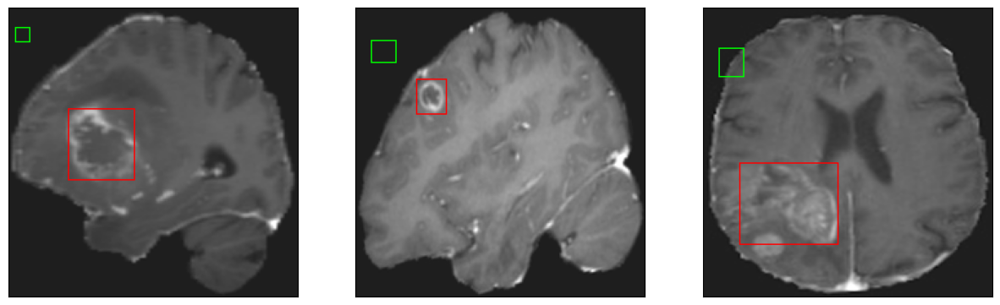

26/26 [==============================] - 20s 263ms/step - loss: 31.4525 - IoU: 0.0706 - val_loss: 54.6544 - val_IoU: 0.0000e+00
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 20.6569 - IoU: 0.1422
Epoch 2: val_loss improved from 54.65438 to 37.69361, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 8ms/step
4


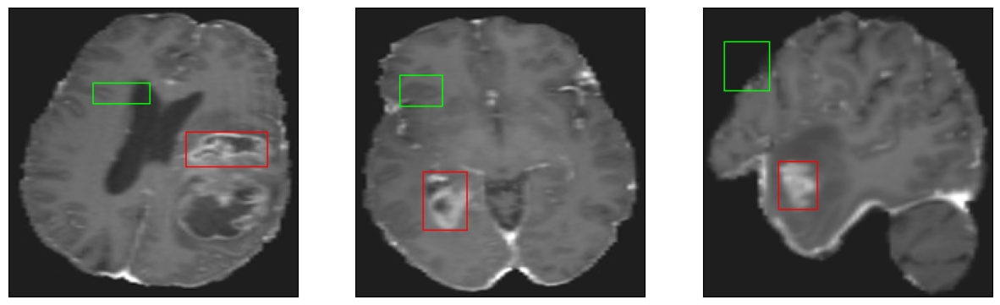

26/26 [==============================] - 2s 84ms/step - loss: 20.6569 - IoU: 0.1422 - val_loss: 37.6936 - val_IoU: 0.0158
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 17.3965 - IoU: 0.2104
Epoch 3: val_loss did not improve from 37.69361
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


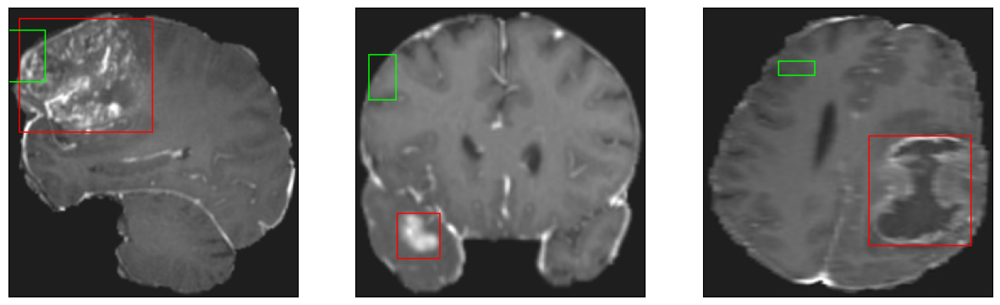

26/26 [==============================] - 2s 83ms/step - loss: 17.3965 - IoU: 0.2104 - val_loss: 42.7487 - val_IoU: 0.0063
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 15.1383 - IoU: 0.2595
Epoch 4: val_loss improved from 37.69361 to 37.33152, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


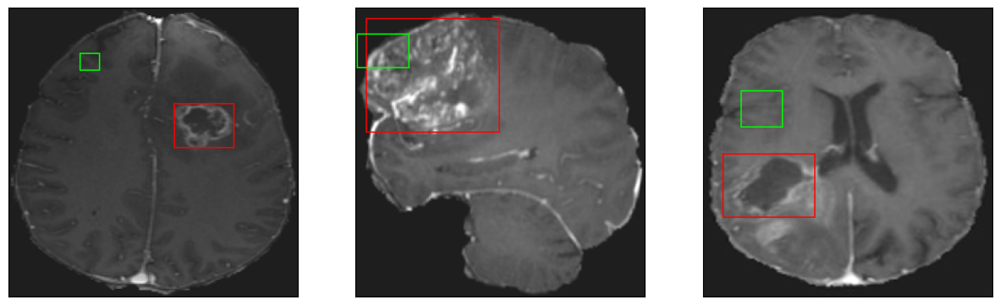

26/26 [==============================] - 3s 108ms/step - loss: 15.1435 - IoU: 0.2601 - val_loss: 37.3315 - val_IoU: 0.0103
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 13.9557 - IoU: 0.2832
Epoch 5: val_loss improved from 37.33152 to 34.38419, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


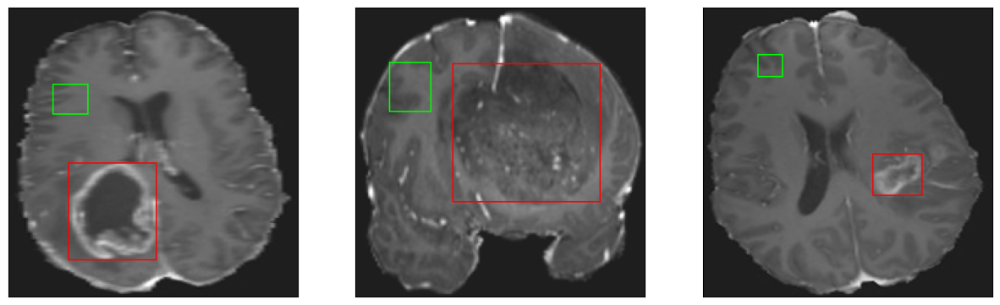

26/26 [==============================] - 2s 89ms/step - loss: 13.9557 - IoU: 0.2832 - val_loss: 34.3842 - val_IoU: 0.0191
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 12.2467 - IoU: 0.3269
Epoch 6: val_loss did not improve from 34.38419
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


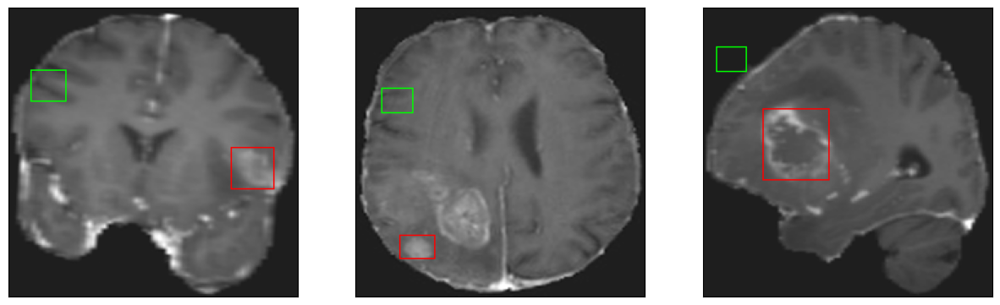

26/26 [==============================] - 2s 79ms/step - loss: 12.2467 - IoU: 0.3269 - val_loss: 41.8143 - val_IoU: 0.0030
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 11.4300 - IoU: 0.3441
Epoch 7: val_loss did not improve from 34.38419
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


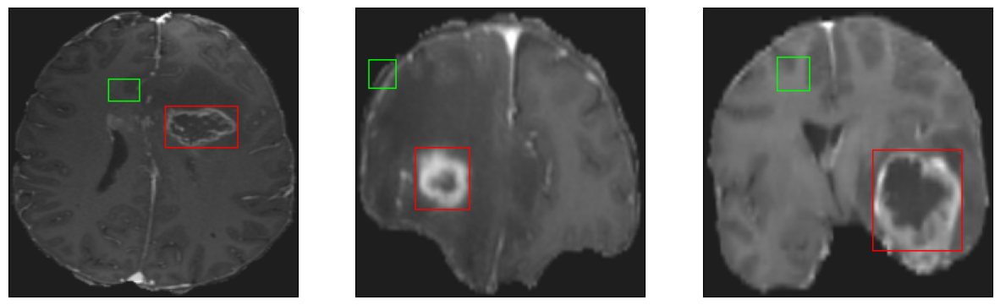

26/26 [==============================] - 2s 75ms/step - loss: 11.4300 - IoU: 0.3441 - val_loss: 36.8175 - val_IoU: 0.0066
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 11.0077 - IoU: 0.3562
Epoch 8: val_loss improved from 34.38419 to 33.92849, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


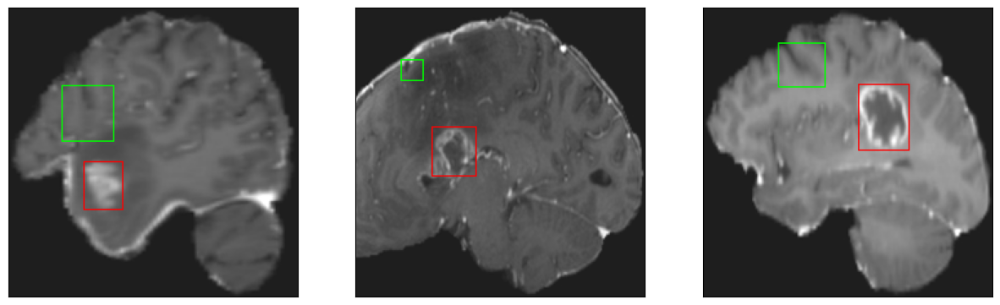

26/26 [==============================] - 3s 118ms/step - loss: 11.0502 - IoU: 0.3564 - val_loss: 33.9285 - val_IoU: 0.0190
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 10.2458 - IoU: 0.3841
Epoch 9: val_loss improved from 33.92849 to 27.60571, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


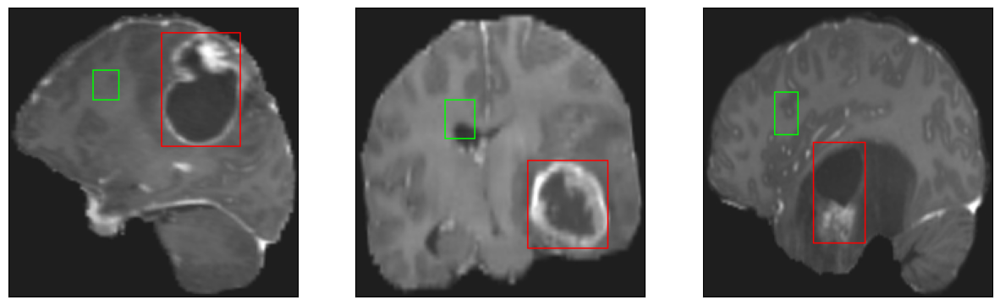

26/26 [==============================] - 2s 94ms/step - loss: 10.2458 - IoU: 0.3841 - val_loss: 27.6057 - val_IoU: 0.0499
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 9.6032 - IoU: 0.3973
Epoch 10: val_loss improved from 27.60571 to 26.64664, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


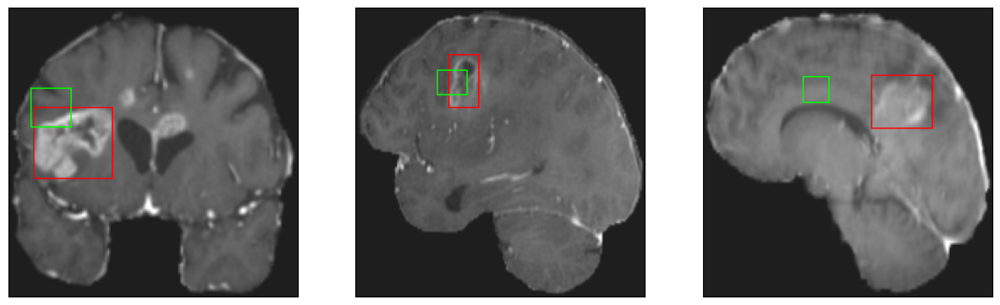

26/26 [==============================] - 2s 94ms/step - loss: 9.6032 - IoU: 0.3973 - val_loss: 26.6466 - val_IoU: 0.0670
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.2871 - IoU: 0.4091
Epoch 11: val_loss improved from 26.64664 to 21.45332, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


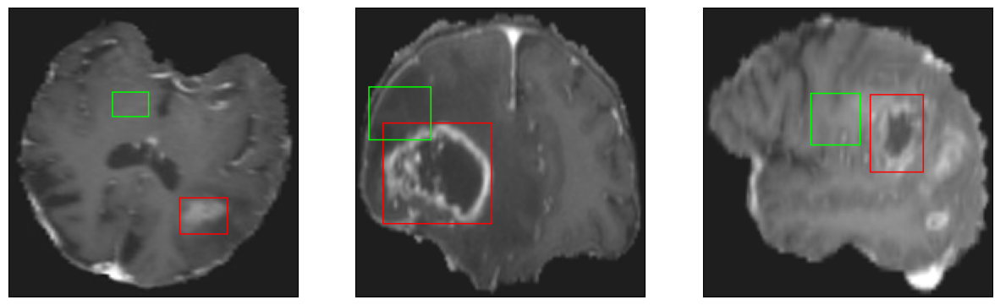

26/26 [==============================] - 2s 93ms/step - loss: 9.2568 - IoU: 0.4087 - val_loss: 21.4533 - val_IoU: 0.1206
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 8.9017 - IoU: 0.4200
Epoch 12: val_loss improved from 21.45332 to 16.73111, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


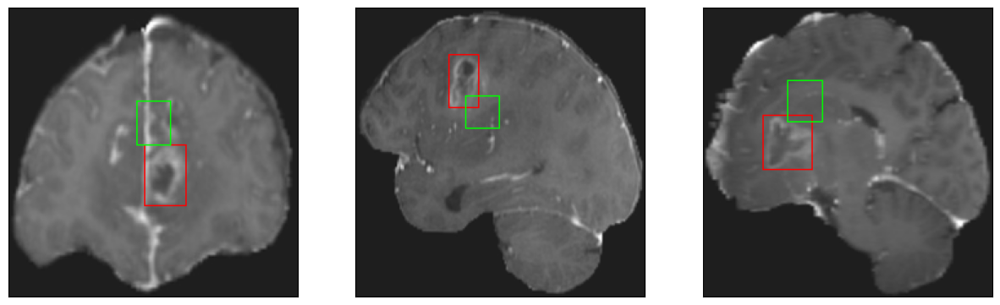

26/26 [==============================] - 3s 116ms/step - loss: 8.9055 - IoU: 0.4209 - val_loss: 16.7311 - val_IoU: 0.2113
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 8.3809 - IoU: 0.4412
Epoch 13: val_loss did not improve from 16.73111
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


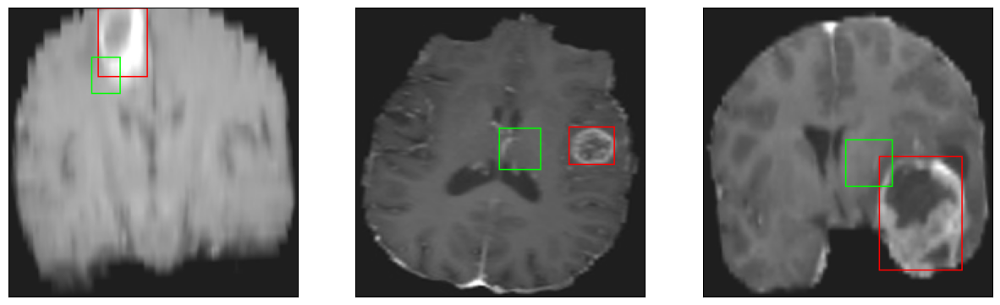

26/26 [==============================] - 3s 106ms/step - loss: 8.3621 - IoU: 0.4439 - val_loss: 17.4433 - val_IoU: 0.1903
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 7.9355 - IoU: 0.4634
Epoch 14: val_loss did not improve from 16.73111
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


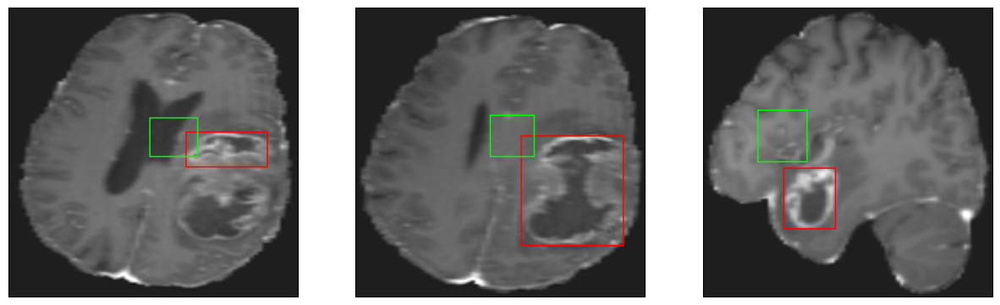

26/26 [==============================] - 3s 98ms/step - loss: 7.9355 - IoU: 0.4634 - val_loss: 20.1458 - val_IoU: 0.1491
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 7.8883 - IoU: 0.4537
Epoch 15: val_loss improved from 16.73111 to 14.58642, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


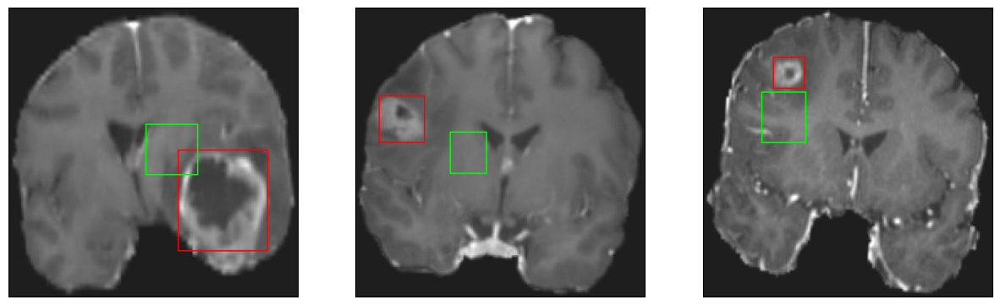

26/26 [==============================] - 3s 104ms/step - loss: 7.8963 - IoU: 0.4537 - val_loss: 14.5864 - val_IoU: 0.2741
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6025 - IoU: 0.4696
Epoch 16: val_loss did not improve from 14.58642
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


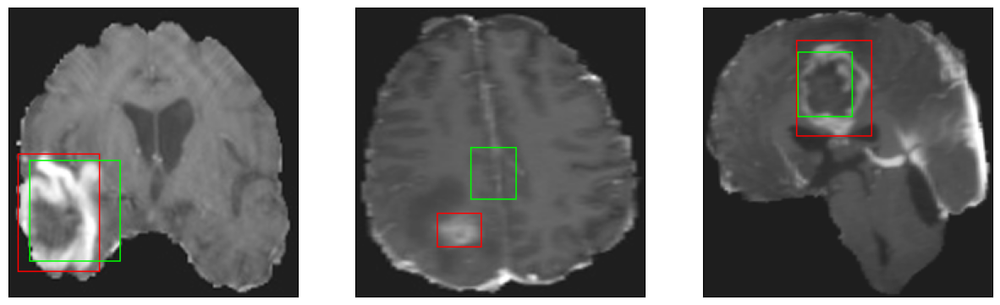

26/26 [==============================] - 2s 90ms/step - loss: 7.5992 - IoU: 0.4712 - val_loss: 15.1519 - val_IoU: 0.2755
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 7.4696 - IoU: 0.4740
Epoch 17: val_loss improved from 14.58642 to 13.26331, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


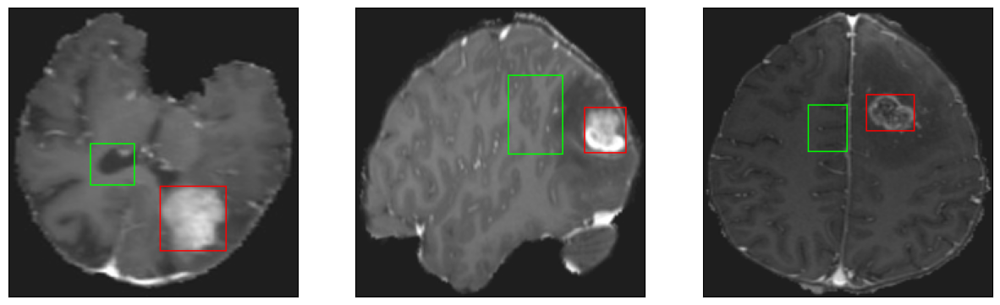

26/26 [==============================] - 3s 132ms/step - loss: 7.4696 - IoU: 0.4740 - val_loss: 13.2633 - val_IoU: 0.3197
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4936 - IoU: 0.4737
Epoch 18: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


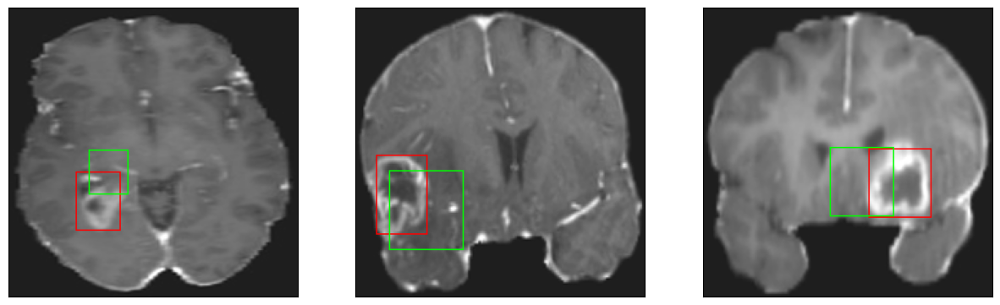

26/26 [==============================] - 2s 84ms/step - loss: 7.5379 - IoU: 0.4727 - val_loss: 13.5309 - val_IoU: 0.3083
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1998 - IoU: 0.4820
Epoch 19: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


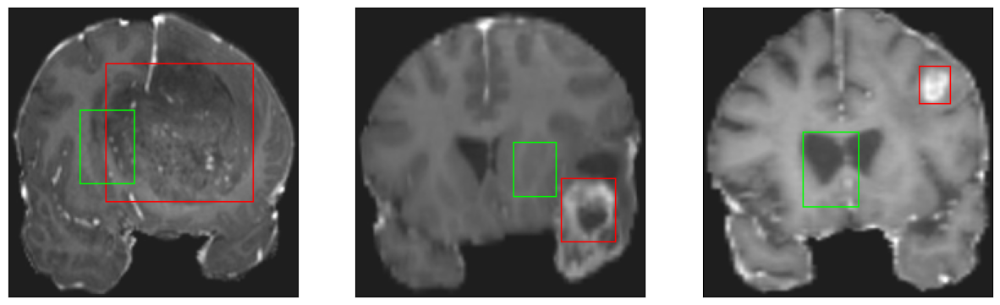

26/26 [==============================] - 2s 90ms/step - loss: 7.2003 - IoU: 0.4802 - val_loss: 14.7636 - val_IoU: 0.2880
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 6.9534 - IoU: 0.4979
Epoch 20: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


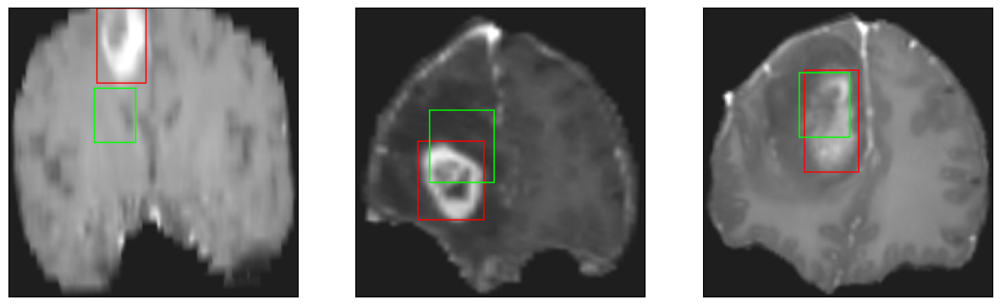

26/26 [==============================] - 3s 134ms/step - loss: 6.9534 - IoU: 0.4979 - val_loss: 13.3912 - val_IoU: 0.3138
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9680 - IoU: 0.4873
Epoch 21: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


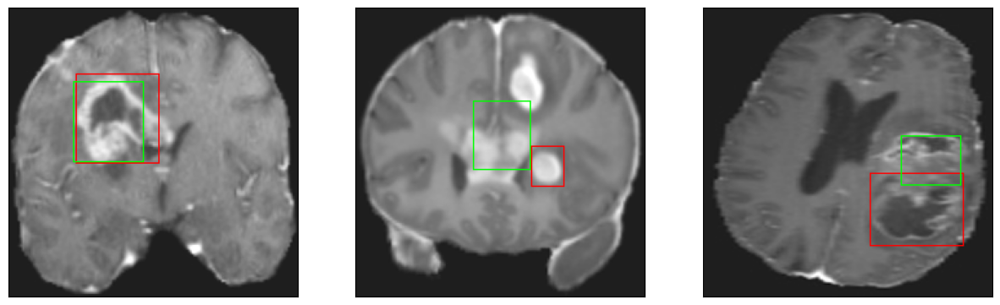

26/26 [==============================] - 3s 116ms/step - loss: 6.9392 - IoU: 0.4896 - val_loss: 13.3985 - val_IoU: 0.3164
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 6.7115 - IoU: 0.5011
Epoch 22: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


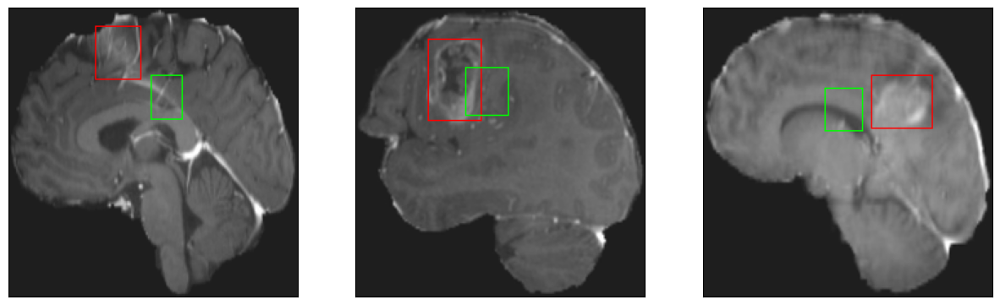

26/26 [==============================] - 3s 101ms/step - loss: 6.7115 - IoU: 0.5011 - val_loss: 13.5400 - val_IoU: 0.3199
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 6.6001 - IoU: 0.5103
Epoch 23: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 8ms/step
4


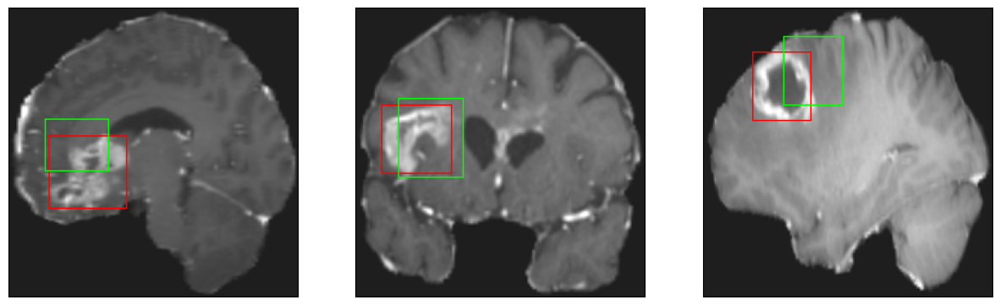

26/26 [==============================] - 2s 88ms/step - loss: 6.6001 - IoU: 0.5103 - val_loss: 13.3174 - val_IoU: 0.3087
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 6.7984 - IoU: 0.4975
Epoch 24: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


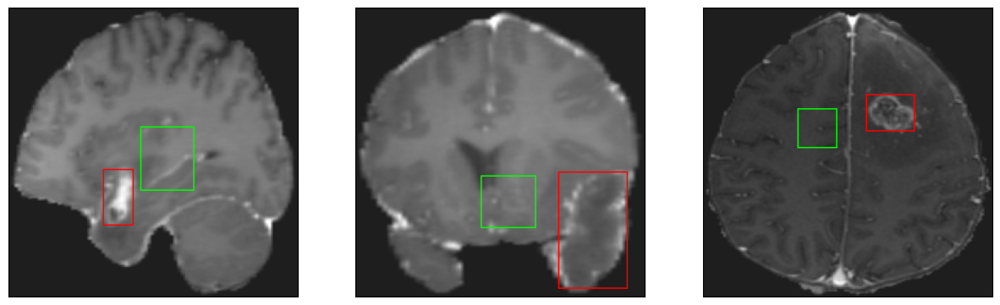

26/26 [==============================] - 2s 91ms/step - loss: 6.7984 - IoU: 0.4975 - val_loss: 13.7318 - val_IoU: 0.3275
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 6.5710 - IoU: 0.5130
Epoch 25: val_loss did not improve from 13.26331
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


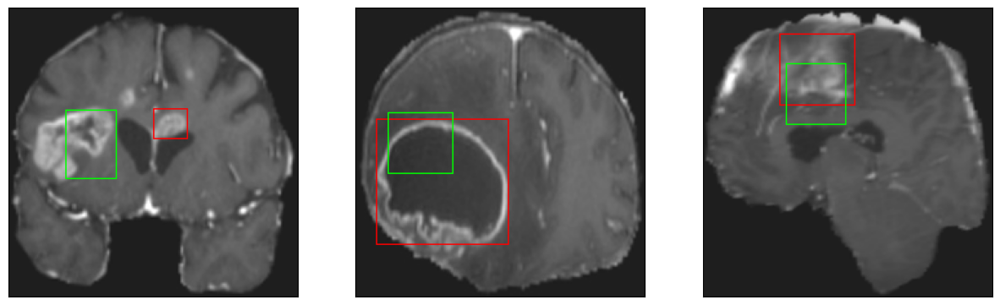

26/26 [==============================] - 2s 85ms/step - loss: 6.5710 - IoU: 0.5130 - val_loss: 14.2571 - val_IoU: 0.2842
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4323 - IoU: 0.5198
Epoch 26: val_loss improved from 13.26331 to 13.25558, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 13ms/step
4


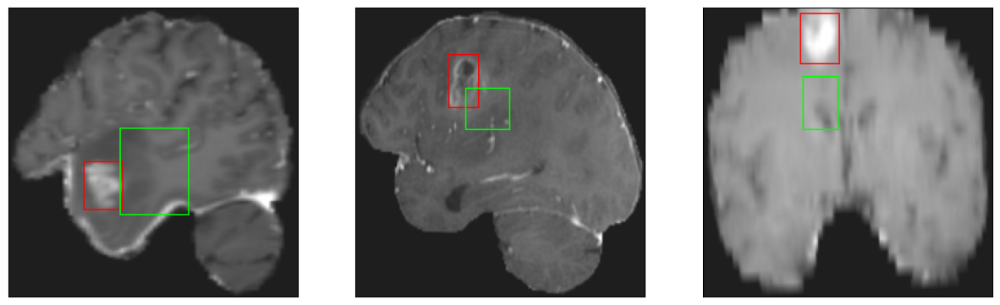

26/26 [==============================] - 4s 155ms/step - loss: 6.3974 - IoU: 0.5198 - val_loss: 13.2556 - val_IoU: 0.3096
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6035 - IoU: 0.5068
Epoch 27: val_loss did not improve from 13.25558
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


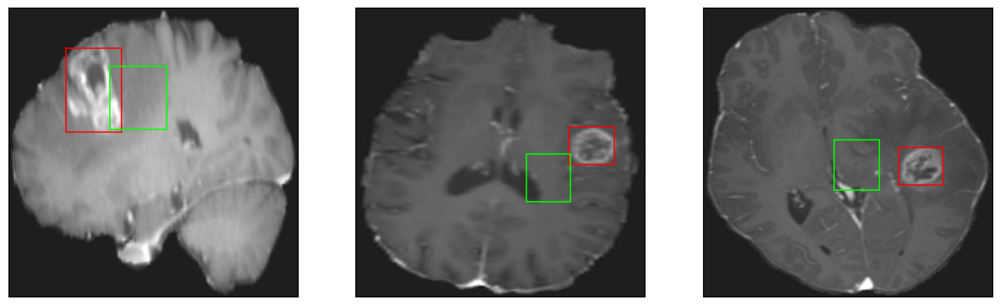

26/26 [==============================] - 2s 85ms/step - loss: 6.5734 - IoU: 0.5087 - val_loss: 14.0287 - val_IoU: 0.2963
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.3309 - IoU: 0.5189
Epoch 28: val_loss did not improve from 13.25558
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 5ms/step
4


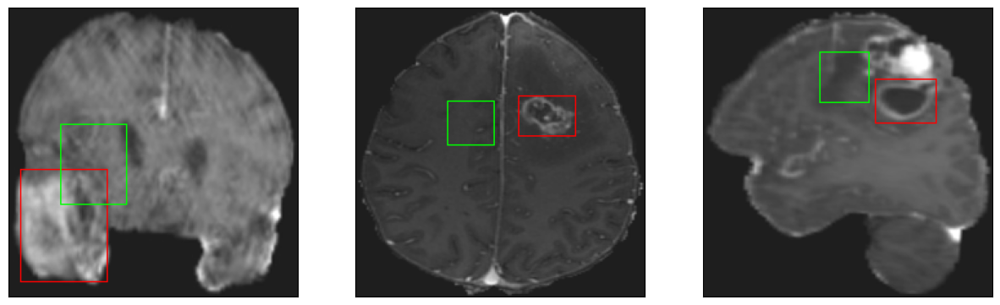

26/26 [==============================] - 2s 91ms/step - loss: 6.3309 - IoU: 0.5189 - val_loss: 13.4009 - val_IoU: 0.3379
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0647 - IoU: 0.5298
Epoch 29: val_loss did not improve from 13.25558
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


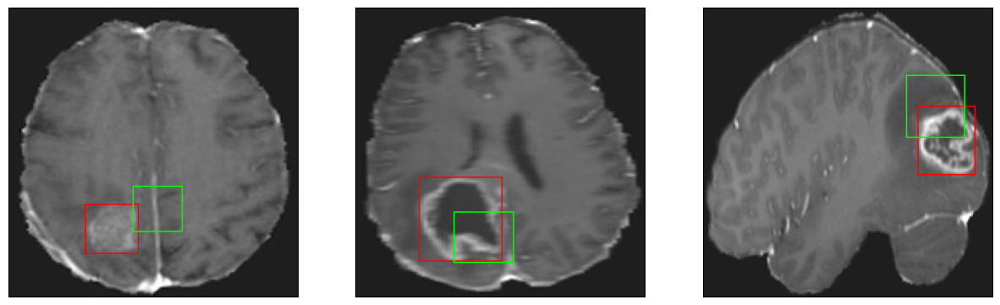

26/26 [==============================] - 3s 100ms/step - loss: 6.0650 - IoU: 0.5310 - val_loss: 13.3175 - val_IoU: 0.3252
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0620 - IoU: 0.5382
Epoch 30: val_loss did not improve from 13.25558
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


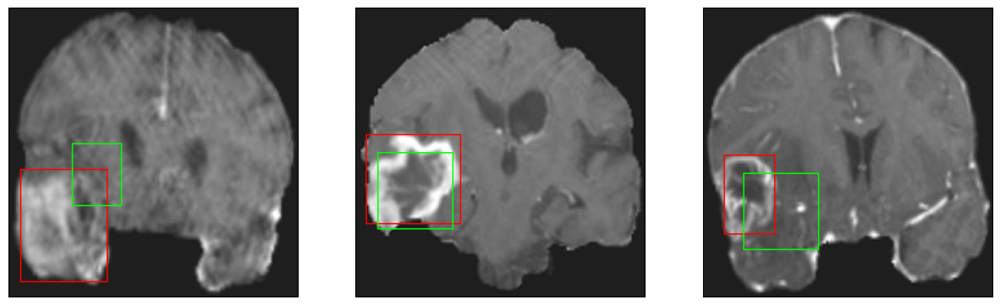

26/26 [==============================] - 2s 86ms/step - loss: 6.0543 - IoU: 0.5384 - val_loss: 13.3024 - val_IoU: 0.3227
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9236 - IoU: 0.5435
Epoch 31: val_loss improved from 13.25558 to 12.94807, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


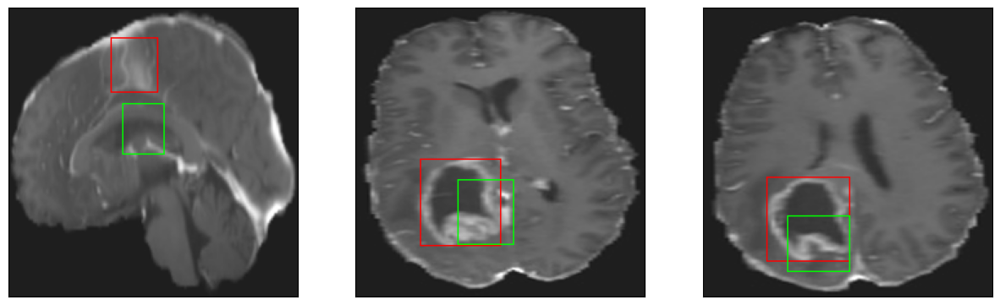

26/26 [==============================] - 4s 159ms/step - loss: 5.9395 - IoU: 0.5411 - val_loss: 12.9481 - val_IoU: 0.3397
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 5.8574 - IoU: 0.5424
Epoch 32: val_loss improved from 12.94807 to 12.69362, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


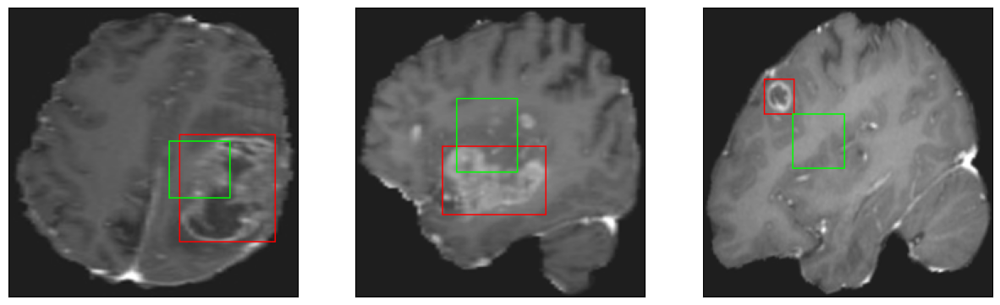

26/26 [==============================] - 3s 106ms/step - loss: 5.8574 - IoU: 0.5424 - val_loss: 12.6936 - val_IoU: 0.3455
Epoch 33/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7422 - IoU: 0.5467
Epoch 33: val_loss did not improve from 12.69362
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


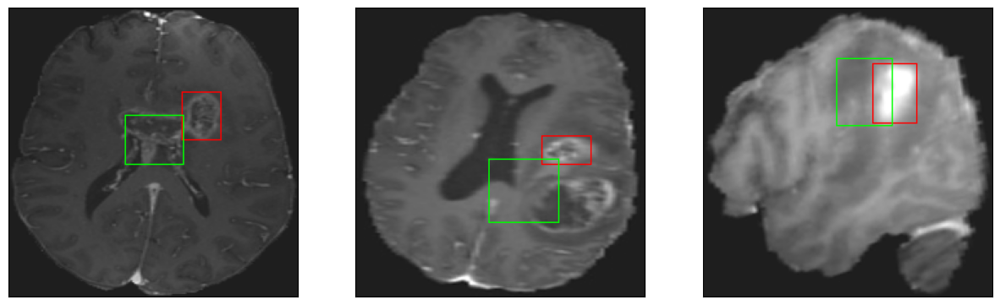

26/26 [==============================] - 3s 99ms/step - loss: 5.7796 - IoU: 0.5461 - val_loss: 13.0705 - val_IoU: 0.3321
Epoch 34/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8522 - IoU: 0.5409
Epoch 34: val_loss did not improve from 12.69362
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


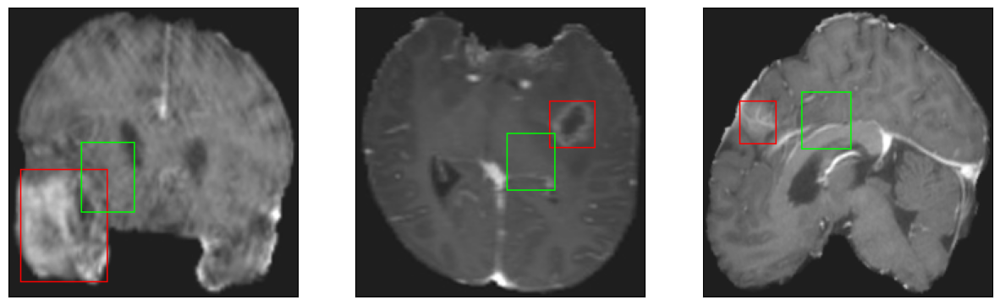

26/26 [==============================] - 3s 96ms/step - loss: 5.8202 - IoU: 0.5426 - val_loss: 12.8717 - val_IoU: 0.3421
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 5.7674 - IoU: 0.5382
Epoch 35: val_loss did not improve from 12.69362
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


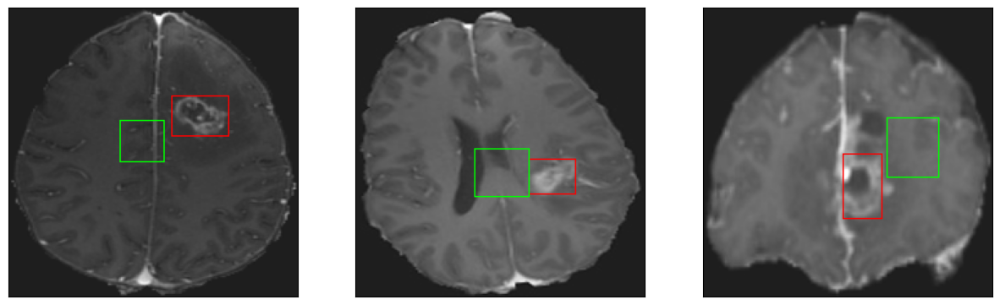

26/26 [==============================] - 3s 116ms/step - loss: 5.7674 - IoU: 0.5382 - val_loss: 12.7840 - val_IoU: 0.3260
Epoch 36/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7175 - IoU: 0.5454
Epoch 36: val_loss did not improve from 12.69362
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


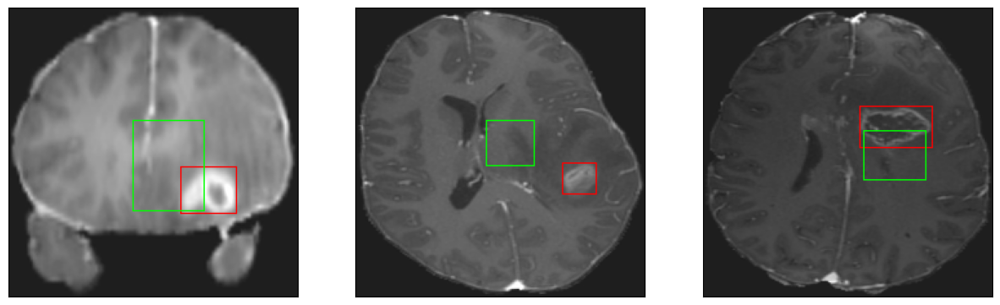

26/26 [==============================] - 2s 92ms/step - loss: 5.7042 - IoU: 0.5480 - val_loss: 13.4444 - val_IoU: 0.3295
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 5.8563 - IoU: 0.5404
Epoch 37: val_loss did not improve from 12.69362
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


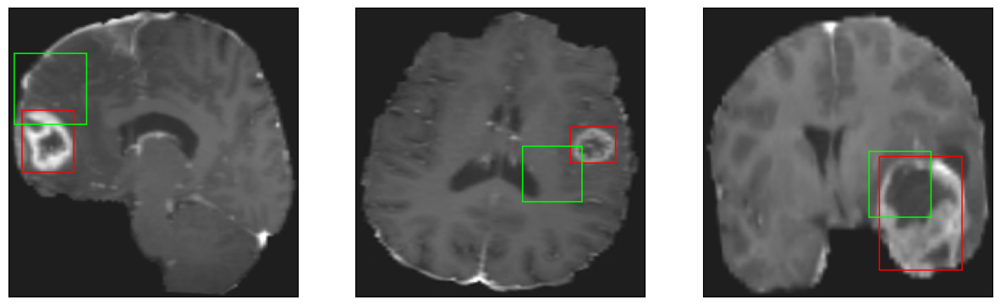

26/26 [==============================] - 2s 93ms/step - loss: 5.8563 - IoU: 0.5404 - val_loss: 12.7561 - val_IoU: 0.3521
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 5.8957 - IoU: 0.5430
Epoch 38: val_loss did not improve from 12.69362
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


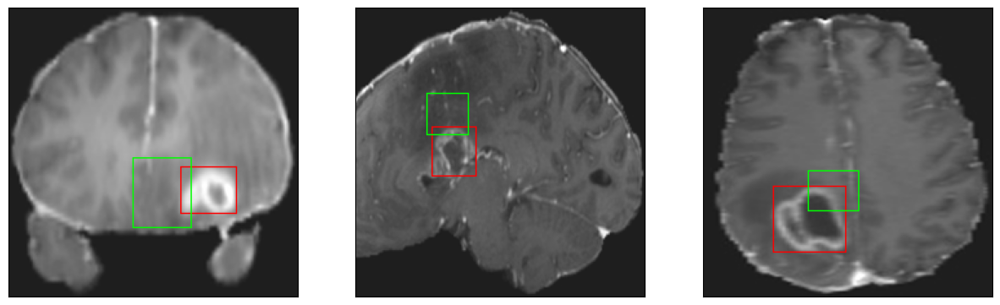

26/26 [==============================] - 3s 106ms/step - loss: 5.8957 - IoU: 0.5430 - val_loss: 12.8565 - val_IoU: 0.3146
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4641 - IoU: 0.5732
Epoch 39: val_loss improved from 12.69362 to 12.10668, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


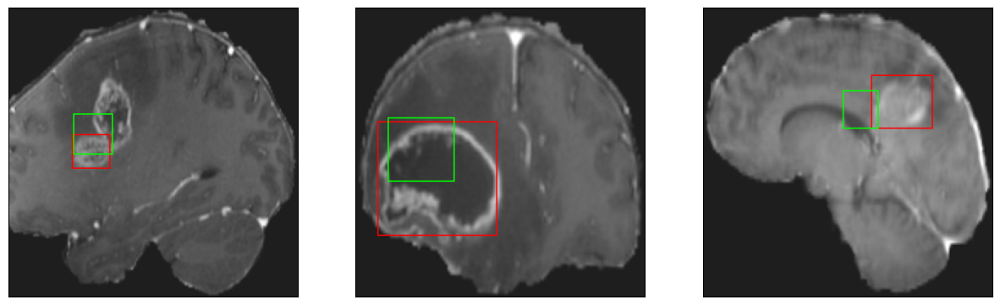

26/26 [==============================] - 4s 170ms/step - loss: 5.4749 - IoU: 0.5719 - val_loss: 12.1067 - val_IoU: 0.3515
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 5.5671 - IoU: 0.5615
Epoch 40: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


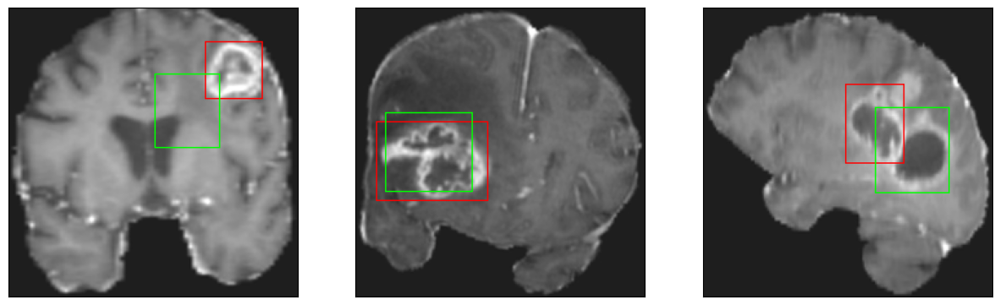

26/26 [==============================] - 3s 119ms/step - loss: 5.5671 - IoU: 0.5615 - val_loss: 12.6232 - val_IoU: 0.3664
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6018 - IoU: 0.5610
Epoch 41: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


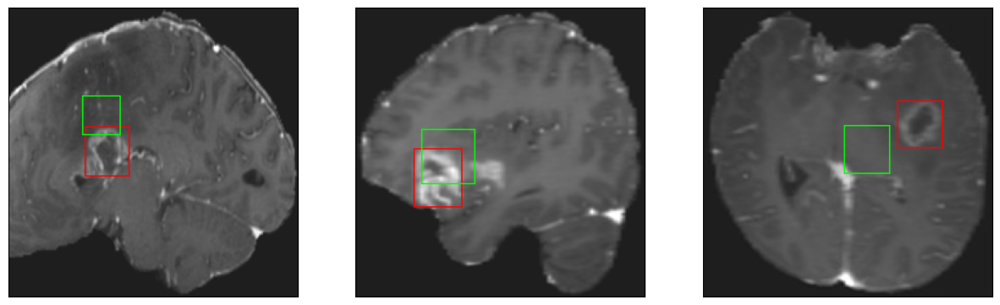

26/26 [==============================] - 2s 91ms/step - loss: 5.5953 - IoU: 0.5622 - val_loss: 12.3035 - val_IoU: 0.3526
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.4784 - IoU: 0.5650
Epoch 42: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


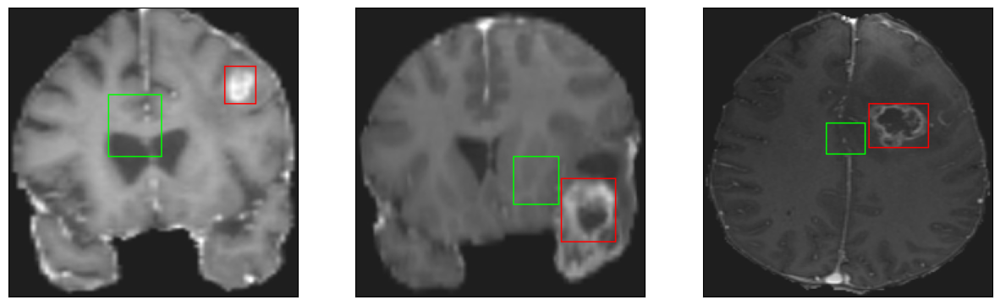

26/26 [==============================] - 3s 127ms/step - loss: 5.4784 - IoU: 0.5650 - val_loss: 13.2591 - val_IoU: 0.3037
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3003 - IoU: 0.5758
Epoch 43: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


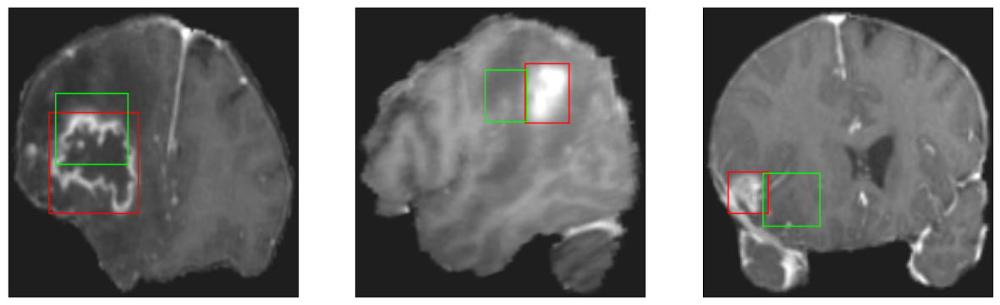

26/26 [==============================] - 2s 90ms/step - loss: 5.3436 - IoU: 0.5725 - val_loss: 12.9544 - val_IoU: 0.3205
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2799 - IoU: 0.5670
Epoch 44: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


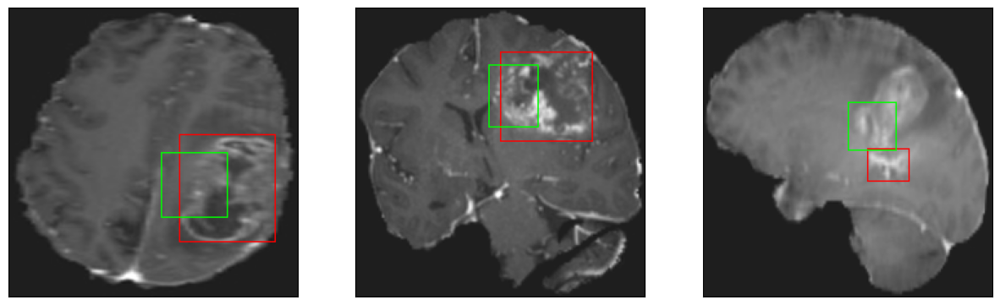

26/26 [==============================] - 3s 111ms/step - loss: 5.2742 - IoU: 0.5674 - val_loss: 12.4737 - val_IoU: 0.3497
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7157 - IoU: 0.5477
Epoch 45: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


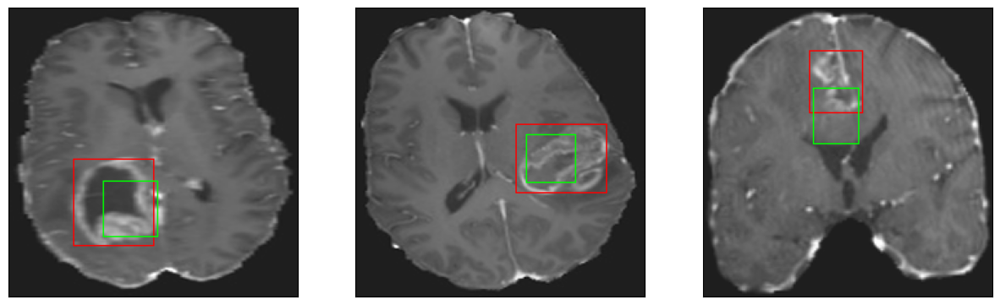

26/26 [==============================] - 3s 110ms/step - loss: 5.7571 - IoU: 0.5458 - val_loss: 12.1989 - val_IoU: 0.3537
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5348 - IoU: 0.5558
Epoch 46: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


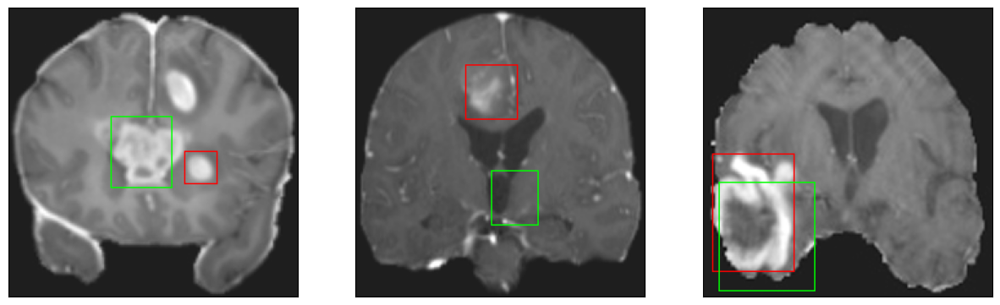

26/26 [==============================] - 3s 104ms/step - loss: 5.4996 - IoU: 0.5578 - val_loss: 12.3202 - val_IoU: 0.3556
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4036 - IoU: 0.5647
Epoch 47: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


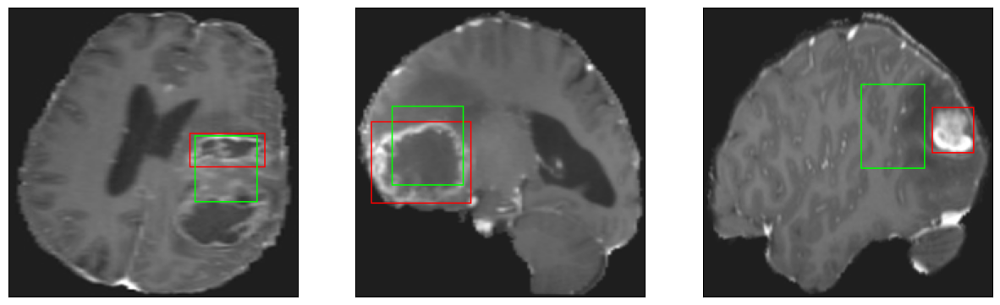

26/26 [==============================] - 5s 181ms/step - loss: 5.3851 - IoU: 0.5672 - val_loss: 13.9027 - val_IoU: 0.3297
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.3484 - IoU: 0.5709
Epoch 48: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


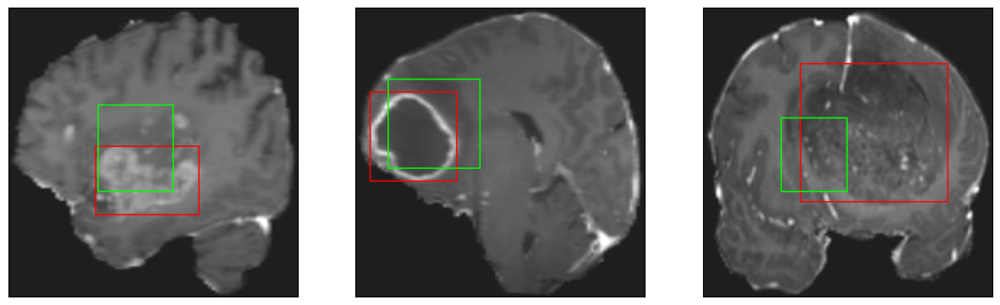

26/26 [==============================] - 3s 119ms/step - loss: 5.3484 - IoU: 0.5709 - val_loss: 14.3986 - val_IoU: 0.3050
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2511 - IoU: 0.5756
Epoch 49: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


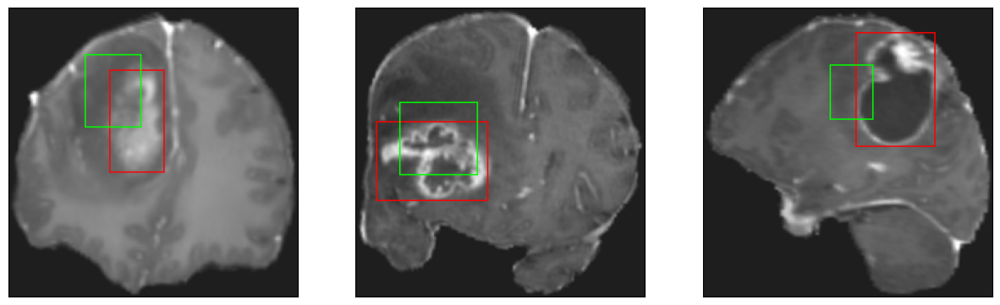

26/26 [==============================] - 3s 104ms/step - loss: 5.2131 - IoU: 0.5770 - val_loss: 12.6292 - val_IoU: 0.3418
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 5.4624 - IoU: 0.5519
Epoch 50: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


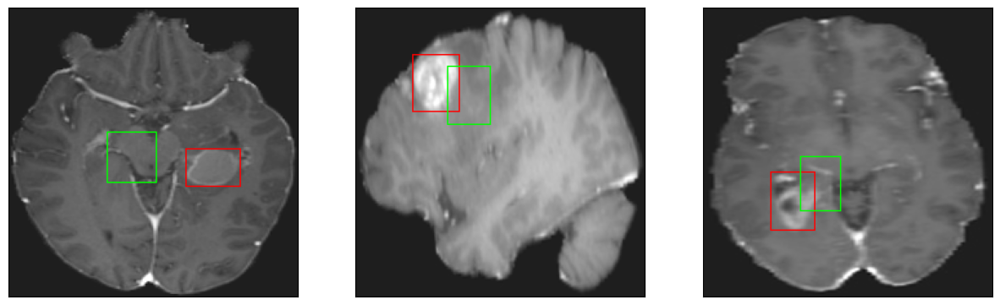

26/26 [==============================] - 3s 98ms/step - loss: 5.4624 - IoU: 0.5519 - val_loss: 12.7949 - val_IoU: 0.3305
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0559 - IoU: 0.5948
Epoch 51: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


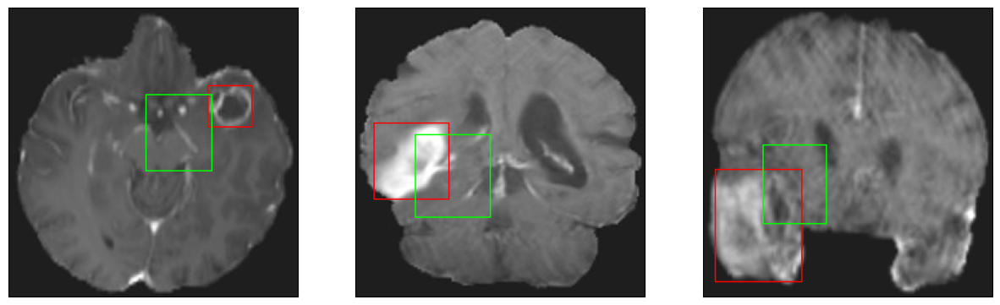

26/26 [==============================] - 3s 105ms/step - loss: 5.0725 - IoU: 0.5940 - val_loss: 13.0887 - val_IoU: 0.3376
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3777 - IoU: 0.5780
Epoch 52: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


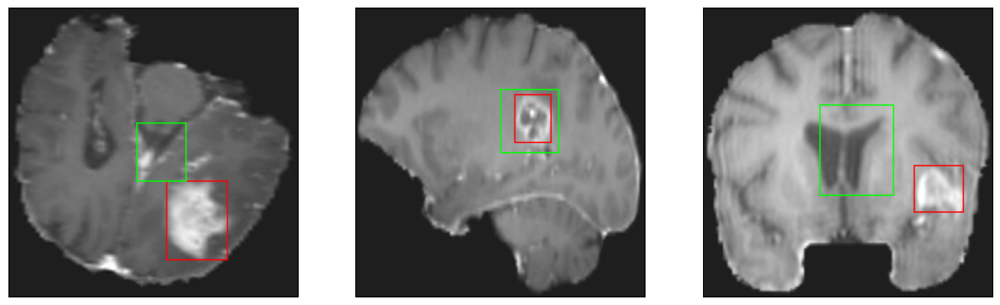

26/26 [==============================] - 3s 119ms/step - loss: 5.4038 - IoU: 0.5756 - val_loss: 12.5916 - val_IoU: 0.3533
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2845 - IoU: 0.5807
Epoch 53: val_loss did not improve from 12.10668
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


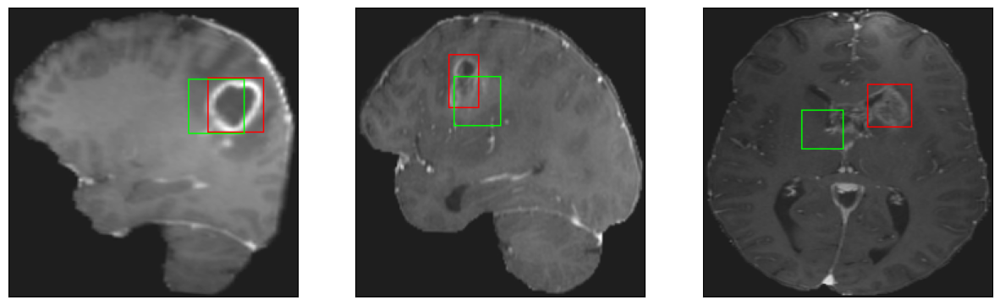

26/26 [==============================] - 3s 101ms/step - loss: 5.2545 - IoU: 0.5826 - val_loss: 13.4659 - val_IoU: 0.3113
Epoch 54/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1777 - IoU: 0.5763
Epoch 54: val_loss improved from 12.10668 to 12.08038, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


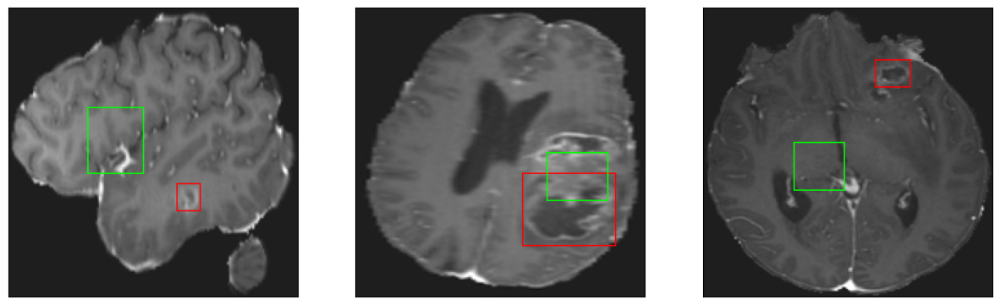

26/26 [==============================] - 4s 161ms/step - loss: 5.1656 - IoU: 0.5773 - val_loss: 12.0804 - val_IoU: 0.3635
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1928 - IoU: 0.5811
Epoch 55: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


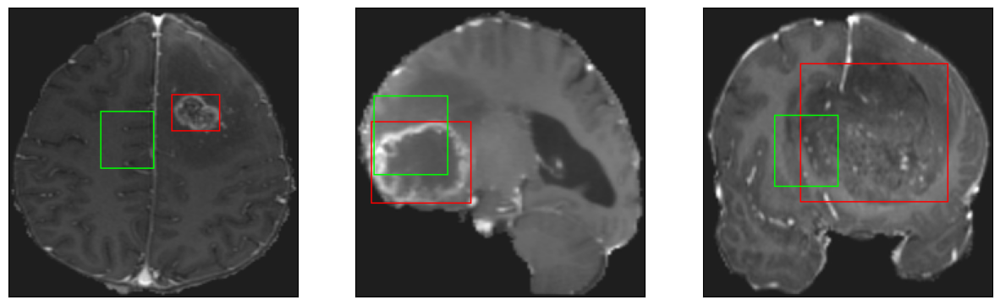

26/26 [==============================] - 3s 123ms/step - loss: 5.2376 - IoU: 0.5798 - val_loss: 12.9844 - val_IoU: 0.3503
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 5.0537 - IoU: 0.5880
Epoch 56: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


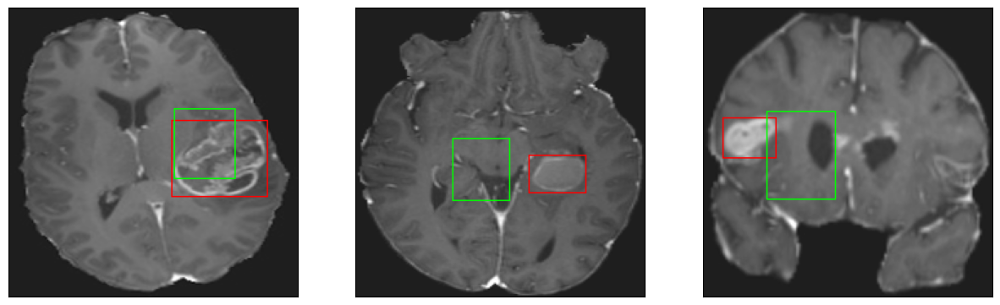

26/26 [==============================] - 2s 93ms/step - loss: 5.0537 - IoU: 0.5880 - val_loss: 13.4629 - val_IoU: 0.3224
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0550 - IoU: 0.5961
Epoch 57: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


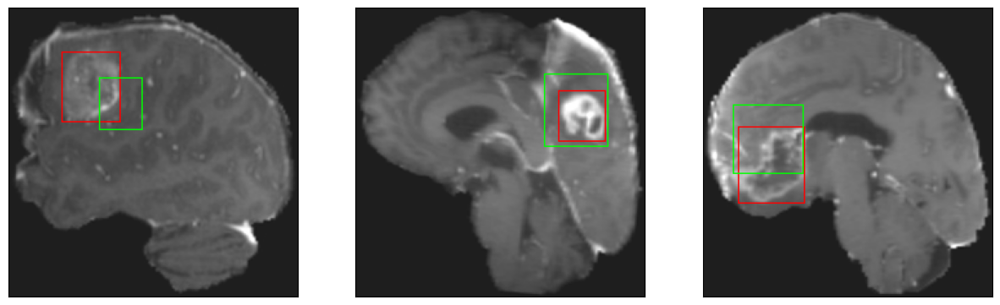

26/26 [==============================] - 3s 100ms/step - loss: 5.0173 - IoU: 0.5969 - val_loss: 12.7818 - val_IoU: 0.3230
Epoch 58/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9779 - IoU: 0.5923
Epoch 58: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


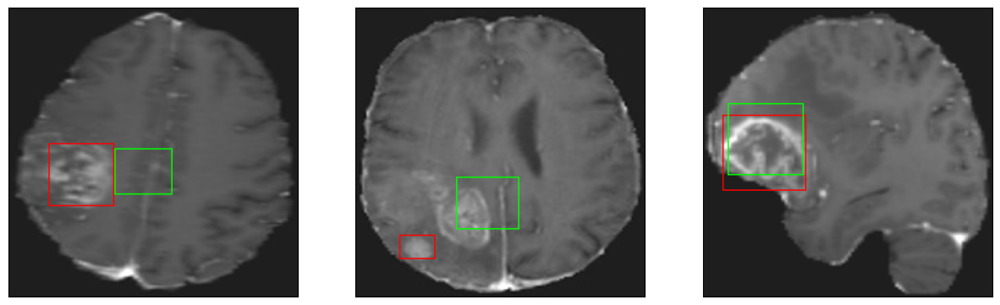

26/26 [==============================] - 3s 97ms/step - loss: 4.9657 - IoU: 0.5932 - val_loss: 12.9893 - val_IoU: 0.3283
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8468 - IoU: 0.6055
Epoch 59: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


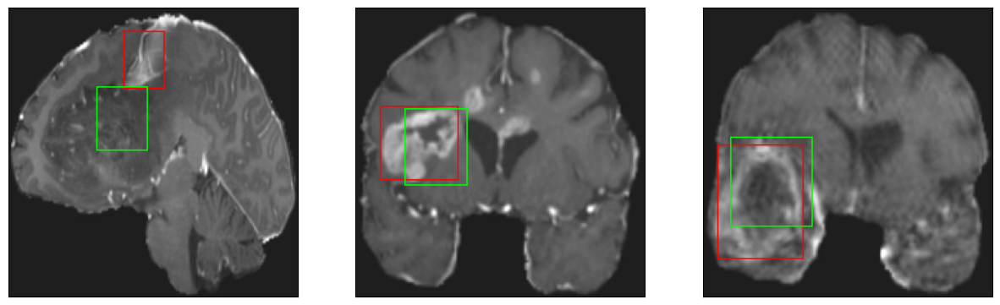

26/26 [==============================] - 2s 87ms/step - loss: 4.8988 - IoU: 0.6045 - val_loss: 13.2433 - val_IoU: 0.3357
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9003 - IoU: 0.5922
Epoch 60: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


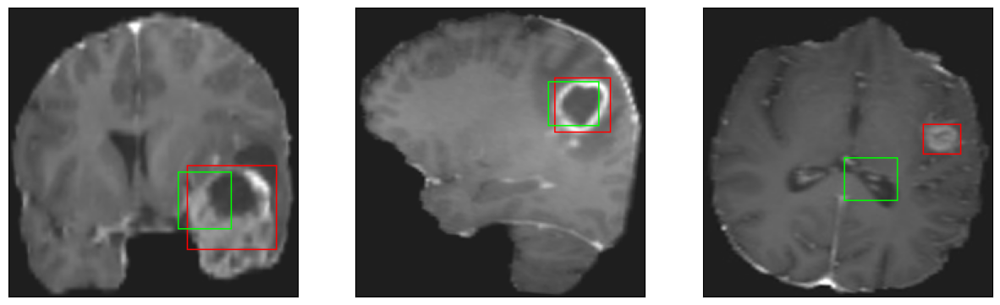

26/26 [==============================] - 3s 112ms/step - loss: 4.8933 - IoU: 0.5927 - val_loss: 12.4657 - val_IoU: 0.3384
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0310 - IoU: 0.5910
Epoch 61: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


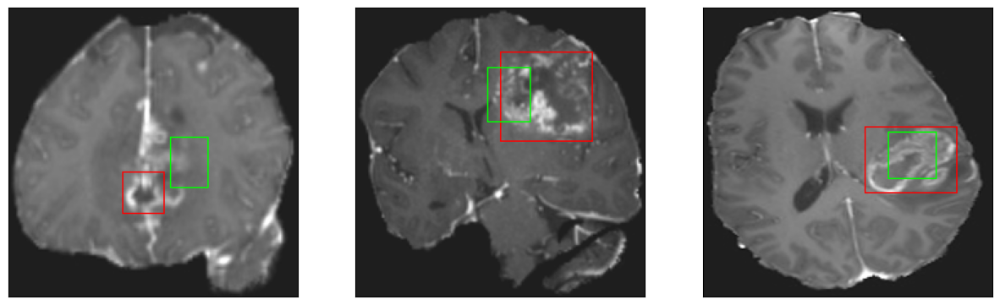

26/26 [==============================] - 2s 96ms/step - loss: 5.0905 - IoU: 0.5880 - val_loss: 12.8883 - val_IoU: 0.3310
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 4.9516 - IoU: 0.5862
Epoch 62: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


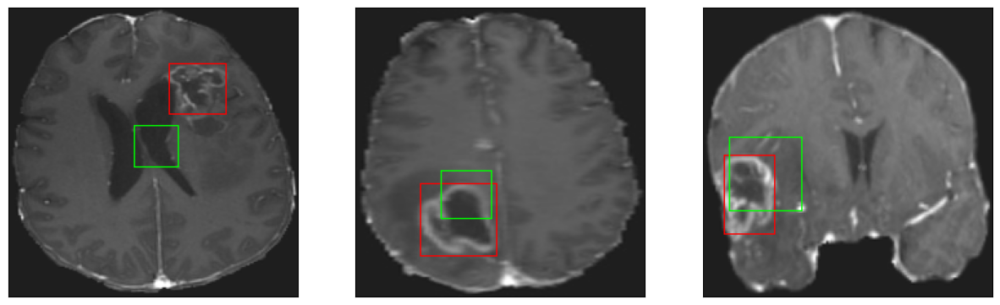

26/26 [==============================] - 3s 117ms/step - loss: 4.9516 - IoU: 0.5862 - val_loss: 13.6147 - val_IoU: 0.2997
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 4.7984 - IoU: 0.6020
Epoch 63: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


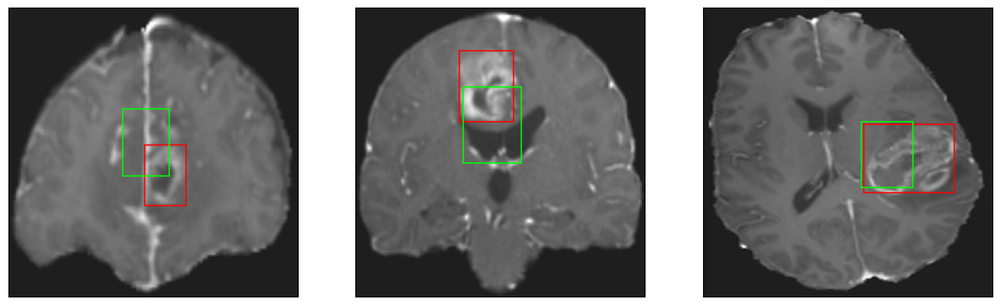

26/26 [==============================] - 3s 97ms/step - loss: 4.7984 - IoU: 0.6020 - val_loss: 12.4059 - val_IoU: 0.3646
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 4.9215 - IoU: 0.6006
Epoch 64: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


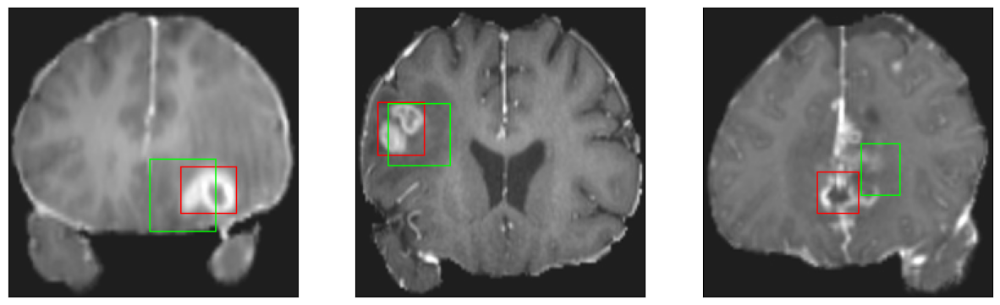

26/26 [==============================] - 3s 116ms/step - loss: 4.9215 - IoU: 0.6006 - val_loss: 12.1363 - val_IoU: 0.3692
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8185 - IoU: 0.6088
Epoch 65: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


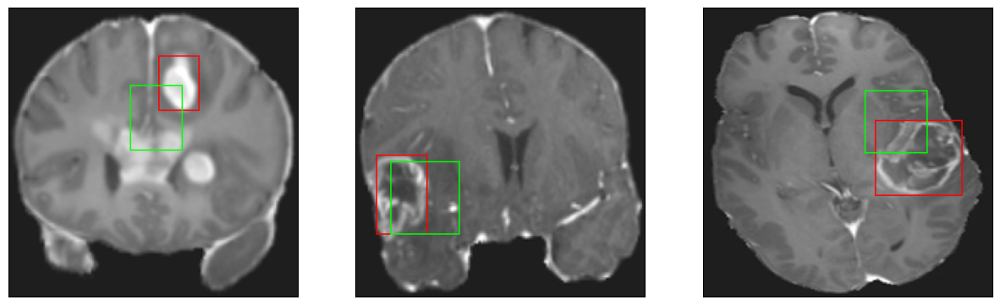

26/26 [==============================] - 3s 97ms/step - loss: 4.8589 - IoU: 0.6059 - val_loss: 12.3396 - val_IoU: 0.3527
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.4051 - IoU: 0.5663
Epoch 66: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


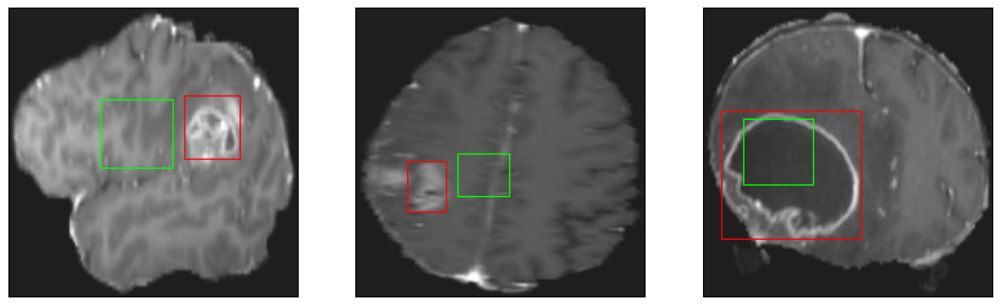

26/26 [==============================] - 2s 90ms/step - loss: 5.4051 - IoU: 0.5663 - val_loss: 12.5309 - val_IoU: 0.3478
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 4.9694 - IoU: 0.5941
Epoch 67: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


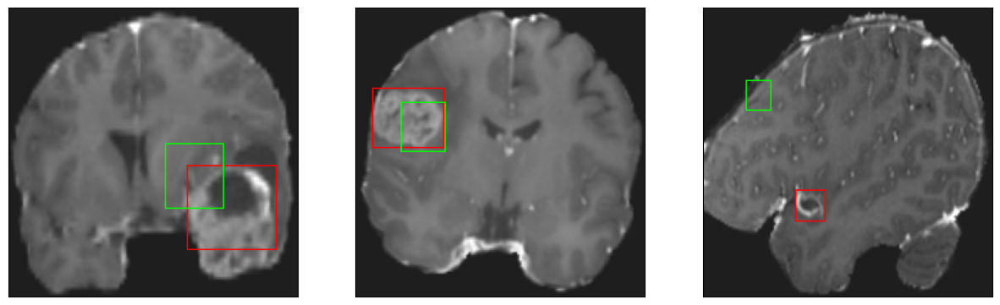

26/26 [==============================] - 3s 98ms/step - loss: 4.9694 - IoU: 0.5941 - val_loss: 13.6734 - val_IoU: 0.3054
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 4.7015 - IoU: 0.6112
Epoch 68: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


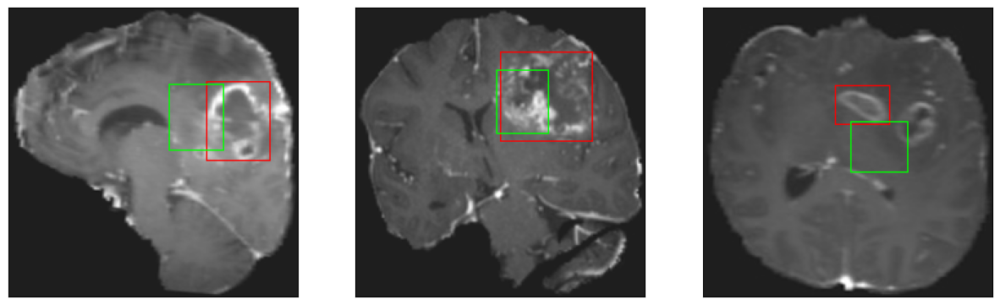

26/26 [==============================] - 2s 94ms/step - loss: 4.7015 - IoU: 0.6112 - val_loss: 12.0813 - val_IoU: 0.3613
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7693 - IoU: 0.6096
Epoch 69: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


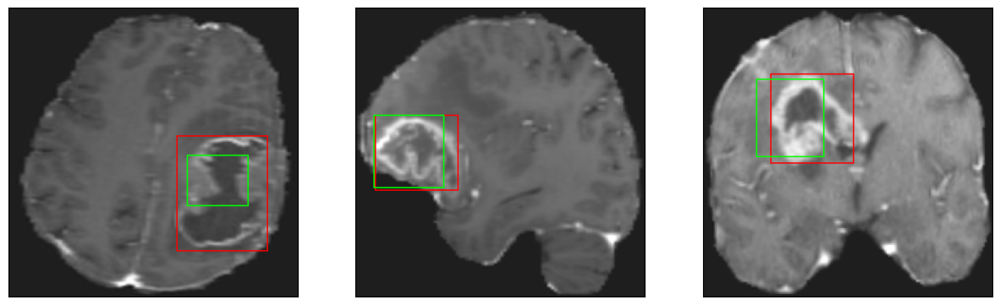

26/26 [==============================] - 3s 112ms/step - loss: 4.7934 - IoU: 0.6079 - val_loss: 12.2740 - val_IoU: 0.3525
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9904 - IoU: 0.6056
Epoch 70: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


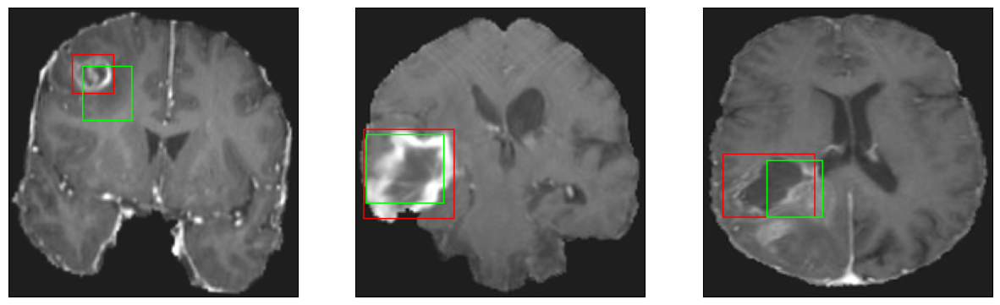

26/26 [==============================] - 3s 100ms/step - loss: 4.9926 - IoU: 0.6044 - val_loss: 12.6597 - val_IoU: 0.3397
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 4.7001 - IoU: 0.6100
Epoch 71: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


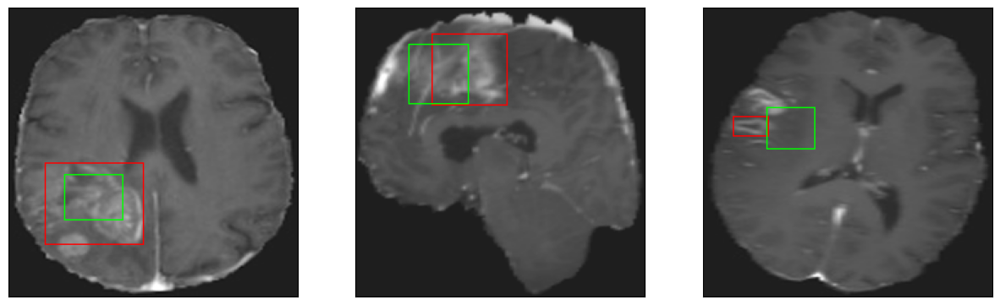

26/26 [==============================] - 2s 93ms/step - loss: 4.7001 - IoU: 0.6100 - val_loss: 16.0118 - val_IoU: 0.2221
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9229 - IoU: 0.5989
Epoch 72: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


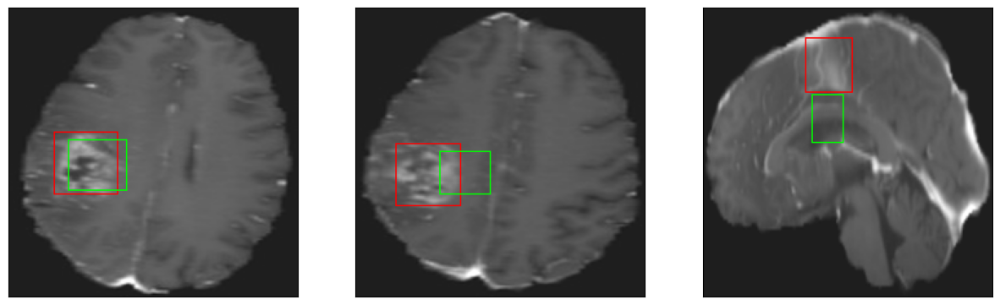

26/26 [==============================] - 2s 94ms/step - loss: 4.9580 - IoU: 0.5961 - val_loss: 12.6038 - val_IoU: 0.3425
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 4.7126 - IoU: 0.6123
Epoch 73: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


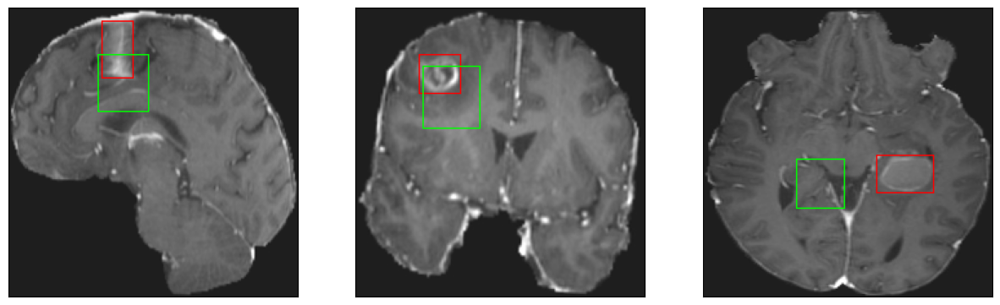

26/26 [==============================] - 3s 100ms/step - loss: 4.7126 - IoU: 0.6123 - val_loss: 12.1029 - val_IoU: 0.3764
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 4.8204 - IoU: 0.6067
Epoch 74: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


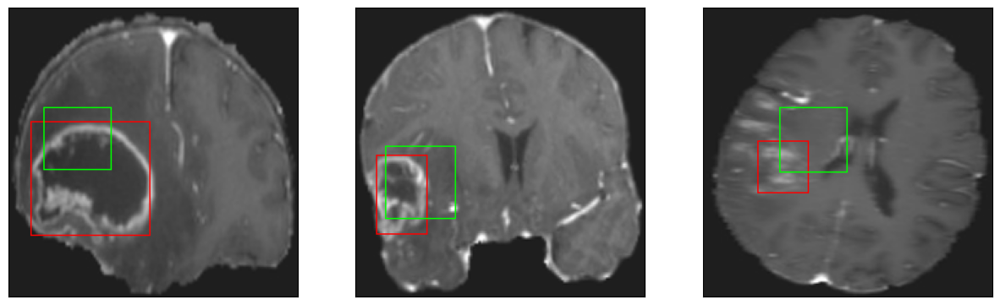

26/26 [==============================] - 3s 104ms/step - loss: 4.8204 - IoU: 0.6067 - val_loss: 12.7560 - val_IoU: 0.3294
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 4.5347 - IoU: 0.6215
Epoch 75: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4


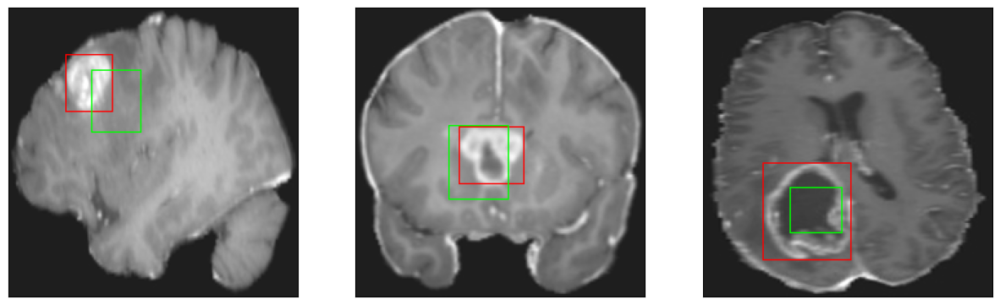

26/26 [==============================] - 3s 97ms/step - loss: 4.5347 - IoU: 0.6215 - val_loss: 12.7715 - val_IoU: 0.3436
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 4.5198 - IoU: 0.6221
Epoch 76: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


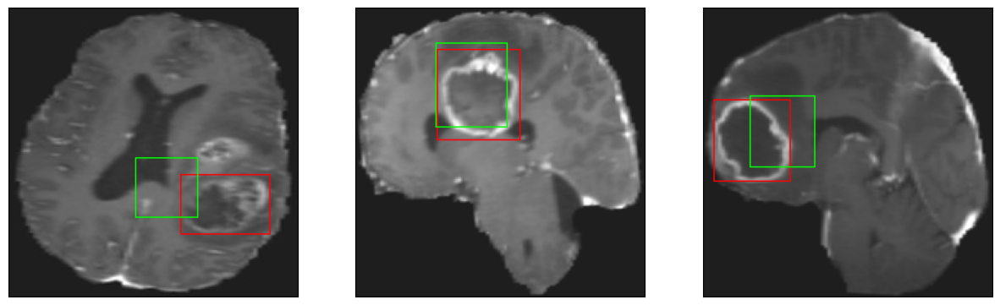

26/26 [==============================] - 2s 87ms/step - loss: 4.5198 - IoU: 0.6221 - val_loss: 12.7217 - val_IoU: 0.3583
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 4.8791 - IoU: 0.5974
Epoch 77: val_loss did not improve from 12.08038
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


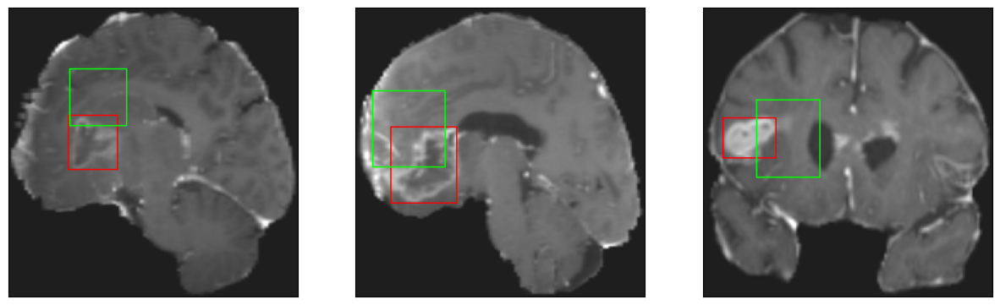

26/26 [==============================] - 2s 95ms/step - loss: 4.8791 - IoU: 0.5974 - val_loss: 13.7777 - val_IoU: 0.3203
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7453 - IoU: 0.6120
Epoch 78: val_loss improved from 12.08038 to 11.98435, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


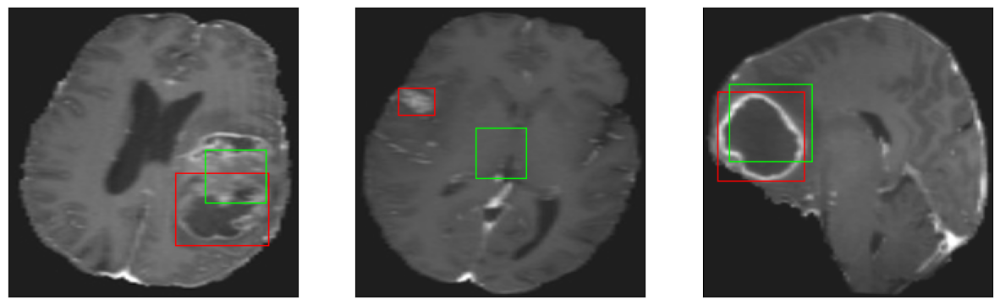

26/26 [==============================] - 4s 170ms/step - loss: 4.7817 - IoU: 0.6112 - val_loss: 11.9843 - val_IoU: 0.3761
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 4.6635 - IoU: 0.6070
Epoch 79: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


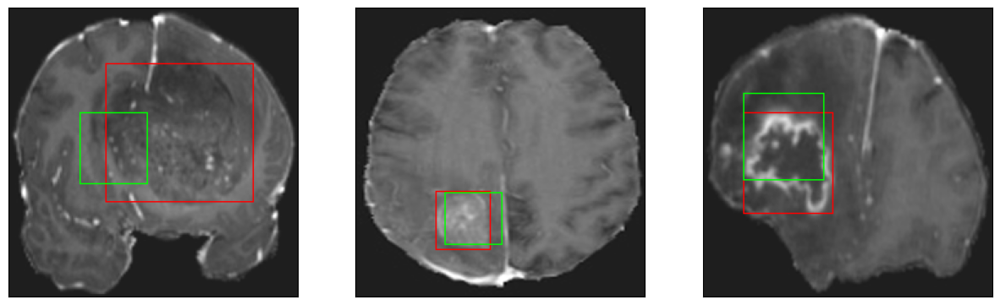

26/26 [==============================] - 3s 112ms/step - loss: 4.6635 - IoU: 0.6070 - val_loss: 12.8026 - val_IoU: 0.3541
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5728 - IoU: 0.6164
Epoch 80: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


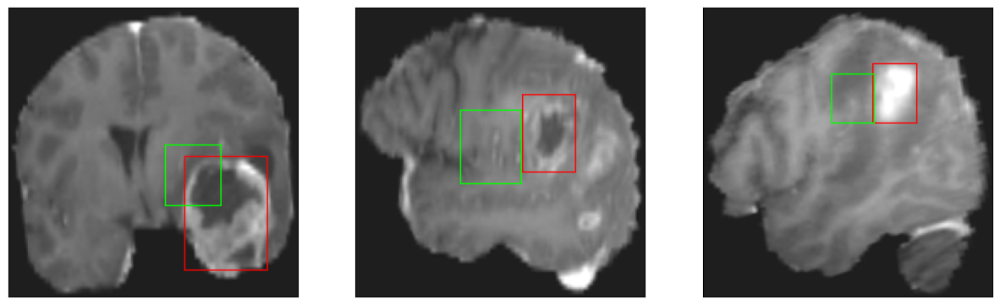

26/26 [==============================] - 3s 102ms/step - loss: 4.5469 - IoU: 0.6194 - val_loss: 12.3458 - val_IoU: 0.3565
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 4.3864 - IoU: 0.6321
Epoch 81: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


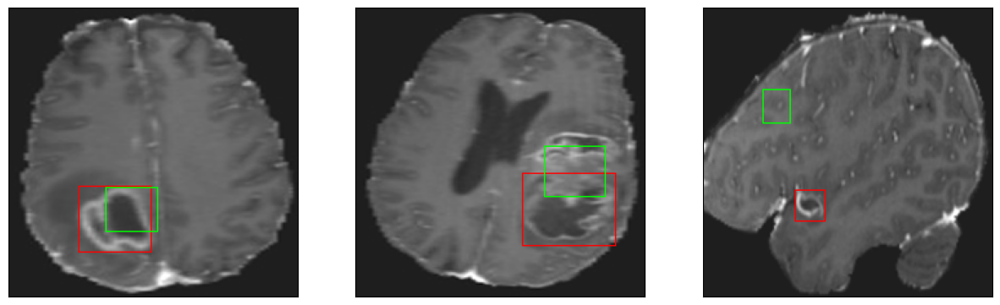

26/26 [==============================] - 3s 128ms/step - loss: 4.3864 - IoU: 0.6321 - val_loss: 12.1054 - val_IoU: 0.3790
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 4.6289 - IoU: 0.6141
Epoch 82: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


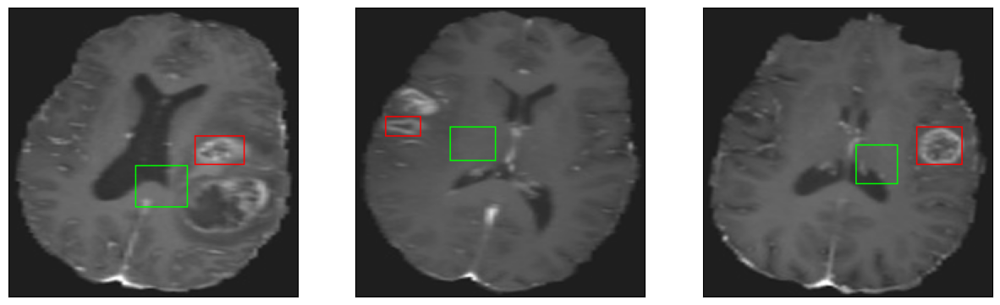

26/26 [==============================] - 3s 126ms/step - loss: 4.6289 - IoU: 0.6141 - val_loss: 13.0563 - val_IoU: 0.3199
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 4.6102 - IoU: 0.6170
Epoch 83: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


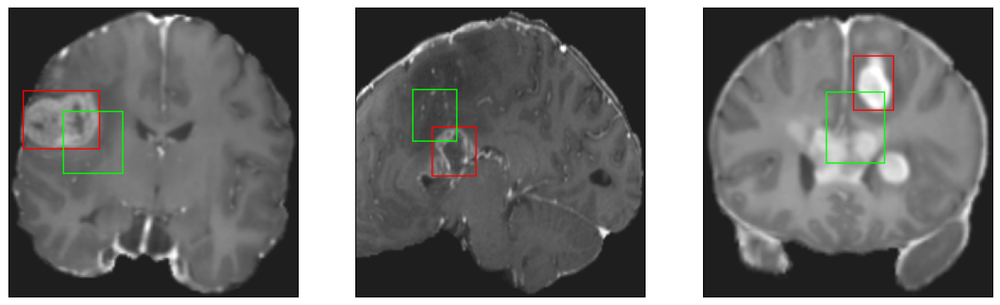

26/26 [==============================] - 3s 104ms/step - loss: 4.6102 - IoU: 0.6170 - val_loss: 12.6278 - val_IoU: 0.3550
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6612 - IoU: 0.6162
Epoch 84: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


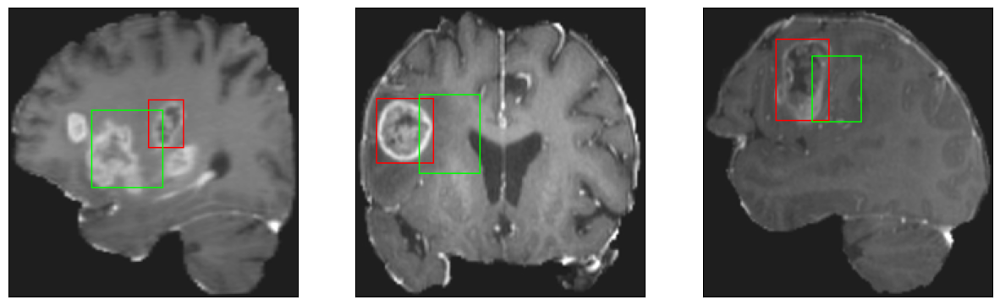

26/26 [==============================] - 2s 93ms/step - loss: 4.6039 - IoU: 0.6191 - val_loss: 12.8901 - val_IoU: 0.3499
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7153 - IoU: 0.6169
Epoch 85: val_loss did not improve from 11.98435
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


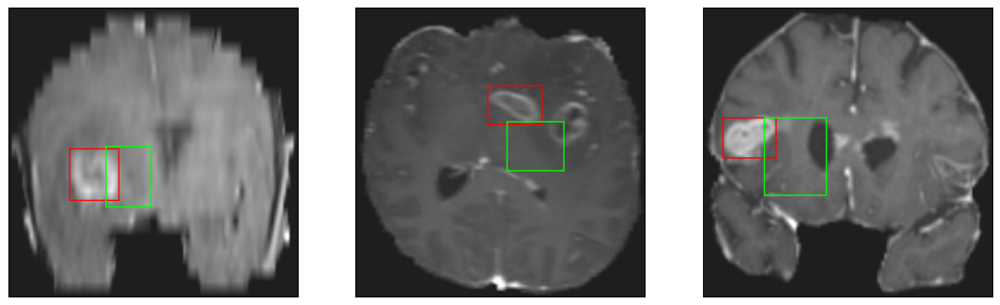

26/26 [==============================] - 2s 88ms/step - loss: 4.7191 - IoU: 0.6172 - val_loss: 12.0001 - val_IoU: 0.3696
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 4.3327 - IoU: 0.6315
Epoch 86: val_loss improved from 11.98435 to 11.82110, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


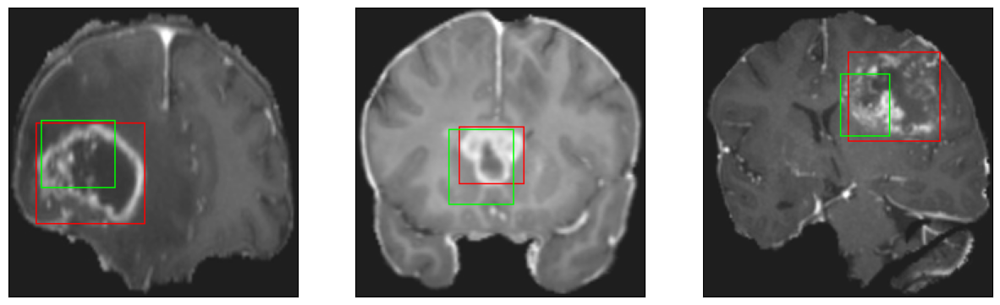

26/26 [==============================] - 4s 155ms/step - loss: 4.3327 - IoU: 0.6315 - val_loss: 11.8211 - val_IoU: 0.3724
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4735 - IoU: 0.6268
Epoch 87: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


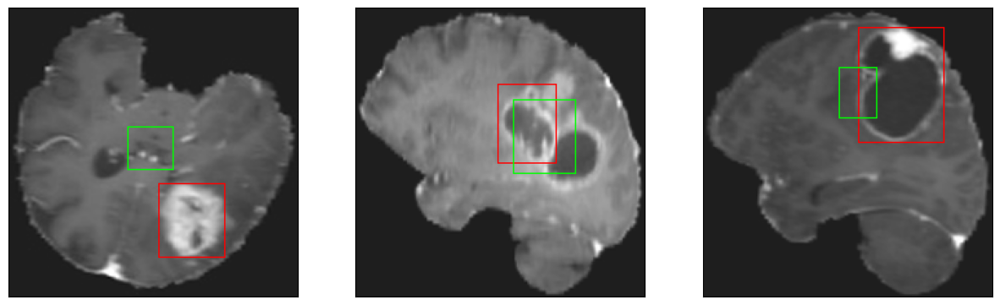

26/26 [==============================] - 3s 113ms/step - loss: 4.4594 - IoU: 0.6276 - val_loss: 12.3801 - val_IoU: 0.3478
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 4.4627 - IoU: 0.6319
Epoch 88: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


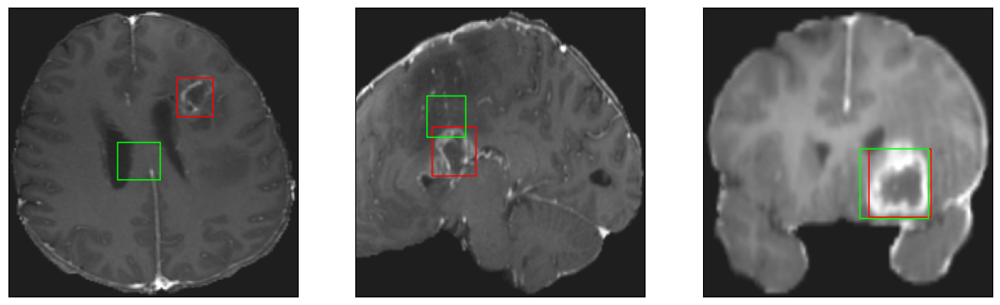

26/26 [==============================] - 3s 112ms/step - loss: 4.4627 - IoU: 0.6319 - val_loss: 12.8474 - val_IoU: 0.3316
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3546 - IoU: 0.6336
Epoch 89: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


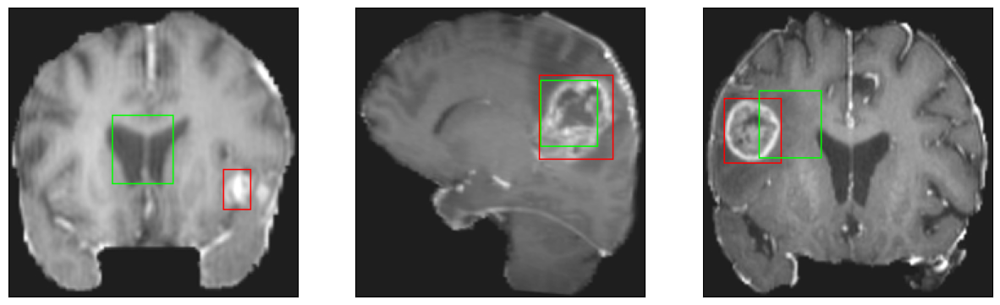

26/26 [==============================] - 2s 95ms/step - loss: 4.3584 - IoU: 0.6339 - val_loss: 12.3169 - val_IoU: 0.3465
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.5397 - IoU: 0.6259
Epoch 90: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


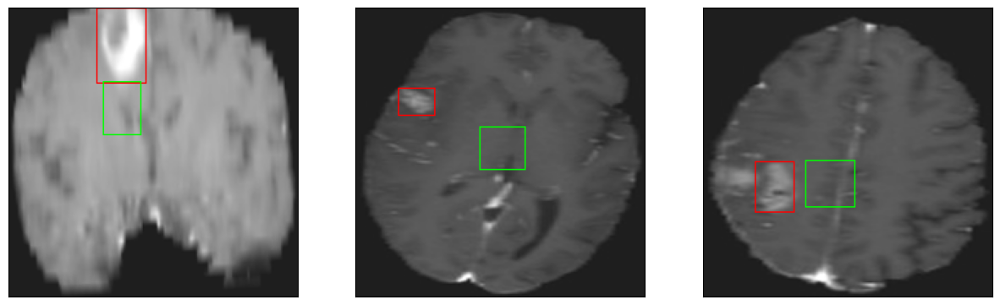

26/26 [==============================] - 3s 111ms/step - loss: 4.5397 - IoU: 0.6259 - val_loss: 12.0002 - val_IoU: 0.3707
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 4.6077 - IoU: 0.6210
Epoch 91: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


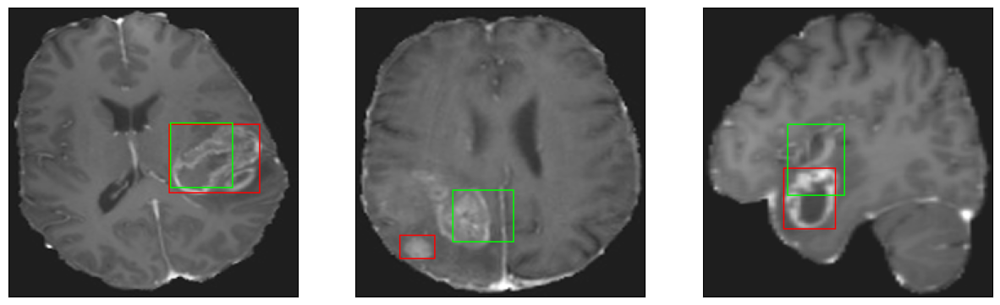

26/26 [==============================] - 2s 97ms/step - loss: 4.6077 - IoU: 0.6210 - val_loss: 12.4300 - val_IoU: 0.3596
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 4.3691 - IoU: 0.6366
Epoch 92: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


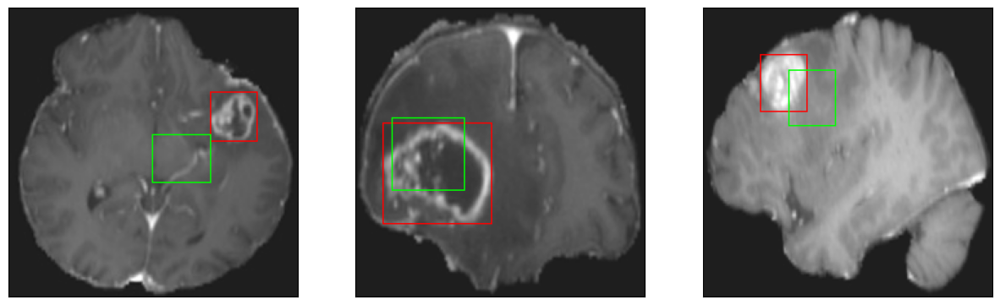

26/26 [==============================] - 2s 97ms/step - loss: 4.3691 - IoU: 0.6366 - val_loss: 12.2471 - val_IoU: 0.3653
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3957 - IoU: 0.6322
Epoch 93: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


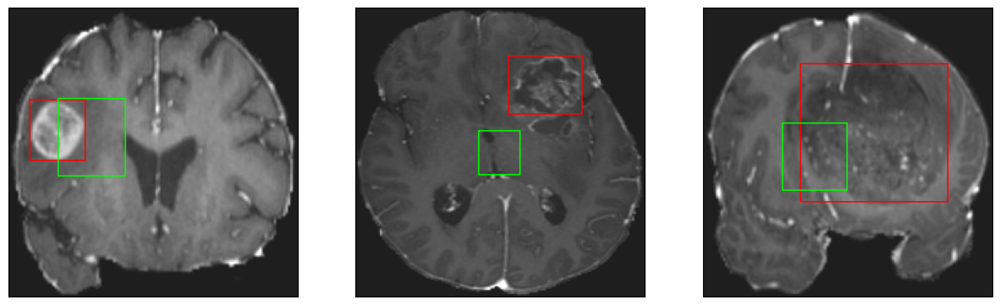

26/26 [==============================] - 2s 87ms/step - loss: 4.3676 - IoU: 0.6344 - val_loss: 11.9346 - val_IoU: 0.3764
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4486 - IoU: 0.6289
Epoch 94: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


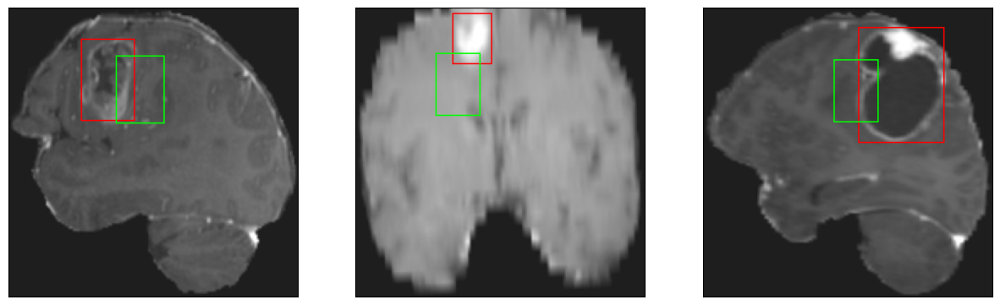

26/26 [==============================] - 3s 99ms/step - loss: 4.4383 - IoU: 0.6274 - val_loss: 13.8525 - val_IoU: 0.3251
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3795 - IoU: 0.6364
Epoch 95: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


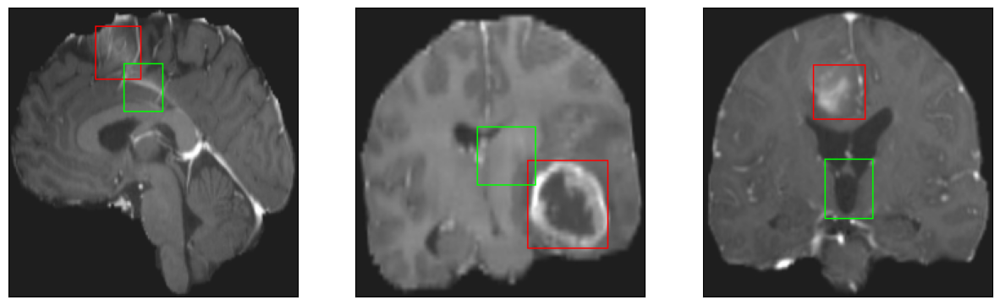

26/26 [==============================] - 3s 121ms/step - loss: 4.3551 - IoU: 0.6372 - val_loss: 13.1807 - val_IoU: 0.3427
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.2958 - IoU: 0.6356
Epoch 96: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


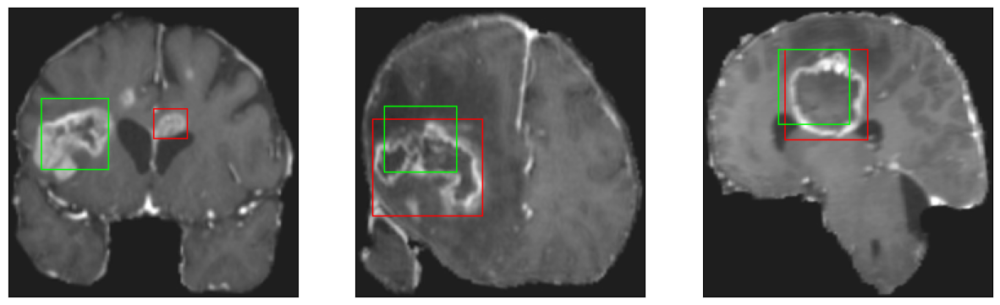

26/26 [==============================] - 3s 101ms/step - loss: 4.2958 - IoU: 0.6356 - val_loss: 11.8556 - val_IoU: 0.3788
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.3626 - IoU: 0.6365
Epoch 97: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


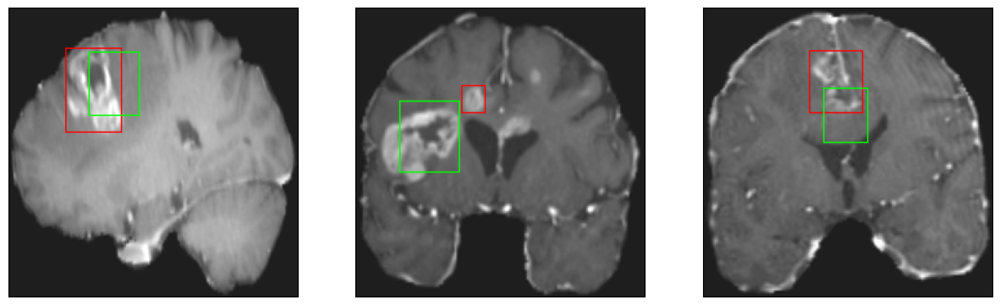

26/26 [==============================] - 3s 99ms/step - loss: 4.3626 - IoU: 0.6365 - val_loss: 12.2101 - val_IoU: 0.3609
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.4384 - IoU: 0.6253
Epoch 98: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 7ms/step
4


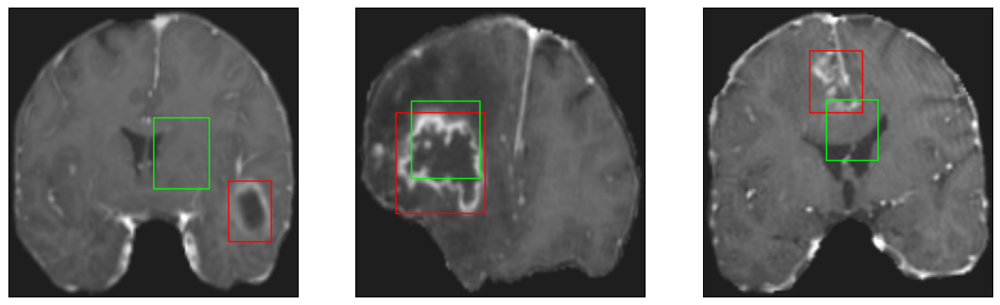

26/26 [==============================] - 2s 93ms/step - loss: 4.4384 - IoU: 0.6253 - val_loss: 13.2134 - val_IoU: 0.3223
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.4540 - IoU: 0.6229
Epoch 99: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


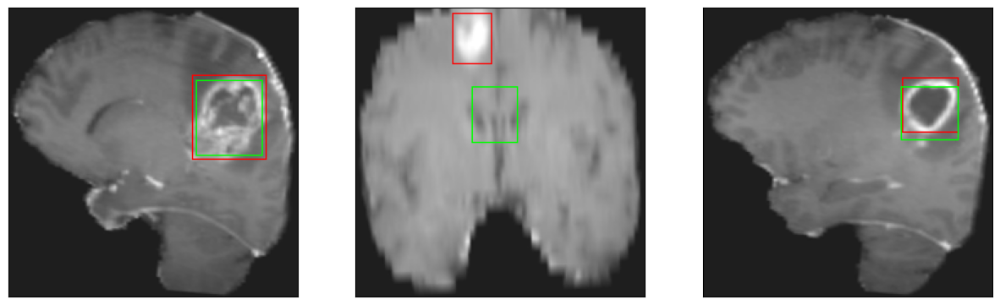

26/26 [==============================] - 3s 111ms/step - loss: 4.4540 - IoU: 0.6229 - val_loss: 12.2117 - val_IoU: 0.3630
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 4.5160 - IoU: 0.6232
Epoch 100: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


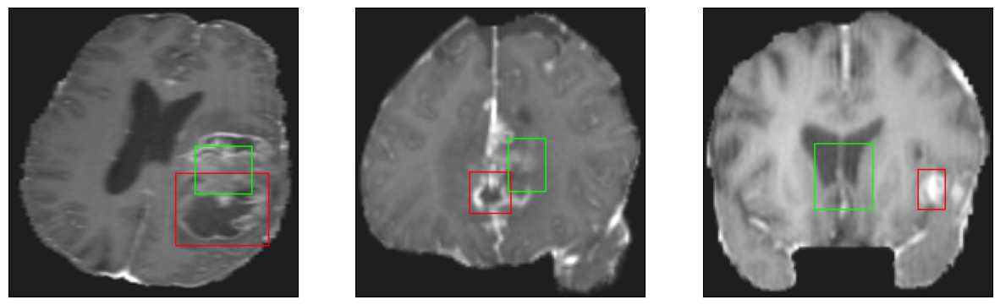

26/26 [==============================] - 3s 126ms/step - loss: 4.5160 - IoU: 0.6232 - val_loss: 12.1352 - val_IoU: 0.3682
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3678 - IoU: 0.6334
Epoch 101: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


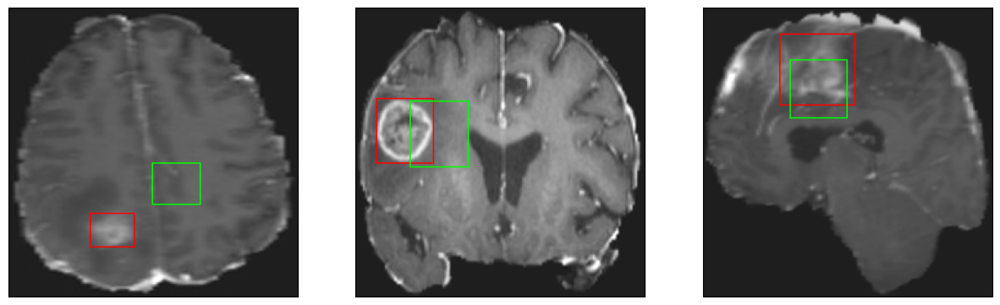

26/26 [==============================] - 3s 122ms/step - loss: 4.3350 - IoU: 0.6354 - val_loss: 12.8554 - val_IoU: 0.3384
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 4.5028 - IoU: 0.6252
Epoch 102: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


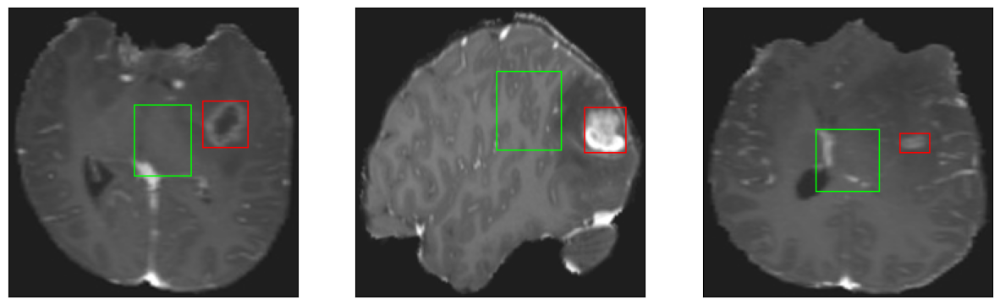

26/26 [==============================] - 2s 95ms/step - loss: 4.5028 - IoU: 0.6252 - val_loss: 13.2479 - val_IoU: 0.3400
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4633 - IoU: 0.6262
Epoch 103: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


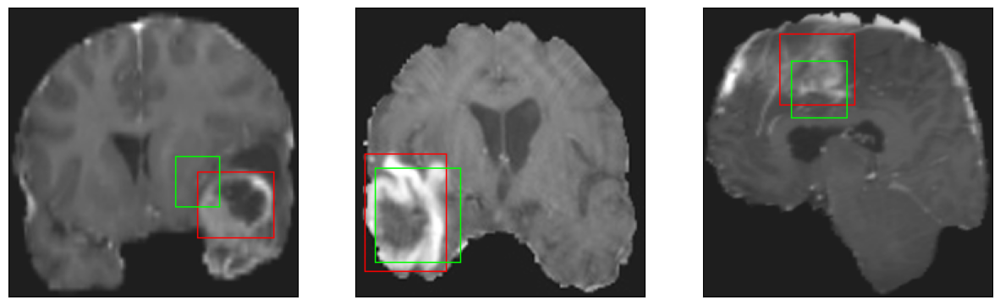

26/26 [==============================] - 3s 98ms/step - loss: 4.4481 - IoU: 0.6268 - val_loss: 12.5444 - val_IoU: 0.3479
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4044 - IoU: 0.6334
Epoch 104: val_loss did not improve from 11.82110
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


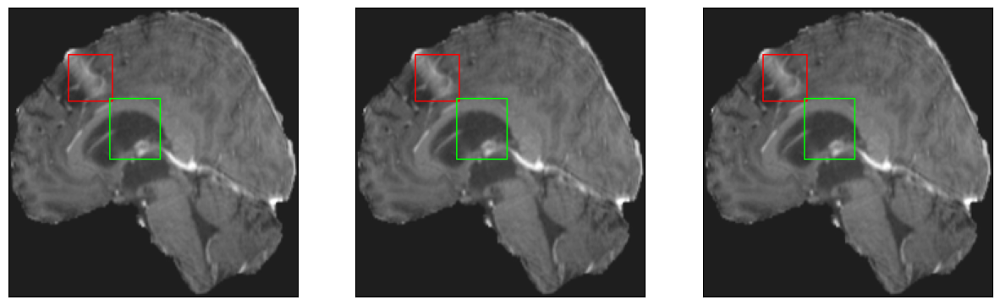

26/26 [==============================] - 3s 113ms/step - loss: 4.3800 - IoU: 0.6358 - val_loss: 12.1104 - val_IoU: 0.3677
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1678 - IoU: 0.6384
Epoch 105: val_loss improved from 11.82110 to 11.76361, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


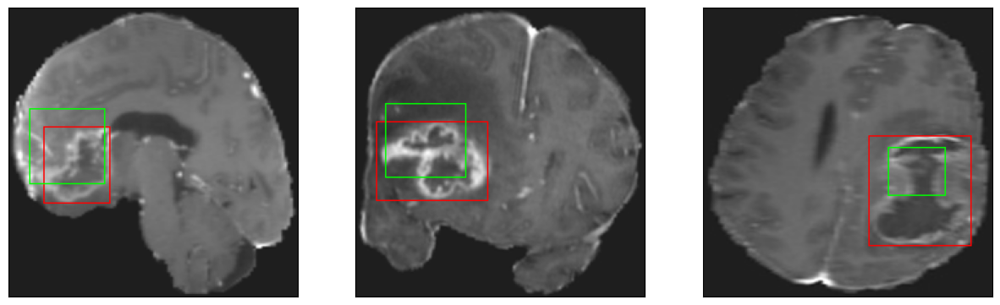

26/26 [==============================] - 4s 139ms/step - loss: 4.1933 - IoU: 0.6395 - val_loss: 11.7636 - val_IoU: 0.3704
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 4.4157 - IoU: 0.6323
Epoch 106: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


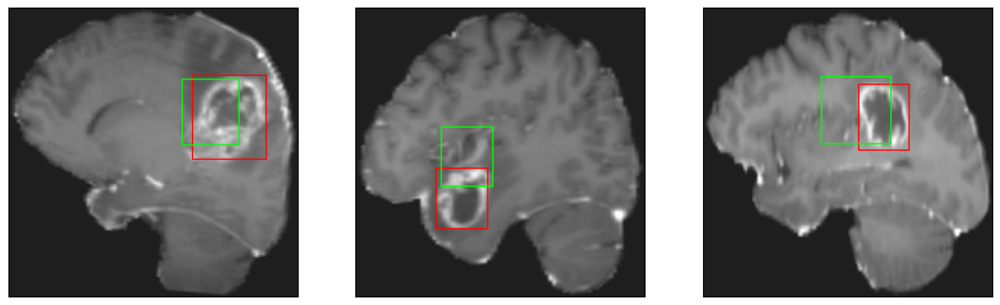

26/26 [==============================] - 3s 107ms/step - loss: 4.4157 - IoU: 0.6323 - val_loss: 12.6286 - val_IoU: 0.3513
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.4233 - IoU: 0.6316
Epoch 107: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


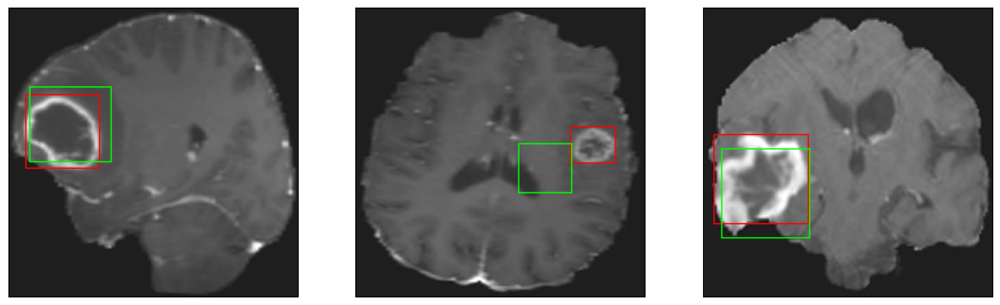

26/26 [==============================] - 3s 116ms/step - loss: 4.4233 - IoU: 0.6316 - val_loss: 11.7831 - val_IoU: 0.3930
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5219 - IoU: 0.6323
Epoch 108: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


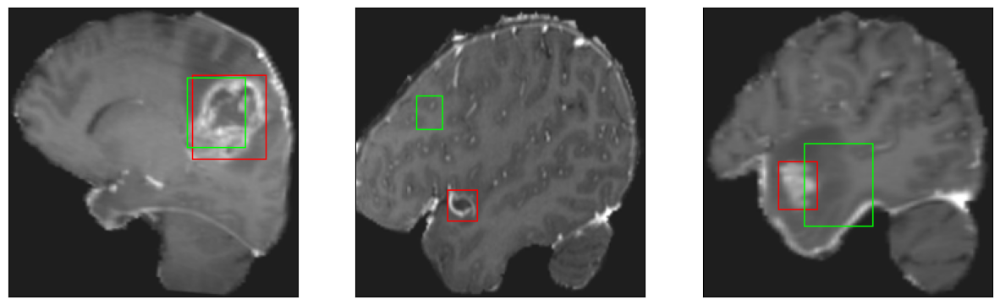

26/26 [==============================] - 3s 98ms/step - loss: 4.5282 - IoU: 0.6313 - val_loss: 11.8682 - val_IoU: 0.3850
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 4.2272 - IoU: 0.6455
Epoch 109: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


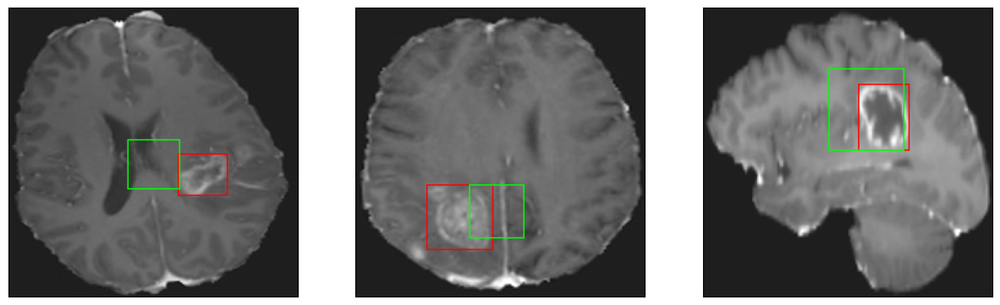

26/26 [==============================] - 3s 96ms/step - loss: 4.2272 - IoU: 0.6455 - val_loss: 12.7096 - val_IoU: 0.3630
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 4.3139 - IoU: 0.6368
Epoch 110: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


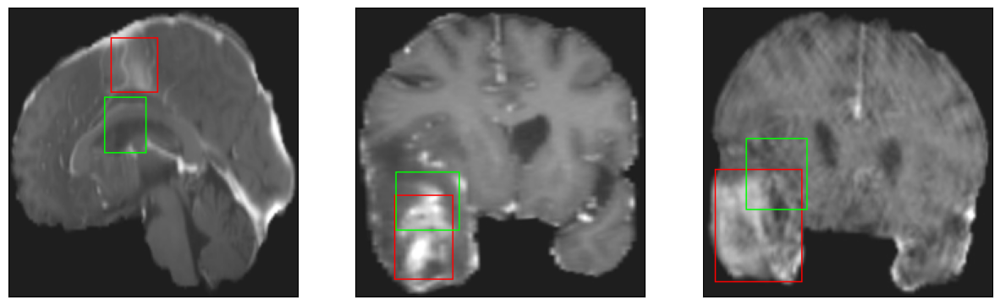

26/26 [==============================] - 2s 91ms/step - loss: 4.3139 - IoU: 0.6368 - val_loss: 12.2703 - val_IoU: 0.3607
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 4.3139 - IoU: 0.6409
Epoch 111: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


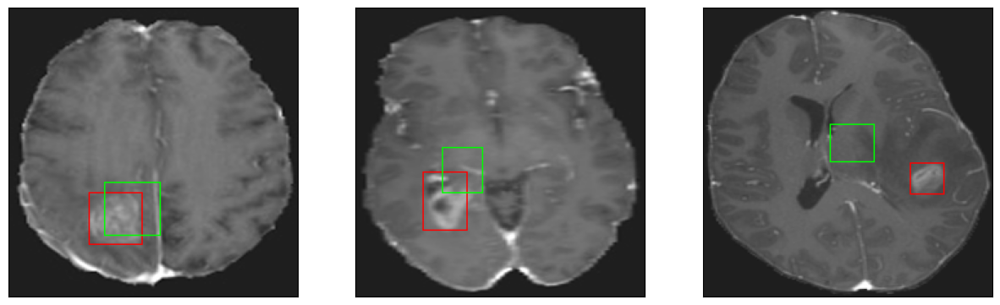

26/26 [==============================] - 3s 128ms/step - loss: 4.3139 - IoU: 0.6409 - val_loss: 12.7538 - val_IoU: 0.3542
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.1131 - IoU: 0.6527
Epoch 112: val_loss did not improve from 11.76361
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


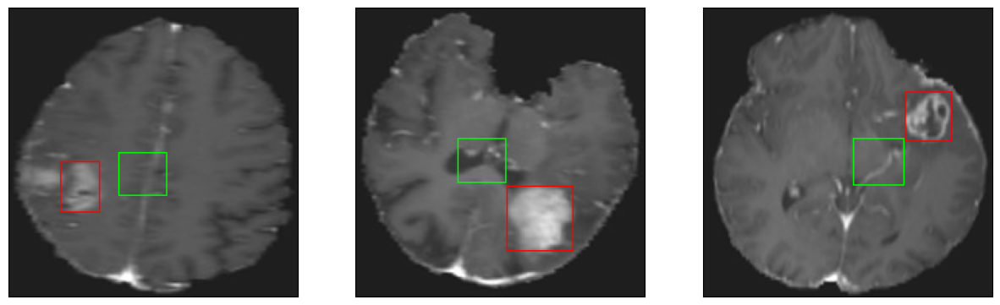

26/26 [==============================] - 2s 96ms/step - loss: 4.1131 - IoU: 0.6527 - val_loss: 12.5982 - val_IoU: 0.3436
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.1631 - IoU: 0.6487
Epoch 113: val_loss improved from 11.76361 to 11.75234, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


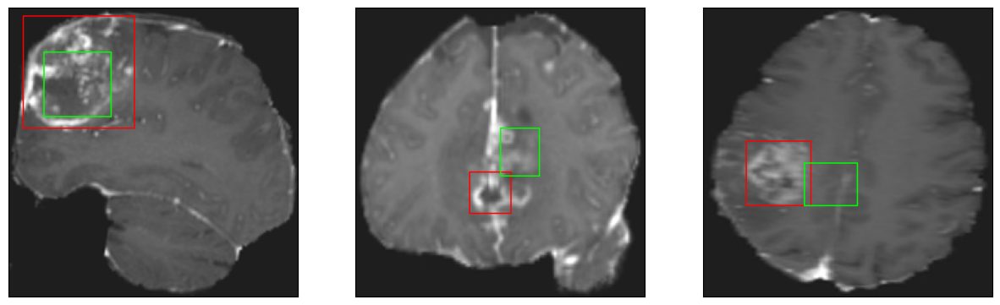

26/26 [==============================] - 4s 150ms/step - loss: 4.1631 - IoU: 0.6487 - val_loss: 11.7523 - val_IoU: 0.3785
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.4832 - IoU: 0.6186
Epoch 114: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


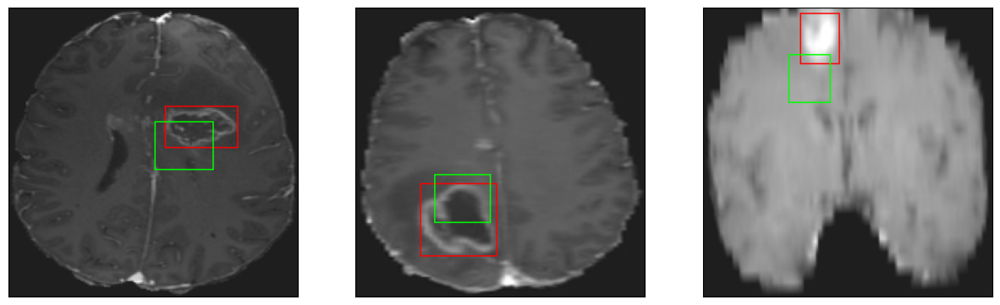

26/26 [==============================] - 3s 106ms/step - loss: 4.4832 - IoU: 0.6186 - val_loss: 12.8656 - val_IoU: 0.3484
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5326 - IoU: 0.6293
Epoch 115: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


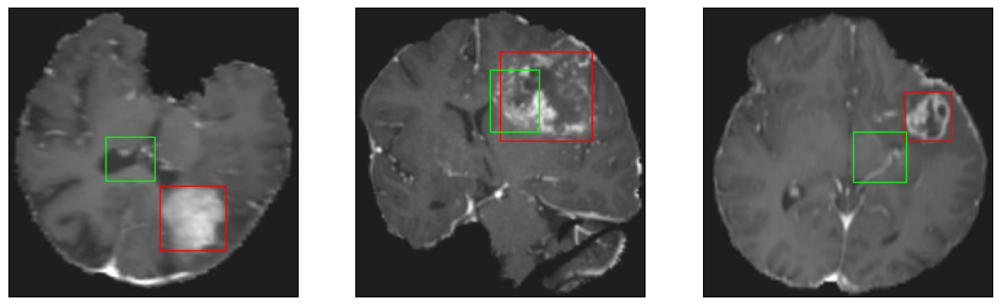

26/26 [==============================] - 3s 126ms/step - loss: 4.4974 - IoU: 0.6311 - val_loss: 11.9263 - val_IoU: 0.3811
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.2229 - IoU: 0.6377
Epoch 116: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


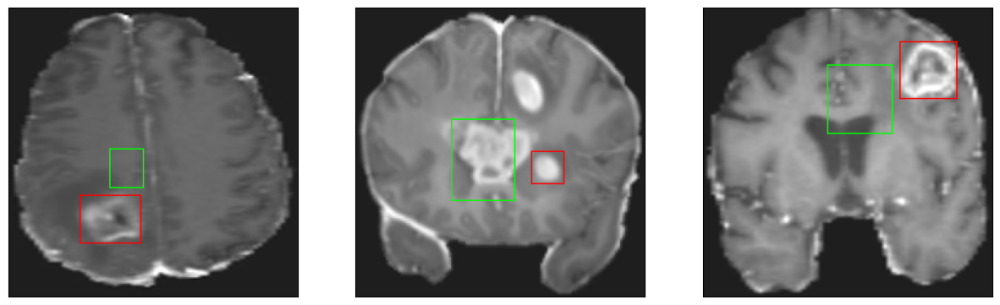

26/26 [==============================] - 3s 117ms/step - loss: 4.2229 - IoU: 0.6377 - val_loss: 13.1703 - val_IoU: 0.3305
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0420 - IoU: 0.6536
Epoch 117: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


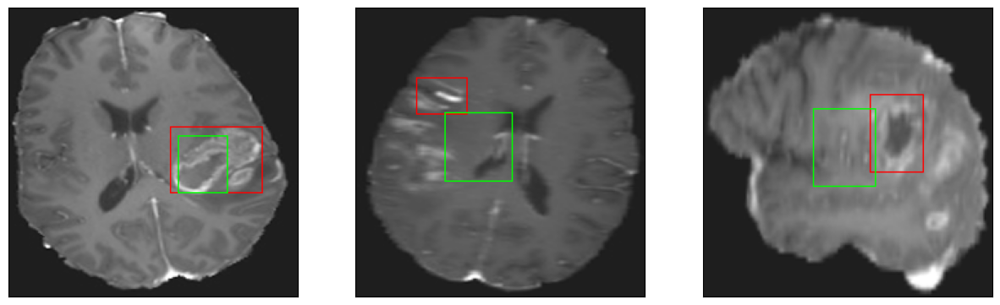

26/26 [==============================] - 2s 95ms/step - loss: 4.0198 - IoU: 0.6538 - val_loss: 12.4477 - val_IoU: 0.3594
Epoch 118/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0202 - IoU: 0.6542
Epoch 118: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


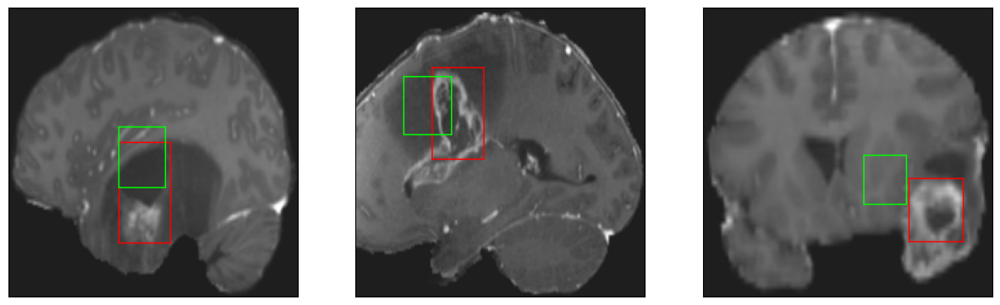

26/26 [==============================] - 3s 102ms/step - loss: 3.9732 - IoU: 0.6572 - val_loss: 12.4567 - val_IoU: 0.3472
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0513 - IoU: 0.6539
Epoch 119: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


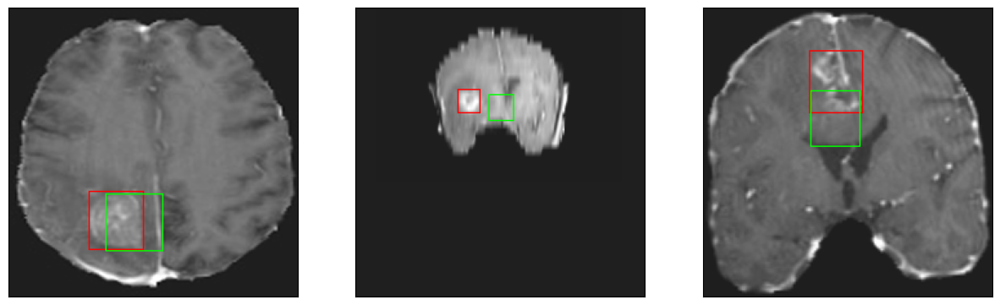

26/26 [==============================] - 3s 111ms/step - loss: 4.0310 - IoU: 0.6554 - val_loss: 12.6075 - val_IoU: 0.3538
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1705 - IoU: 0.6485
Epoch 120: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


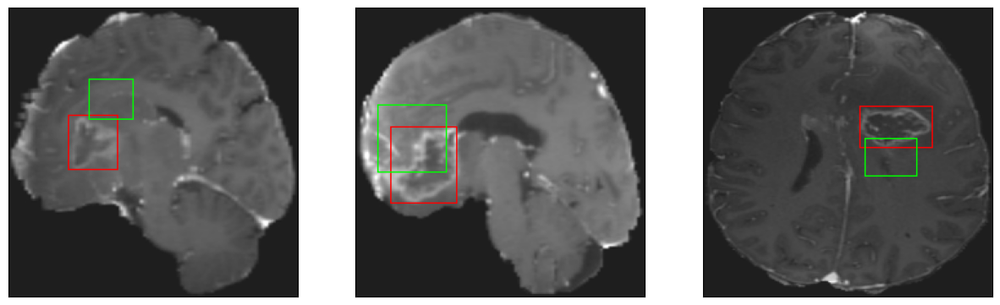

26/26 [==============================] - 3s 122ms/step - loss: 4.1742 - IoU: 0.6485 - val_loss: 12.6753 - val_IoU: 0.3442
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.0988 - IoU: 0.6566
Epoch 121: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


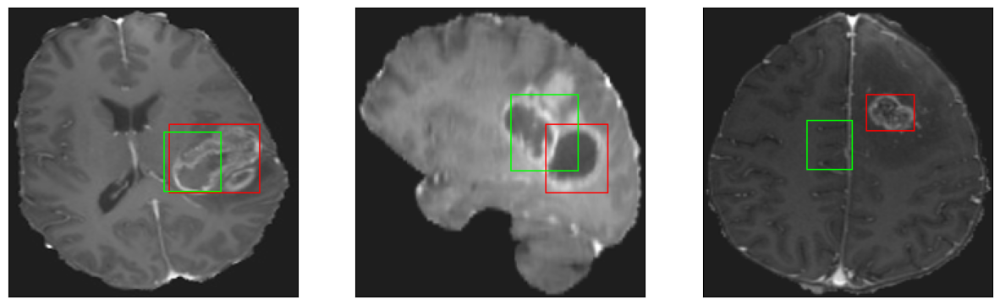

26/26 [==============================] - 2s 96ms/step - loss: 4.0988 - IoU: 0.6566 - val_loss: 12.5121 - val_IoU: 0.3655
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.2152 - IoU: 0.6421
Epoch 122: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


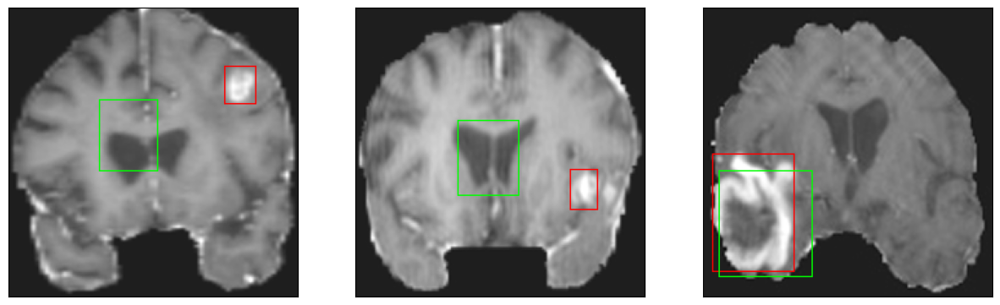

26/26 [==============================] - 3s 105ms/step - loss: 4.2152 - IoU: 0.6421 - val_loss: 12.7884 - val_IoU: 0.3699
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5749 - IoU: 0.6249
Epoch 123: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


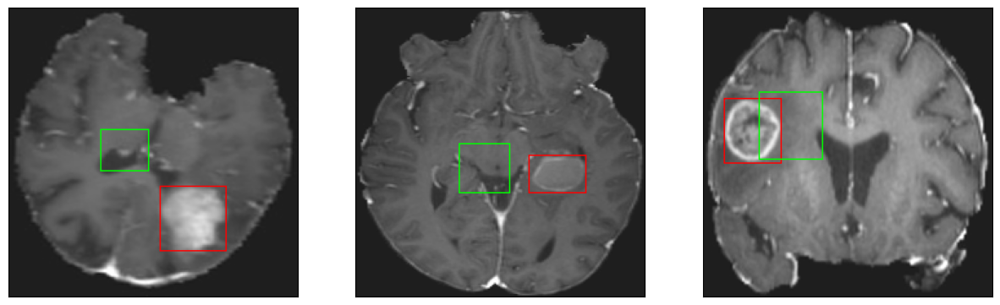

26/26 [==============================] - 3s 121ms/step - loss: 4.5432 - IoU: 0.6264 - val_loss: 13.4081 - val_IoU: 0.3196
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1974 - IoU: 0.6483
Epoch 124: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


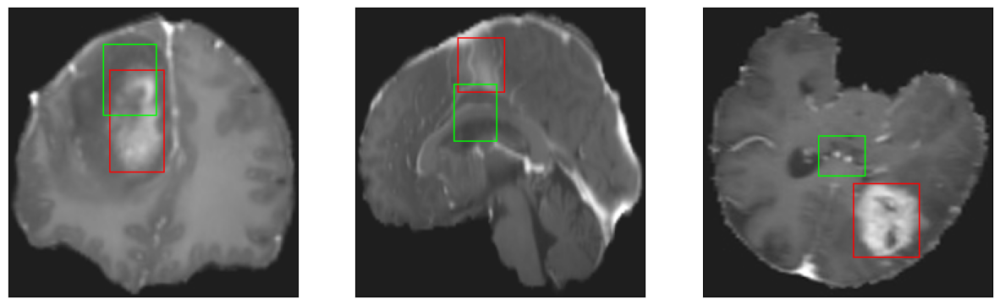

26/26 [==============================] - 3s 102ms/step - loss: 4.2144 - IoU: 0.6461 - val_loss: 12.0273 - val_IoU: 0.3733
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 4.4102 - IoU: 0.6281
Epoch 125: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


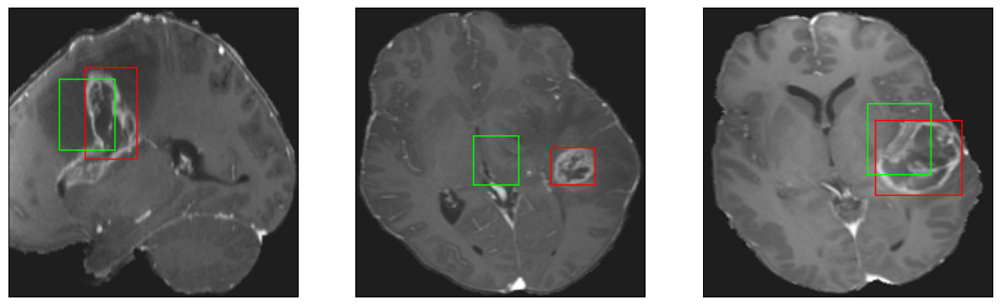

26/26 [==============================] - 3s 102ms/step - loss: 4.4102 - IoU: 0.6281 - val_loss: 12.1300 - val_IoU: 0.3817
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 3.9937 - IoU: 0.6625
Epoch 126: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


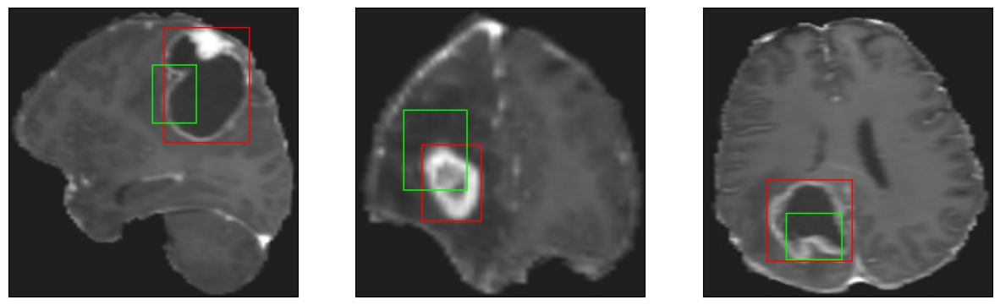

26/26 [==============================] - 2s 85ms/step - loss: 3.9937 - IoU: 0.6625 - val_loss: 12.0134 - val_IoU: 0.3746
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1350 - IoU: 0.6494
Epoch 127: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


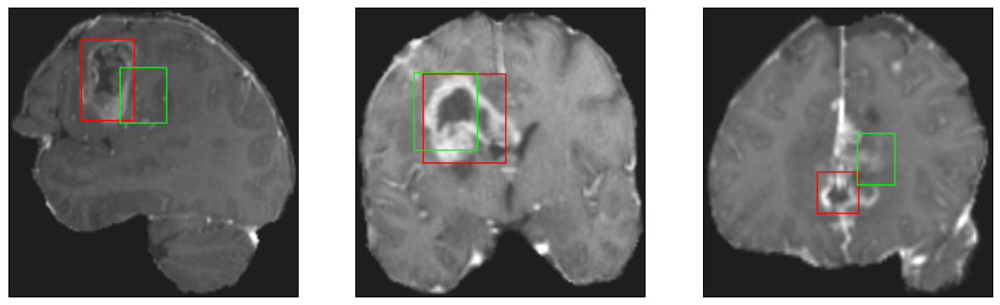

26/26 [==============================] - 2s 92ms/step - loss: 4.1450 - IoU: 0.6487 - val_loss: 12.0709 - val_IoU: 0.3684
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0465 - IoU: 0.6520
Epoch 128: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


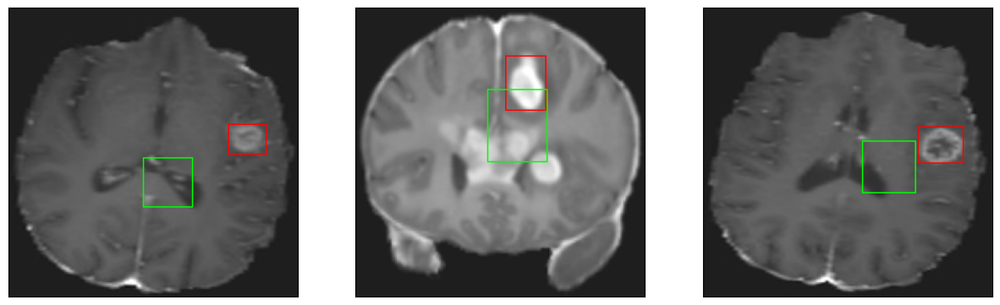

26/26 [==============================] - 3s 120ms/step - loss: 4.0198 - IoU: 0.6527 - val_loss: 12.5871 - val_IoU: 0.3648
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.2811 - IoU: 0.6393
Epoch 129: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4


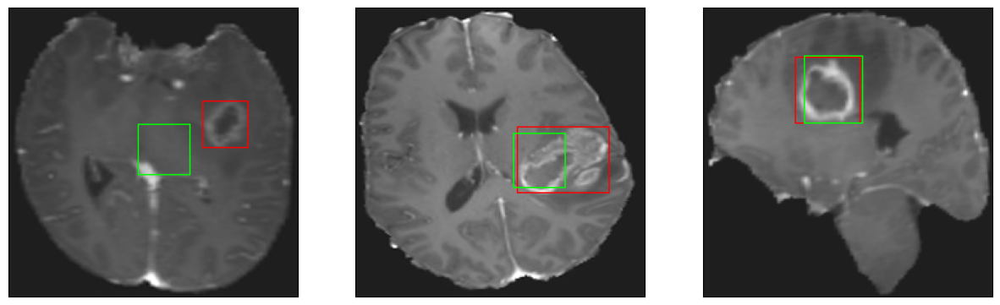

26/26 [==============================] - 3s 130ms/step - loss: 4.2811 - IoU: 0.6393 - val_loss: 12.1651 - val_IoU: 0.3625
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 4.2334 - IoU: 0.6419
Epoch 130: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


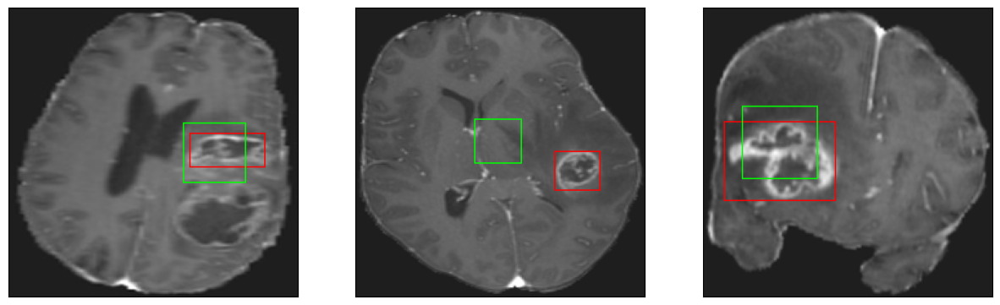

26/26 [==============================] - 3s 103ms/step - loss: 4.2334 - IoU: 0.6419 - val_loss: 12.2996 - val_IoU: 0.3564
Epoch 131/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1229 - IoU: 0.6573
Epoch 131: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


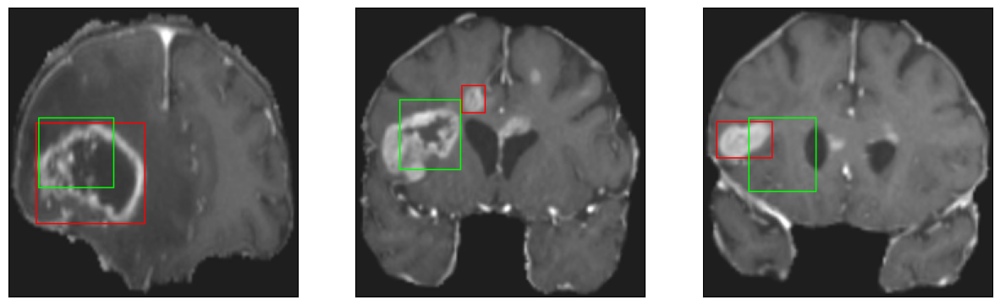

26/26 [==============================] - 3s 98ms/step - loss: 4.0884 - IoU: 0.6584 - val_loss: 11.7929 - val_IoU: 0.3773
Epoch 132/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8722 - IoU: 0.6681
Epoch 132: val_loss did not improve from 11.75234
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


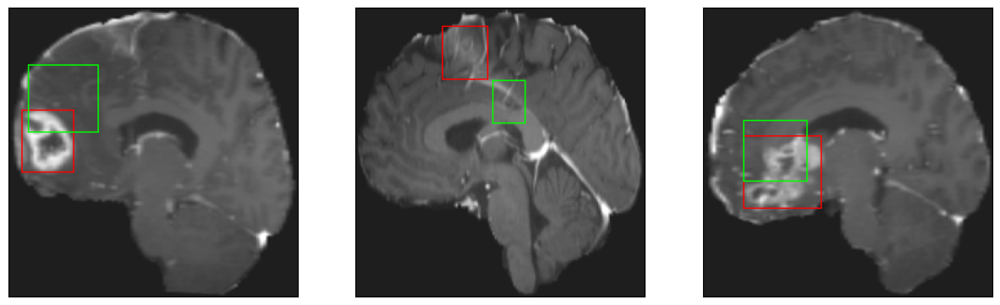

26/26 [==============================] - 3s 115ms/step - loss: 3.8836 - IoU: 0.6664 - val_loss: 12.2759 - val_IoU: 0.3513
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4752 - IoU: 0.6297
Epoch 133: val_loss improved from 11.75234 to 11.73785, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


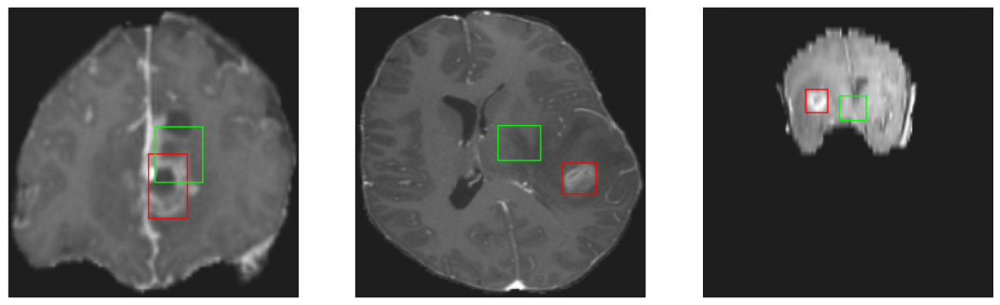

26/26 [==============================] - 4s 150ms/step - loss: 4.4380 - IoU: 0.6307 - val_loss: 11.7379 - val_IoU: 0.3801
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1039 - IoU: 0.6506
Epoch 134: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


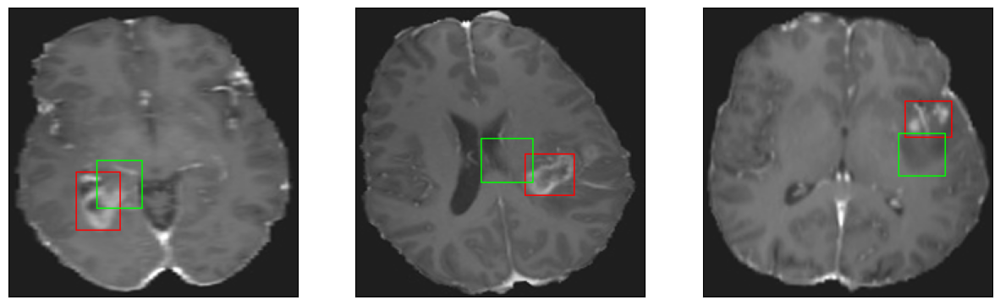

26/26 [==============================] - 3s 106ms/step - loss: 4.1571 - IoU: 0.6506 - val_loss: 11.7740 - val_IoU: 0.3821
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 3.9972 - IoU: 0.6599
Epoch 135: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


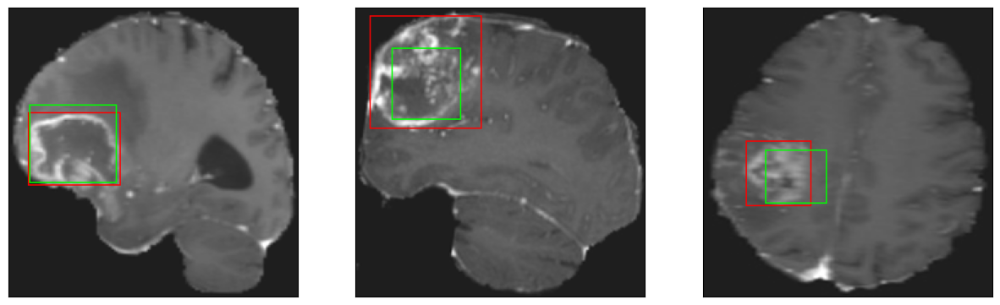

26/26 [==============================] - 3s 119ms/step - loss: 3.9972 - IoU: 0.6599 - val_loss: 13.6089 - val_IoU: 0.3242
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0698 - IoU: 0.6575
Epoch 136: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


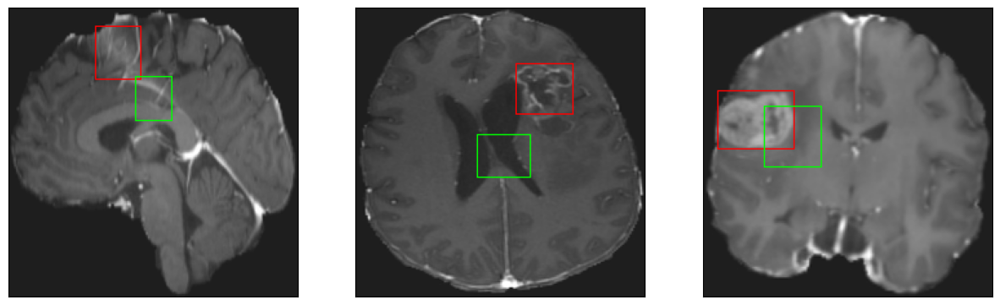

26/26 [==============================] - 3s 98ms/step - loss: 4.0332 - IoU: 0.6577 - val_loss: 12.4063 - val_IoU: 0.3569
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.0889 - IoU: 0.6483
Epoch 137: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


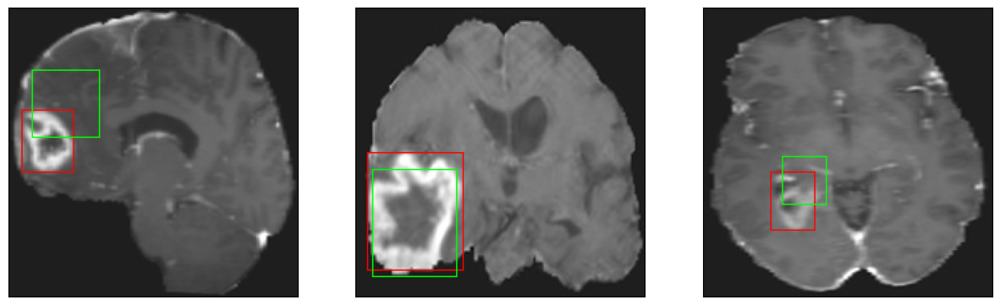

26/26 [==============================] - 2s 90ms/step - loss: 4.0889 - IoU: 0.6483 - val_loss: 11.9655 - val_IoU: 0.3845
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 4.0355 - IoU: 0.6590
Epoch 138: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


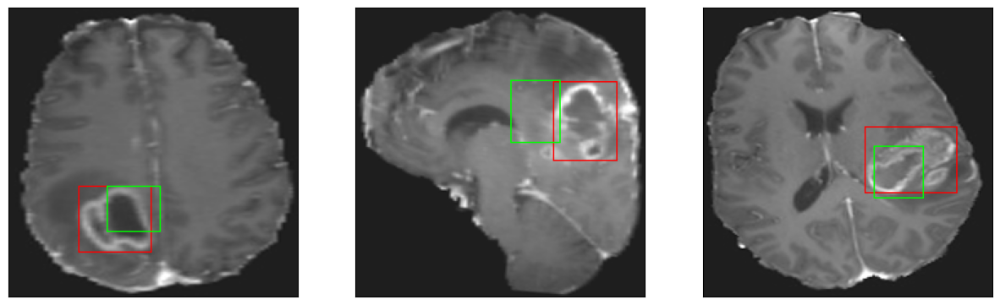

26/26 [==============================] - 3s 112ms/step - loss: 4.0355 - IoU: 0.6590 - val_loss: 12.5326 - val_IoU: 0.3637
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 3.9608 - IoU: 0.6616
Epoch 139: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


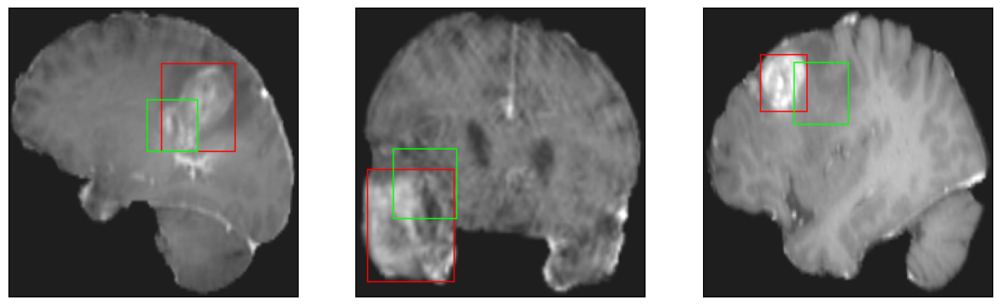

26/26 [==============================] - 3s 134ms/step - loss: 3.9608 - IoU: 0.6616 - val_loss: 11.8270 - val_IoU: 0.3910
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.0623 - IoU: 0.6569
Epoch 140: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


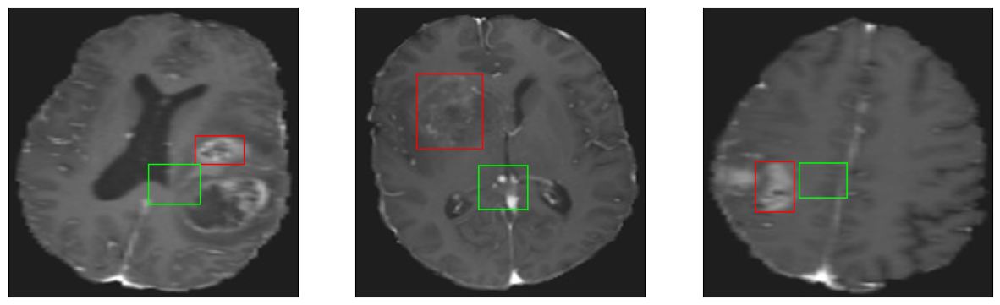

26/26 [==============================] - 2s 94ms/step - loss: 4.0623 - IoU: 0.6569 - val_loss: 12.4174 - val_IoU: 0.3531
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9629 - IoU: 0.6608
Epoch 141: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


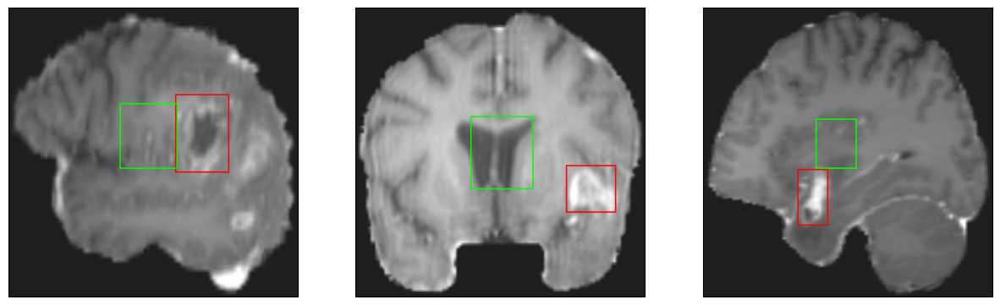

26/26 [==============================] - 3s 99ms/step - loss: 3.9641 - IoU: 0.6631 - val_loss: 12.9338 - val_IoU: 0.3253
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.0773 - IoU: 0.6526
Epoch 142: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


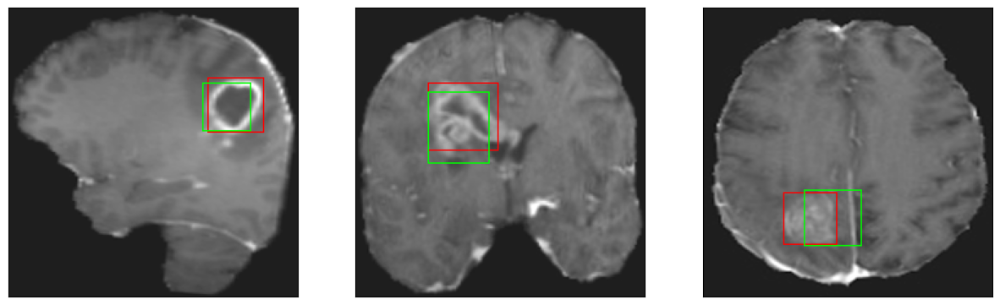

26/26 [==============================] - 2s 93ms/step - loss: 4.0773 - IoU: 0.6526 - val_loss: 11.9552 - val_IoU: 0.3732
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1028 - IoU: 0.6547
Epoch 143: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


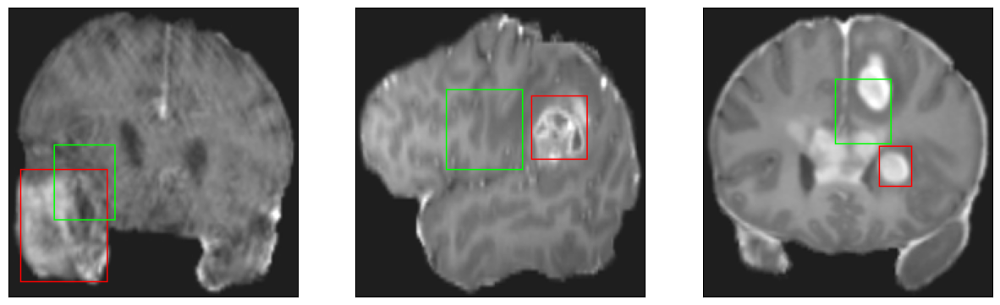

26/26 [==============================] - 3s 103ms/step - loss: 4.1039 - IoU: 0.6550 - val_loss: 11.7969 - val_IoU: 0.3880
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8826 - IoU: 0.6727
Epoch 144: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


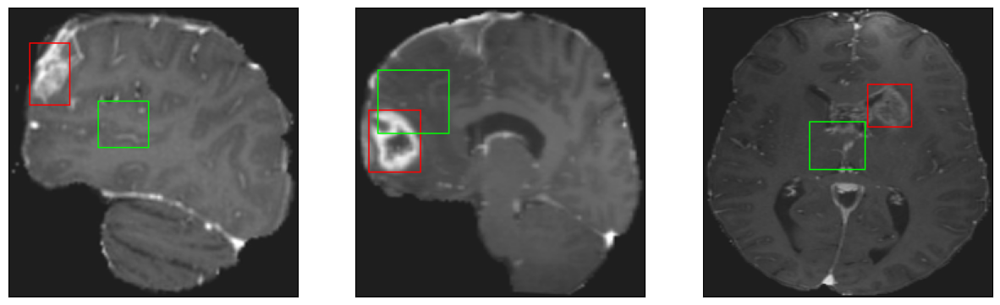

26/26 [==============================] - 3s 105ms/step - loss: 3.8683 - IoU: 0.6725 - val_loss: 12.1911 - val_IoU: 0.3586
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 3.9120 - IoU: 0.6660
Epoch 145: val_loss did not improve from 11.73785
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


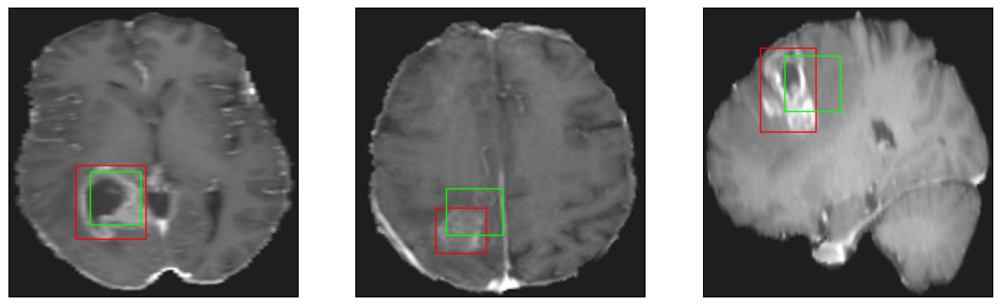

26/26 [==============================] - 3s 104ms/step - loss: 3.9120 - IoU: 0.6660 - val_loss: 12.4681 - val_IoU: 0.3612
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8916 - IoU: 0.6728
Epoch 146: val_loss improved from 11.73785 to 11.60216, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


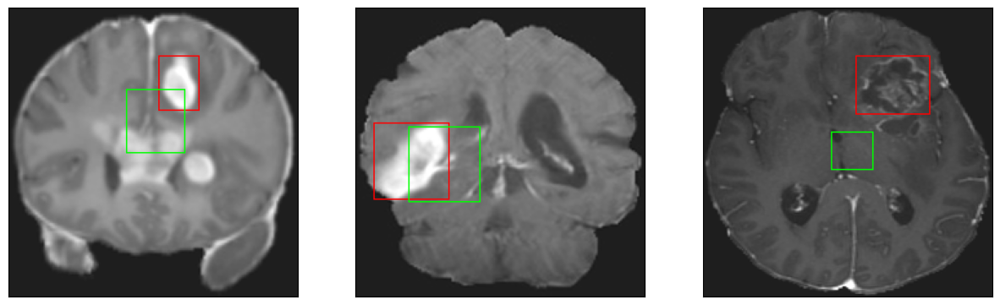

26/26 [==============================] - 4s 169ms/step - loss: 3.8667 - IoU: 0.6756 - val_loss: 11.6022 - val_IoU: 0.3912
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2028 - IoU: 0.6468
Epoch 147: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


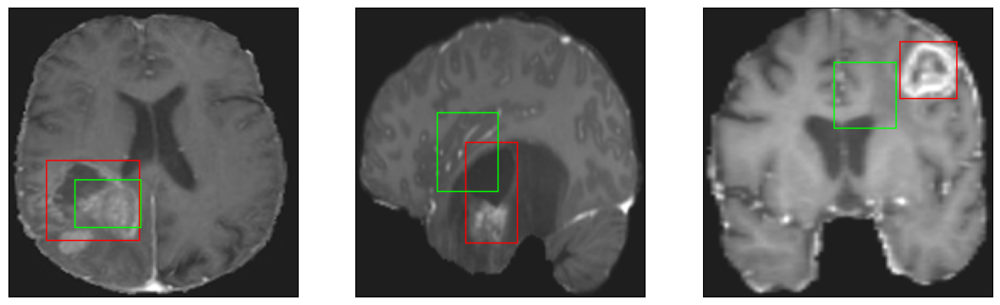

26/26 [==============================] - 3s 117ms/step - loss: 4.1712 - IoU: 0.6488 - val_loss: 12.8054 - val_IoU: 0.3573
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 3.9846 - IoU: 0.6659
Epoch 148: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


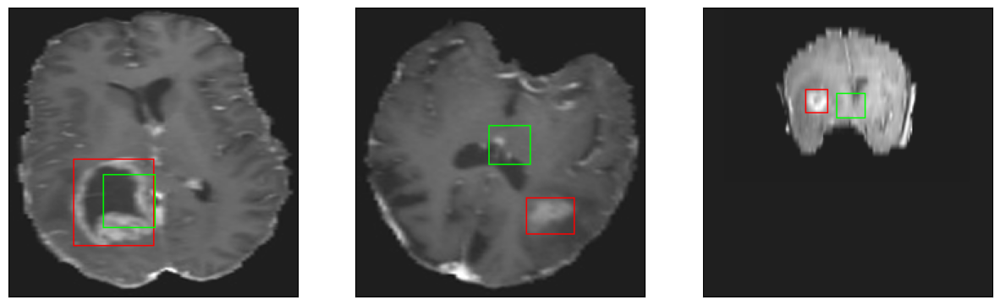

26/26 [==============================] - 3s 99ms/step - loss: 3.9846 - IoU: 0.6659 - val_loss: 12.1098 - val_IoU: 0.3646
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 3.8766 - IoU: 0.6646
Epoch 149: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


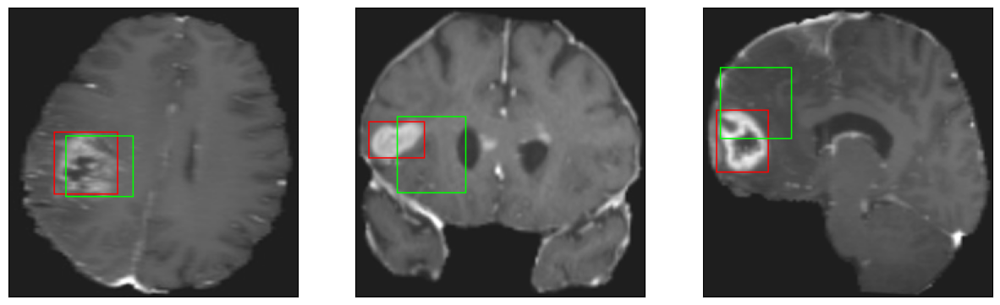

26/26 [==============================] - 3s 104ms/step - loss: 3.8766 - IoU: 0.6646 - val_loss: 11.7814 - val_IoU: 0.3767
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 3.7874 - IoU: 0.6741
Epoch 150: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


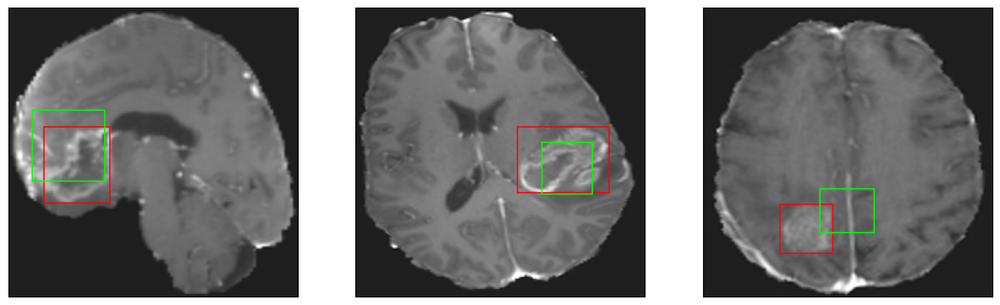

26/26 [==============================] - 3s 113ms/step - loss: 3.7874 - IoU: 0.6741 - val_loss: 12.0862 - val_IoU: 0.3688
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.0807 - IoU: 0.6553
Epoch 151: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


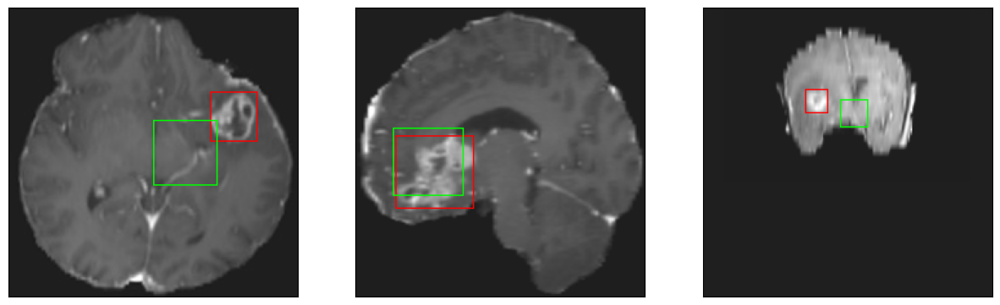

26/26 [==============================] - 3s 97ms/step - loss: 4.0807 - IoU: 0.6553 - val_loss: 12.0475 - val_IoU: 0.3751
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1680 - IoU: 0.6489
Epoch 152: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


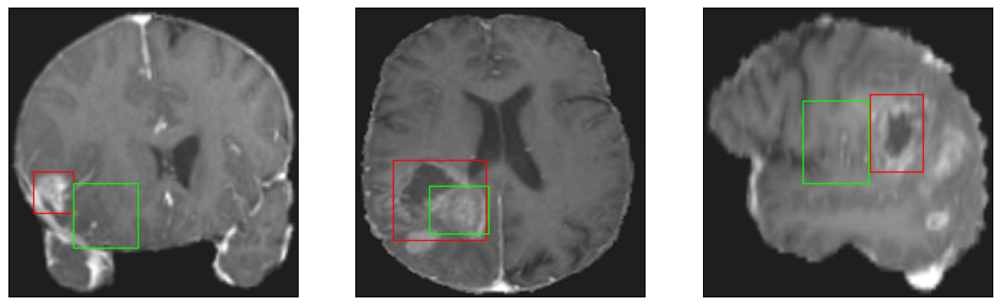

26/26 [==============================] - 2s 97ms/step - loss: 4.1550 - IoU: 0.6519 - val_loss: 12.0512 - val_IoU: 0.3771
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.0031 - IoU: 0.6553
Epoch 153: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


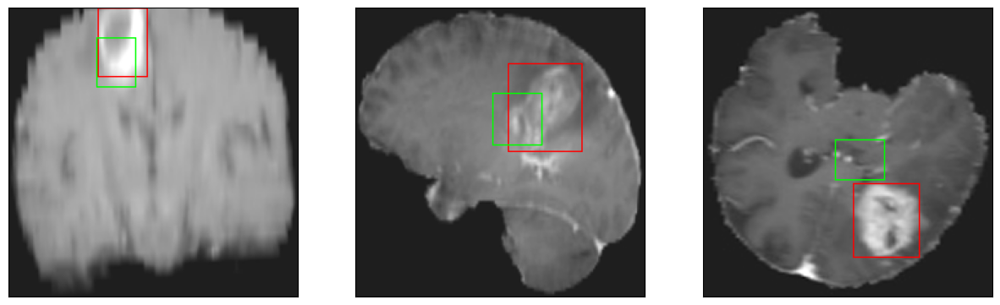

26/26 [==============================] - 3s 102ms/step - loss: 4.0031 - IoU: 0.6553 - val_loss: 12.5276 - val_IoU: 0.3507
Epoch 154/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0790 - IoU: 0.6510
Epoch 154: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


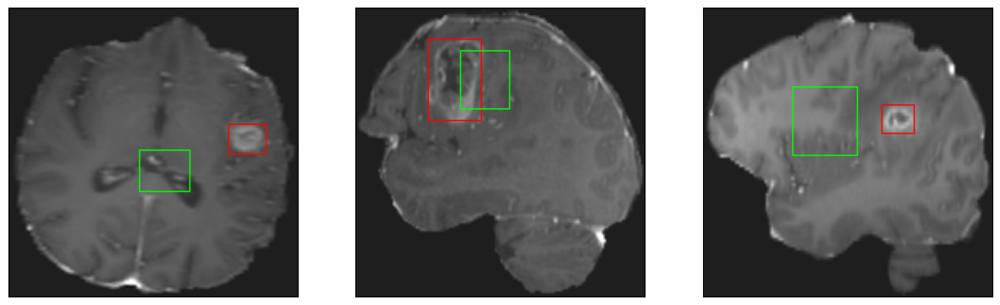

26/26 [==============================] - 2s 93ms/step - loss: 4.0772 - IoU: 0.6509 - val_loss: 12.5839 - val_IoU: 0.3468
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1533 - IoU: 0.6453
Epoch 155: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


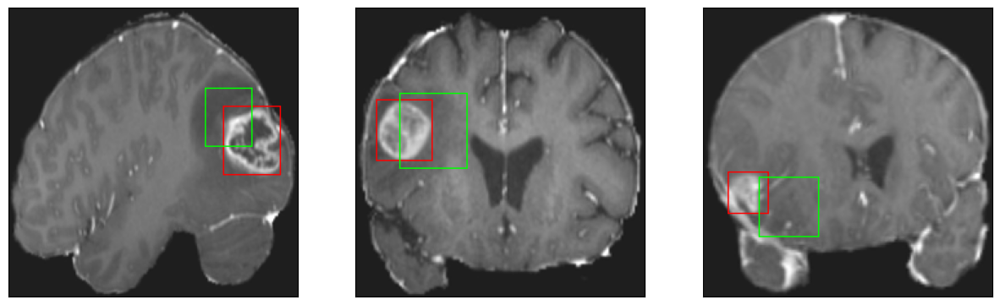

26/26 [==============================] - 3s 121ms/step - loss: 4.1709 - IoU: 0.6438 - val_loss: 11.7032 - val_IoU: 0.3747
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0676 - IoU: 0.6481
Epoch 156: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


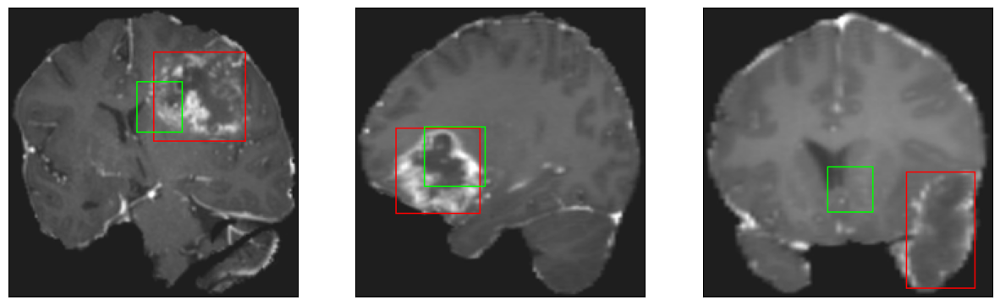

26/26 [==============================] - 3s 98ms/step - loss: 4.0583 - IoU: 0.6502 - val_loss: 13.3854 - val_IoU: 0.3167
Epoch 157/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9284 - IoU: 0.6656
Epoch 157: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


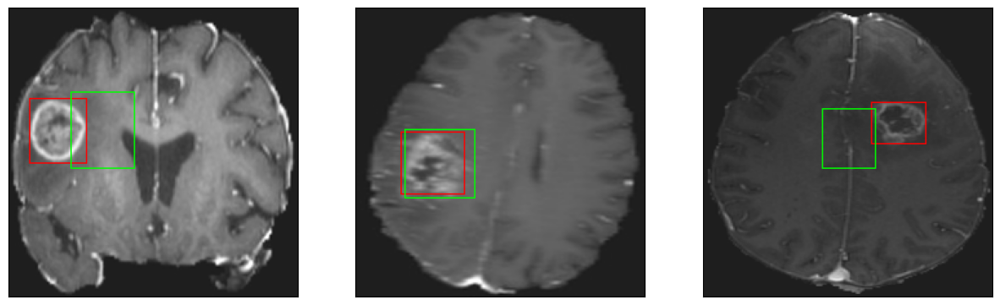

26/26 [==============================] - 2s 94ms/step - loss: 3.9604 - IoU: 0.6646 - val_loss: 12.6350 - val_IoU: 0.3647
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9460 - IoU: 0.6637
Epoch 158: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


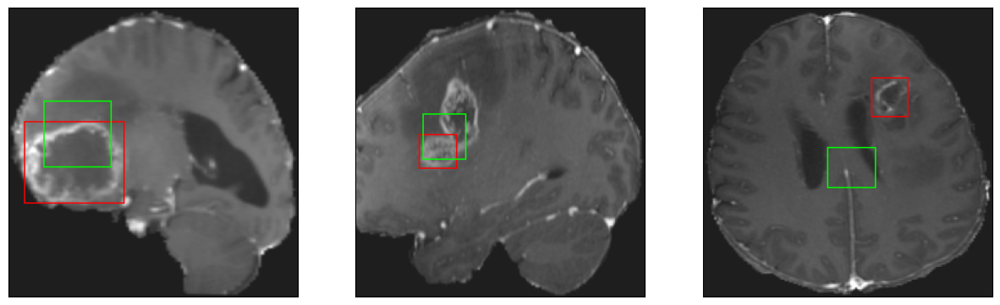

26/26 [==============================] - 3s 97ms/step - loss: 3.9356 - IoU: 0.6641 - val_loss: 12.3407 - val_IoU: 0.3533
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 3.8708 - IoU: 0.6686
Epoch 159: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


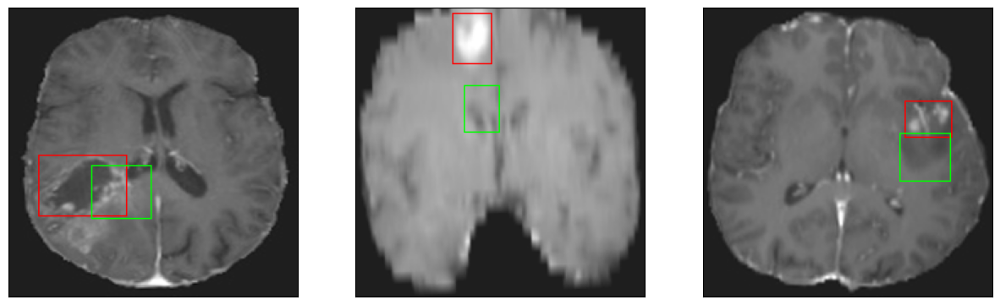

26/26 [==============================] - 4s 138ms/step - loss: 3.8708 - IoU: 0.6686 - val_loss: 12.3262 - val_IoU: 0.3582
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 3.7771 - IoU: 0.6741
Epoch 160: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


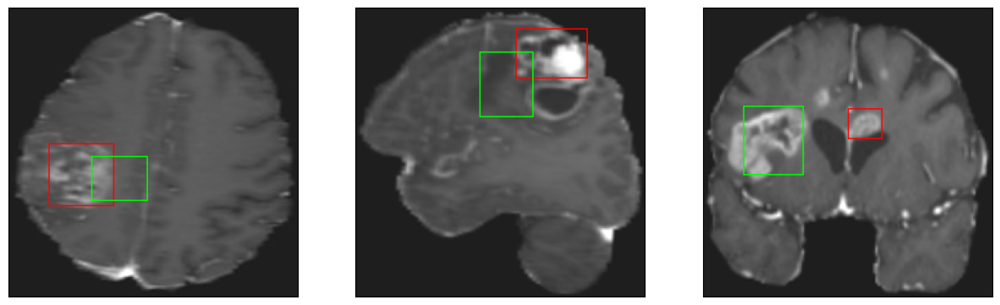

26/26 [==============================] - 3s 114ms/step - loss: 3.7771 - IoU: 0.6741 - val_loss: 11.7917 - val_IoU: 0.3778
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7591 - IoU: 0.6782
Epoch 161: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


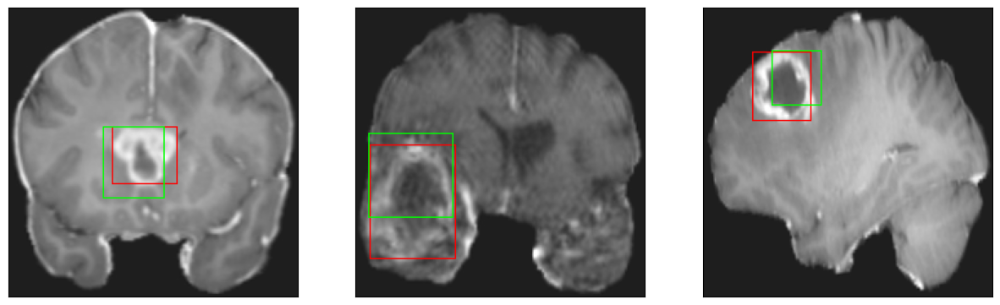

26/26 [==============================] - 2s 95ms/step - loss: 3.7252 - IoU: 0.6799 - val_loss: 12.0771 - val_IoU: 0.3659
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 4.0274 - IoU: 0.6593
Epoch 162: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


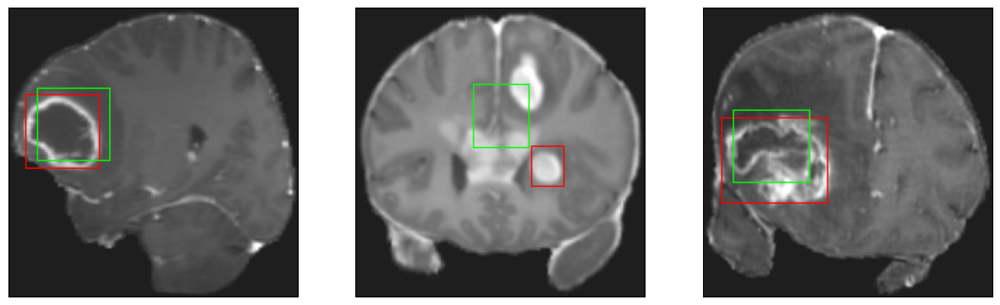

26/26 [==============================] - 2s 91ms/step - loss: 4.0274 - IoU: 0.6593 - val_loss: 12.9028 - val_IoU: 0.3342
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 3.8255 - IoU: 0.6683
Epoch 163: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


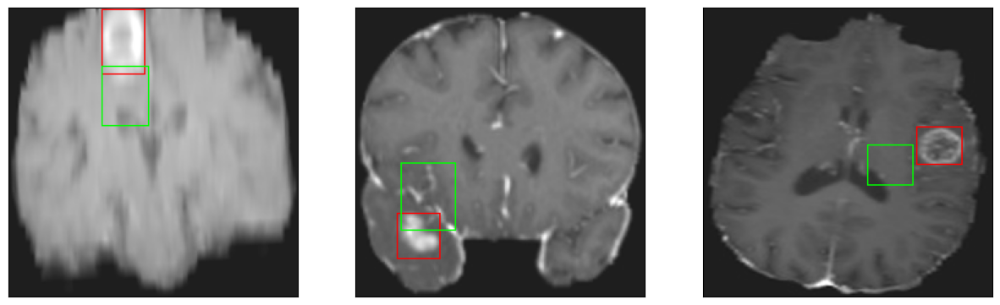

26/26 [==============================] - 2s 90ms/step - loss: 3.8255 - IoU: 0.6683 - val_loss: 11.8959 - val_IoU: 0.3751
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 3.9183 - IoU: 0.6600
Epoch 164: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


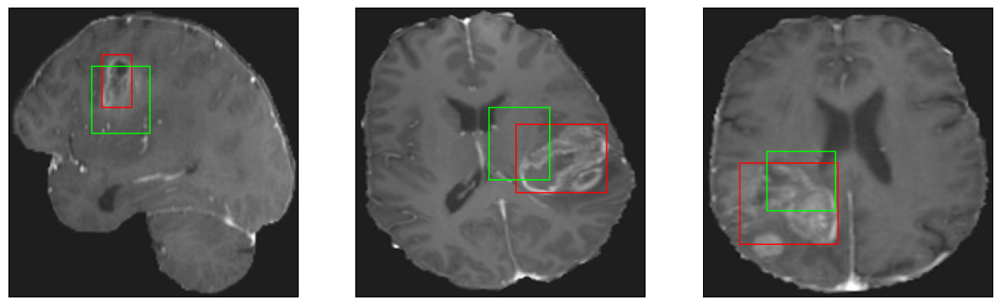

26/26 [==============================] - 3s 103ms/step - loss: 3.9183 - IoU: 0.6600 - val_loss: 15.5749 - val_IoU: 0.2832
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7701 - IoU: 0.6773
Epoch 165: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


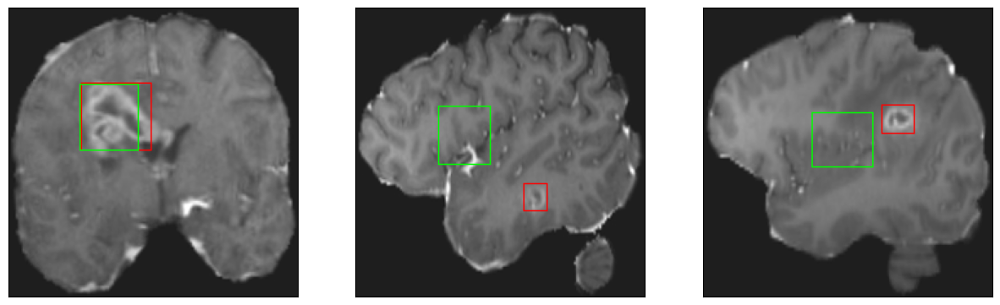

26/26 [==============================] - 3s 117ms/step - loss: 3.7802 - IoU: 0.6749 - val_loss: 12.2286 - val_IoU: 0.3619
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 3.9985 - IoU: 0.6596
Epoch 166: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


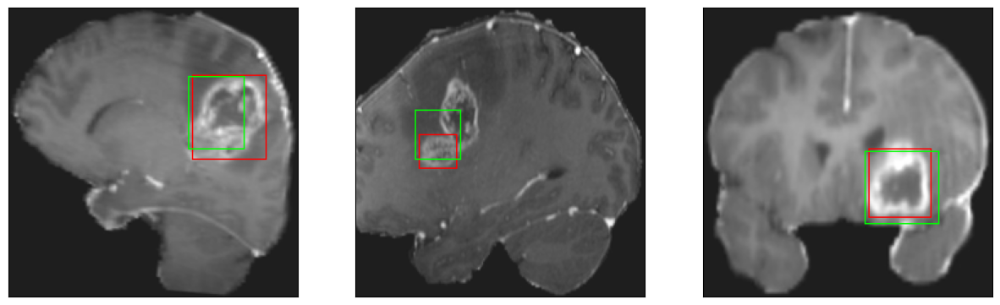

26/26 [==============================] - 3s 111ms/step - loss: 3.9985 - IoU: 0.6596 - val_loss: 11.7868 - val_IoU: 0.3785
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 3.8270 - IoU: 0.6695
Epoch 167: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


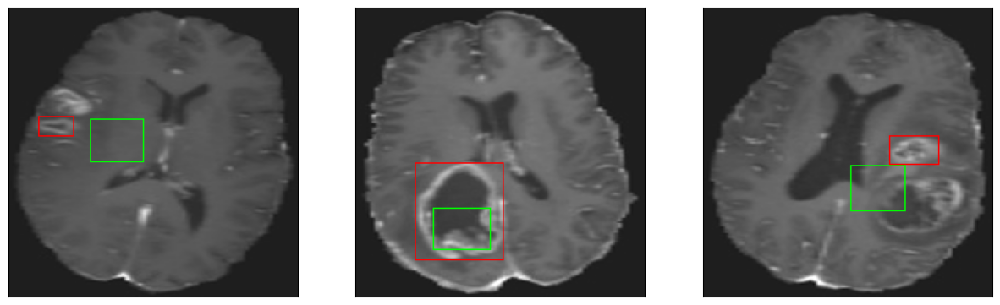

26/26 [==============================] - 3s 101ms/step - loss: 3.8270 - IoU: 0.6695 - val_loss: 11.7064 - val_IoU: 0.3718
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 3.9941 - IoU: 0.6584
Epoch 168: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


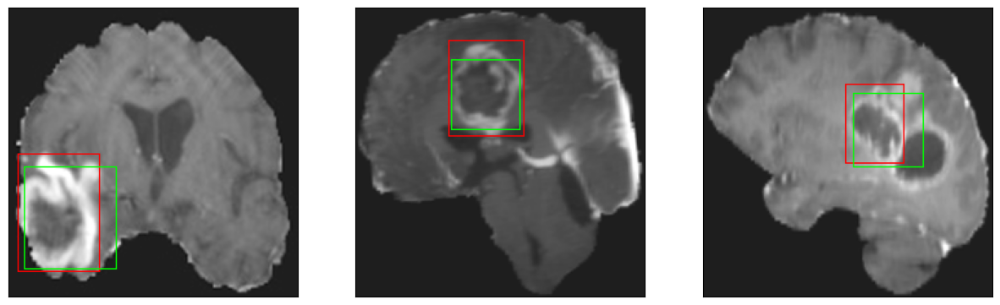

26/26 [==============================] - 3s 109ms/step - loss: 3.9941 - IoU: 0.6584 - val_loss: 12.5631 - val_IoU: 0.3517
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 3.7767 - IoU: 0.6793
Epoch 169: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


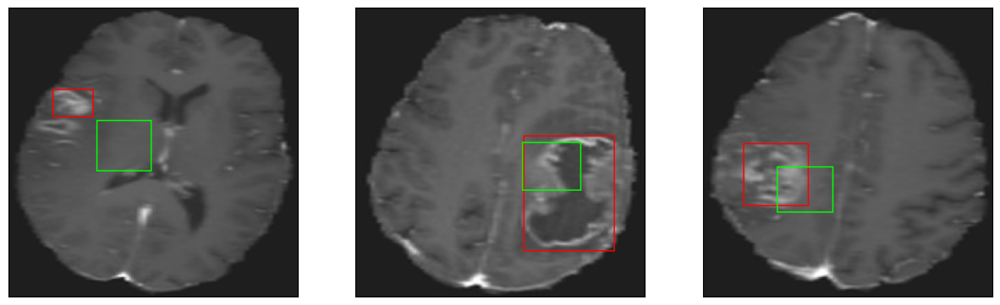

26/26 [==============================] - 3s 98ms/step - loss: 3.7767 - IoU: 0.6793 - val_loss: 11.7368 - val_IoU: 0.3840
Epoch 170/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7417 - IoU: 0.6753
Epoch 170: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


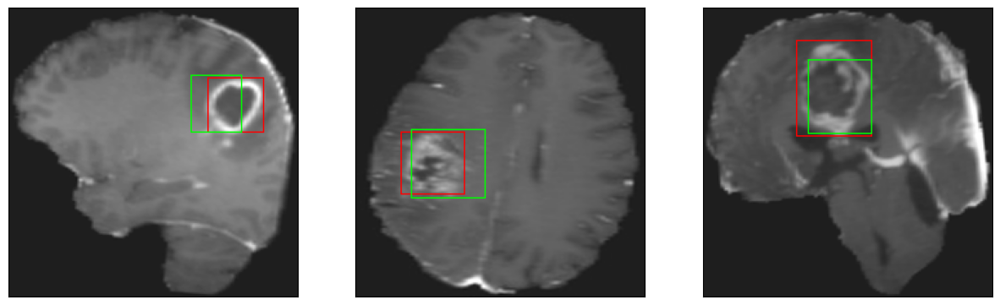

26/26 [==============================] - 3s 114ms/step - loss: 3.7309 - IoU: 0.6754 - val_loss: 11.7906 - val_IoU: 0.3848
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 3.7974 - IoU: 0.6759
Epoch 171: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


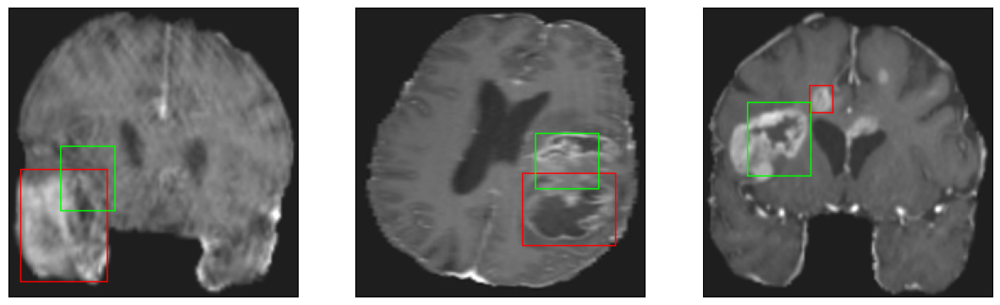

26/26 [==============================] - 3s 108ms/step - loss: 3.7974 - IoU: 0.6759 - val_loss: 11.8580 - val_IoU: 0.3816
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 3.8139 - IoU: 0.6770
Epoch 172: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


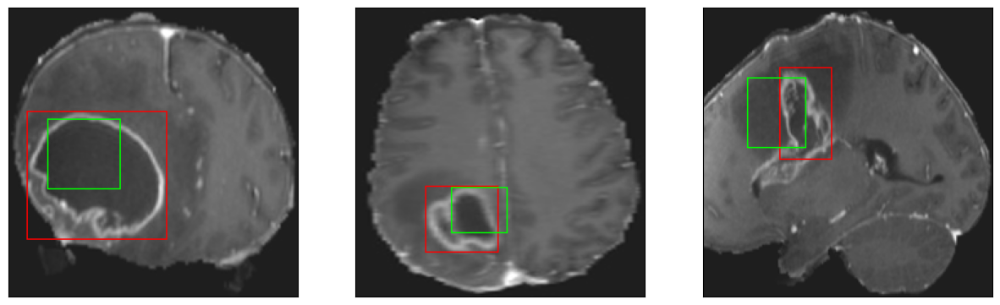

26/26 [==============================] - 2s 93ms/step - loss: 3.8139 - IoU: 0.6770 - val_loss: 11.9974 - val_IoU: 0.3863
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0291 - IoU: 0.6658
Epoch 173: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


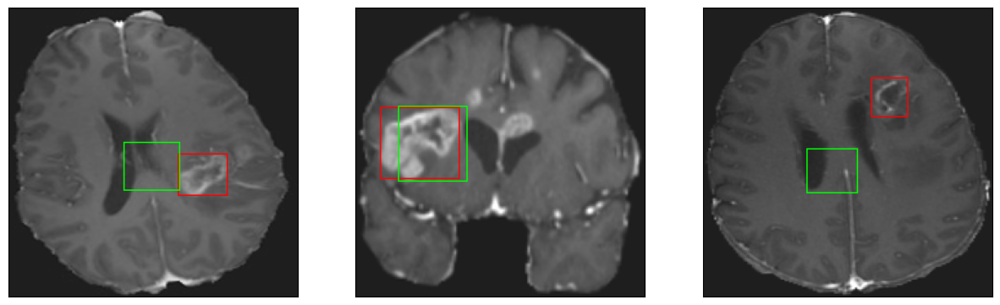

26/26 [==============================] - 2s 85ms/step - loss: 4.0178 - IoU: 0.6661 - val_loss: 12.4308 - val_IoU: 0.3655
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8916 - IoU: 0.6672
Epoch 174: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


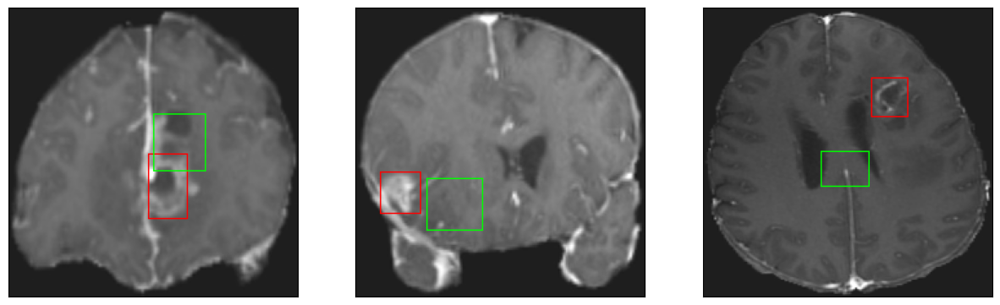

26/26 [==============================] - 3s 102ms/step - loss: 3.8632 - IoU: 0.6679 - val_loss: 12.0815 - val_IoU: 0.3681
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8192 - IoU: 0.6712
Epoch 175: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


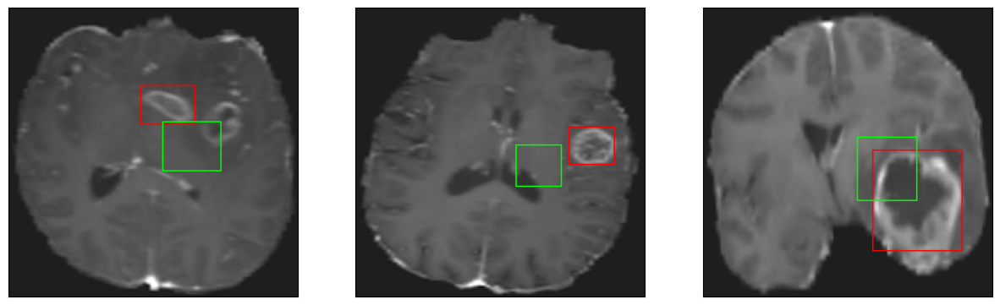

26/26 [==============================] - 3s 120ms/step - loss: 3.8440 - IoU: 0.6707 - val_loss: 11.7809 - val_IoU: 0.3722
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.0595 - IoU: 0.6529
Epoch 176: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


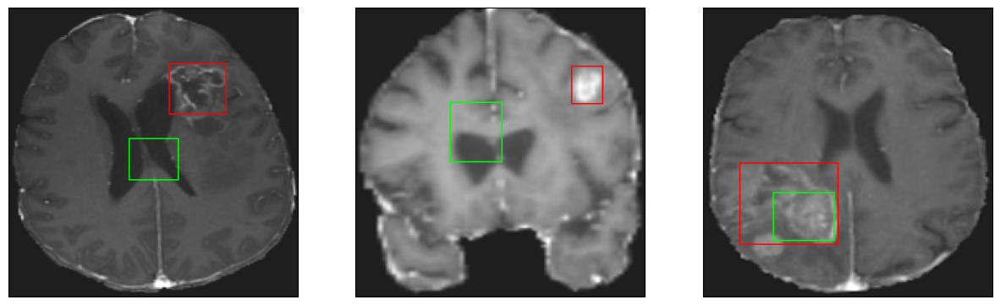

26/26 [==============================] - 3s 96ms/step - loss: 4.0595 - IoU: 0.6529 - val_loss: 11.6600 - val_IoU: 0.3829
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 3.9669 - IoU: 0.6677
Epoch 177: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


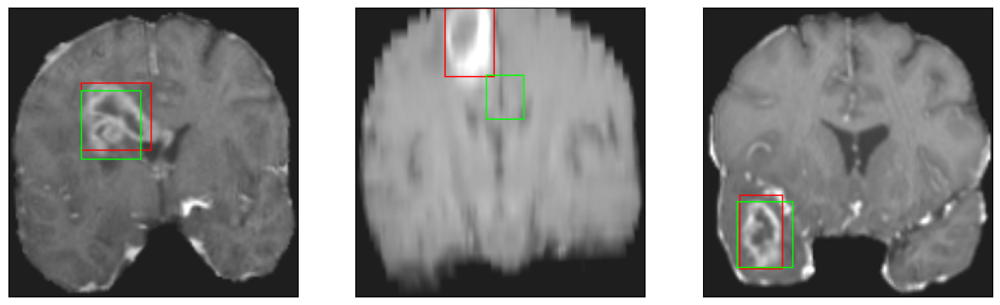

26/26 [==============================] - 3s 106ms/step - loss: 3.9669 - IoU: 0.6677 - val_loss: 12.1056 - val_IoU: 0.3655
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7826 - IoU: 0.6736
Epoch 178: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


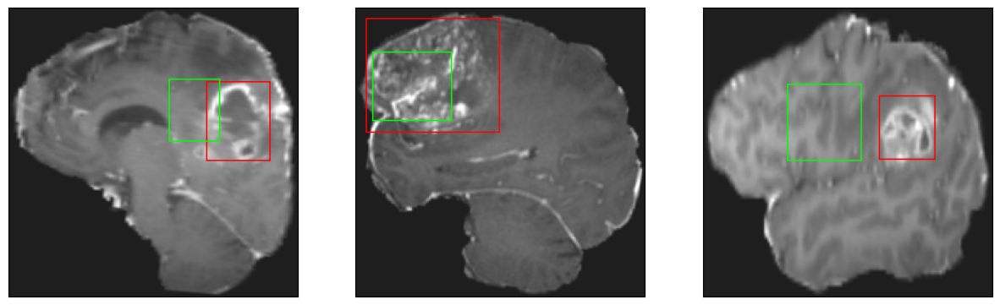

26/26 [==============================] - 3s 103ms/step - loss: 3.7609 - IoU: 0.6748 - val_loss: 11.8823 - val_IoU: 0.3714
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8298 - IoU: 0.6678
Epoch 179: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


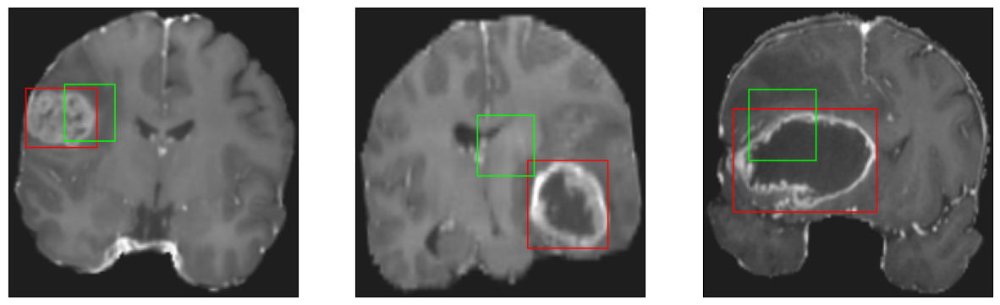

26/26 [==============================] - 3s 135ms/step - loss: 3.8408 - IoU: 0.6675 - val_loss: 14.2809 - val_IoU: 0.2896
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 3.7283 - IoU: 0.6812
Epoch 180: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


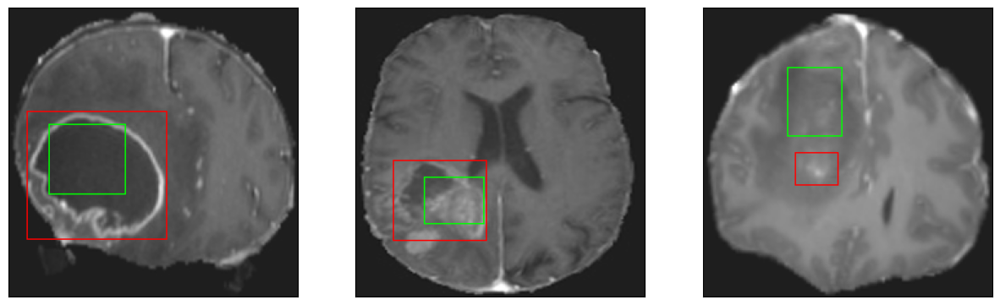

26/26 [==============================] - 3s 105ms/step - loss: 3.7283 - IoU: 0.6812 - val_loss: 12.6763 - val_IoU: 0.3603
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 3.7675 - IoU: 0.6774
Epoch 181: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


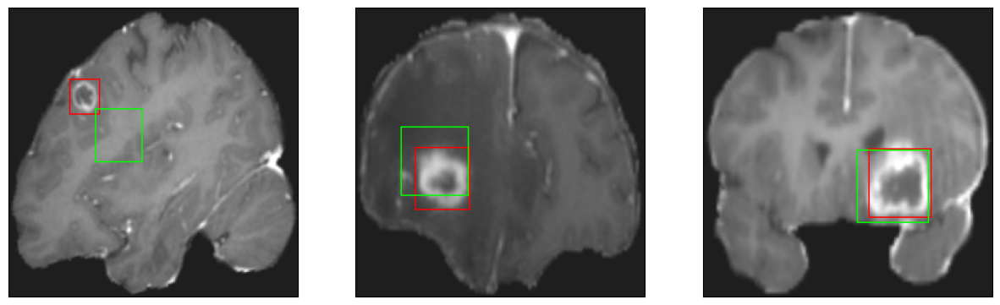

26/26 [==============================] - 3s 98ms/step - loss: 3.7675 - IoU: 0.6774 - val_loss: 11.9629 - val_IoU: 0.3728
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 3.7501 - IoU: 0.6790
Epoch 182: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


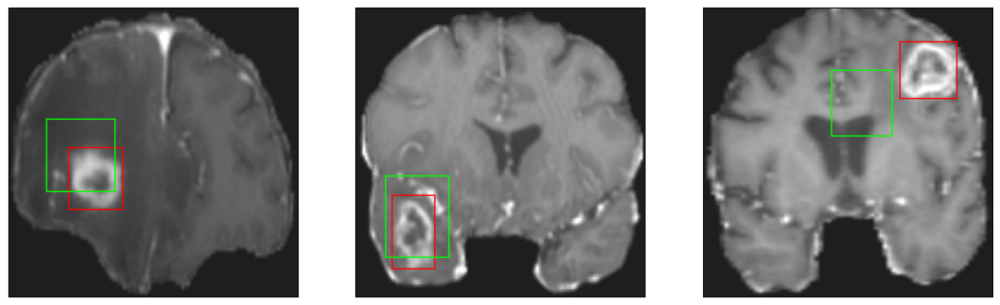

26/26 [==============================] - 2s 96ms/step - loss: 3.7501 - IoU: 0.6790 - val_loss: 12.6920 - val_IoU: 0.3630
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7567 - IoU: 0.6789
Epoch 183: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


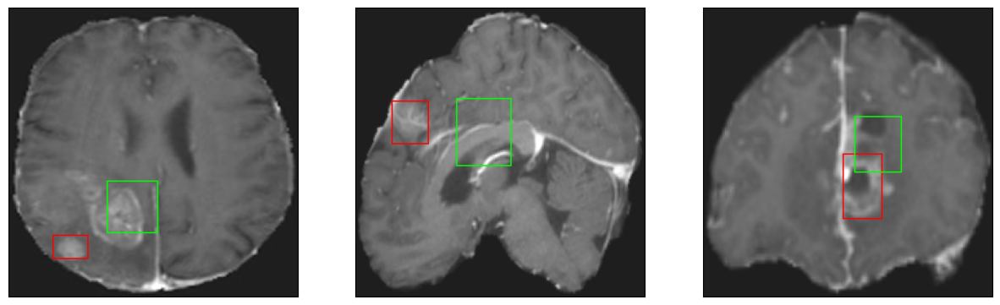

26/26 [==============================] - 3s 115ms/step - loss: 3.7265 - IoU: 0.6798 - val_loss: 12.1243 - val_IoU: 0.3679
Epoch 184/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8030 - IoU: 0.6717
Epoch 184: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


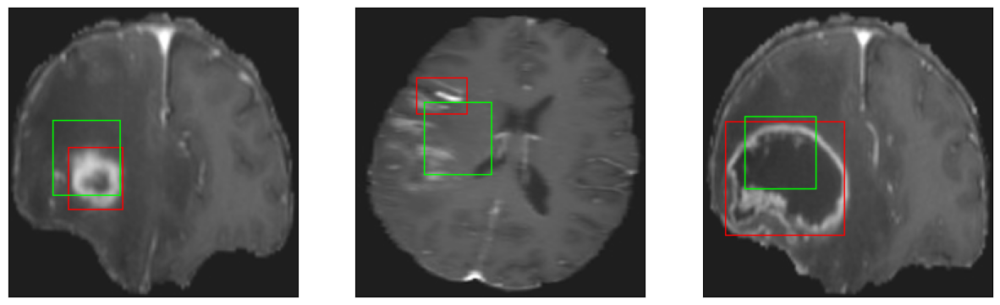

26/26 [==============================] - 3s 104ms/step - loss: 3.7872 - IoU: 0.6724 - val_loss: 12.5229 - val_IoU: 0.3646
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 3.7721 - IoU: 0.6792
Epoch 185: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


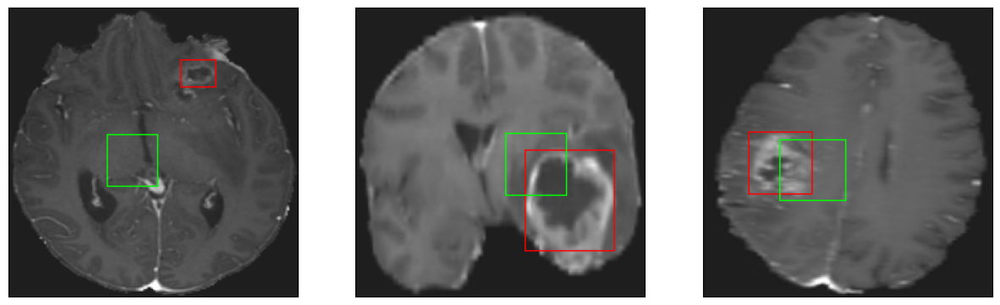

26/26 [==============================] - 3s 100ms/step - loss: 3.7721 - IoU: 0.6792 - val_loss: 12.1787 - val_IoU: 0.3673
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7361 - IoU: 0.6799
Epoch 186: val_loss did not improve from 11.60216
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


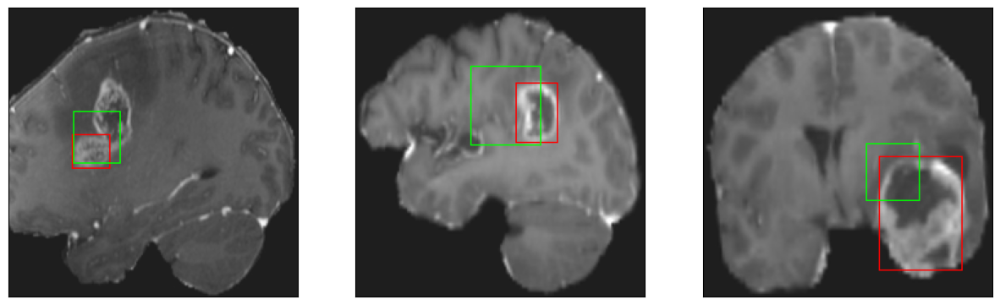

26/26 [==============================] - 3s 124ms/step - loss: 3.8282 - IoU: 0.6778 - val_loss: 12.0189 - val_IoU: 0.3726
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8106 - IoU: 0.6699
Epoch 187: val_loss improved from 11.60216 to 11.50938, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


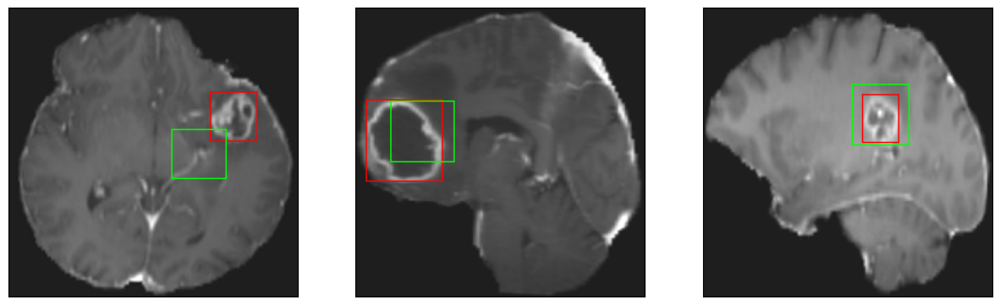

26/26 [==============================] - 4s 156ms/step - loss: 3.8207 - IoU: 0.6713 - val_loss: 11.5094 - val_IoU: 0.4005
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8756 - IoU: 0.6751
Epoch 188: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


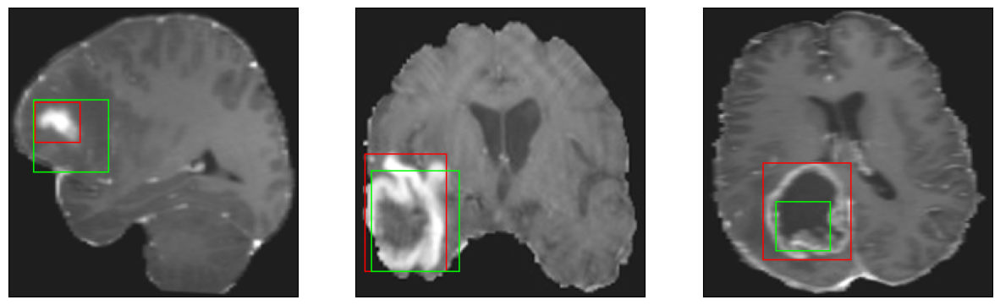

26/26 [==============================] - 3s 104ms/step - loss: 3.8496 - IoU: 0.6771 - val_loss: 11.7467 - val_IoU: 0.3862
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7974 - IoU: 0.6748
Epoch 189: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4


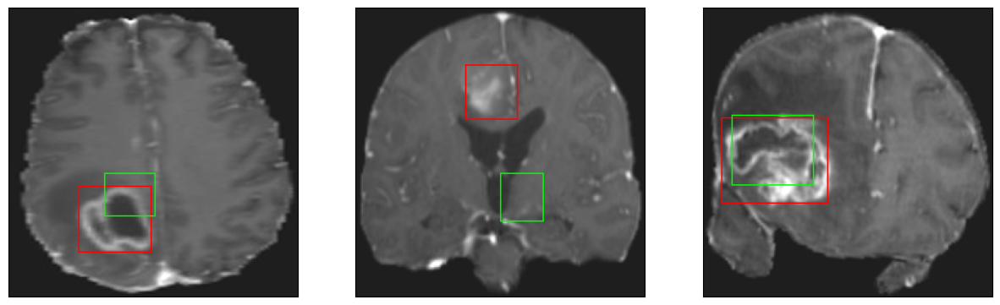

26/26 [==============================] - 3s 119ms/step - loss: 3.7813 - IoU: 0.6746 - val_loss: 12.4229 - val_IoU: 0.3523
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 3.6997 - IoU: 0.6817
Epoch 190: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


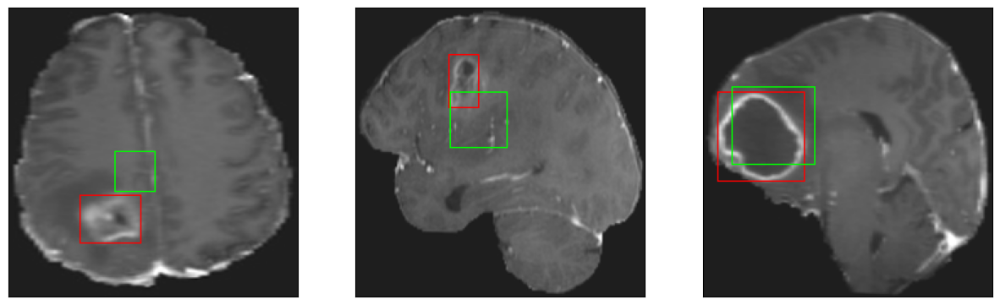

26/26 [==============================] - 3s 110ms/step - loss: 3.6997 - IoU: 0.6817 - val_loss: 12.0988 - val_IoU: 0.3655
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7769 - IoU: 0.6753
Epoch 191: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


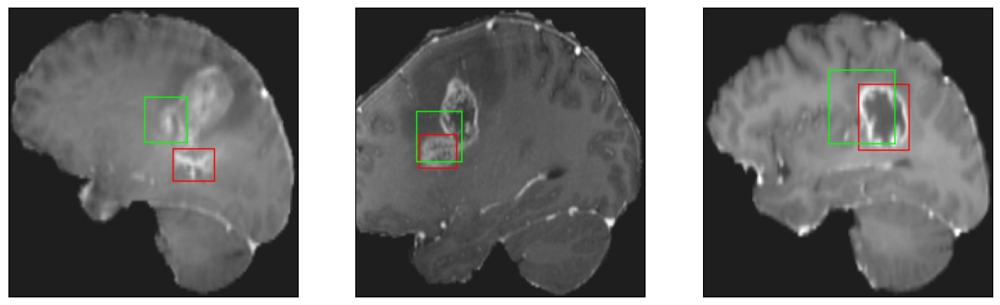

26/26 [==============================] - 3s 102ms/step - loss: 3.7530 - IoU: 0.6761 - val_loss: 11.9779 - val_IoU: 0.3708
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7424 - IoU: 0.6741
Epoch 192: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


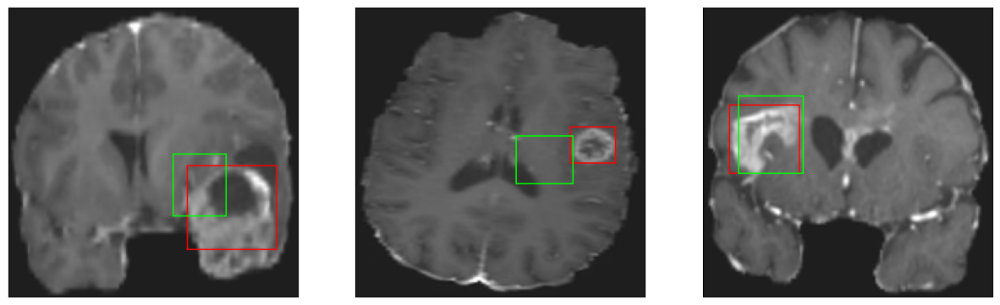

26/26 [==============================] - 2s 95ms/step - loss: 3.7259 - IoU: 0.6760 - val_loss: 11.6897 - val_IoU: 0.3909
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7406 - IoU: 0.6752
Epoch 193: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


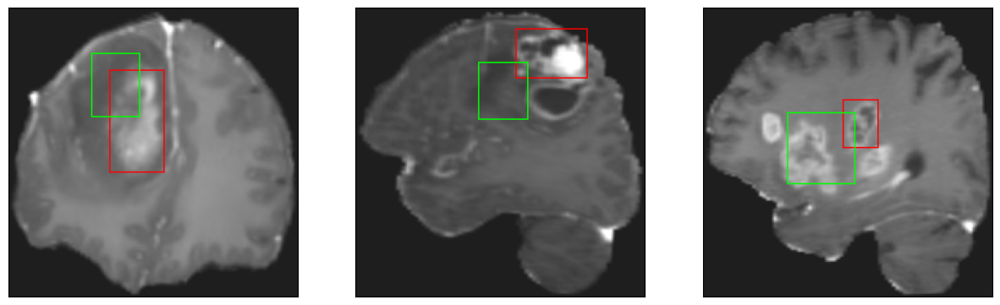

26/26 [==============================] - 3s 112ms/step - loss: 3.7269 - IoU: 0.6760 - val_loss: 11.6099 - val_IoU: 0.3774
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 3.7007 - IoU: 0.6816
Epoch 194: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


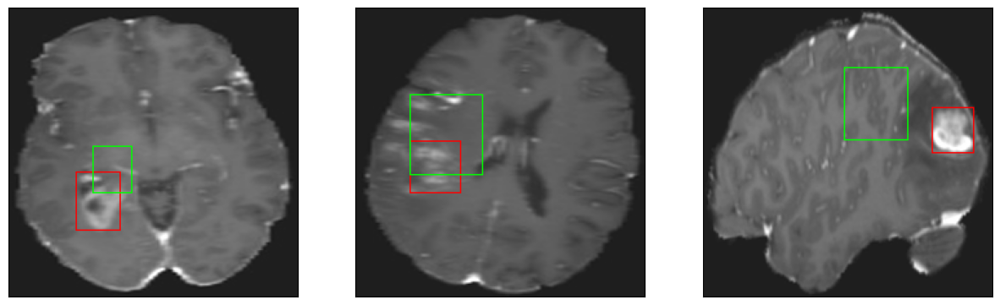

26/26 [==============================] - 3s 128ms/step - loss: 3.7007 - IoU: 0.6816 - val_loss: 12.8127 - val_IoU: 0.3388
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 3.7379 - IoU: 0.6798
Epoch 195: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


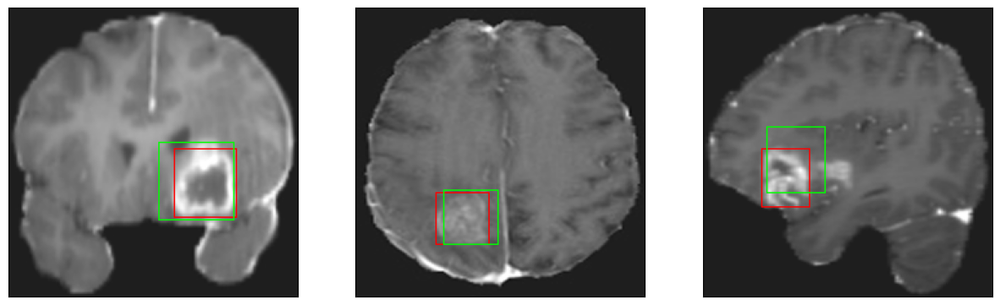

26/26 [==============================] - 3s 100ms/step - loss: 3.7379 - IoU: 0.6798 - val_loss: 12.2608 - val_IoU: 0.3797
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9675 - IoU: 0.6677
Epoch 196: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


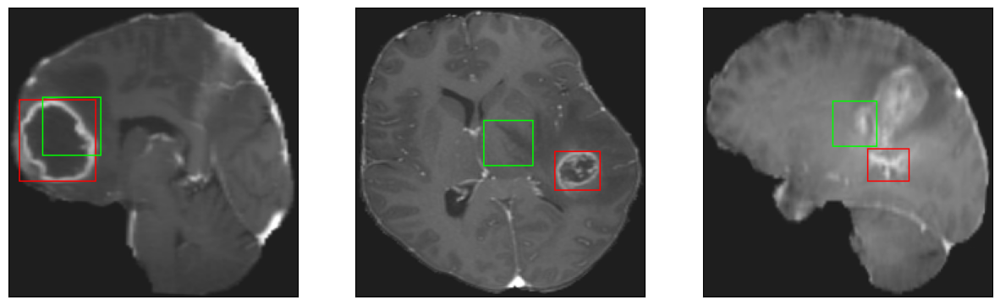

26/26 [==============================] - 3s 104ms/step - loss: 3.9354 - IoU: 0.6698 - val_loss: 11.7429 - val_IoU: 0.3813
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 3.6305 - IoU: 0.6845
Epoch 197: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


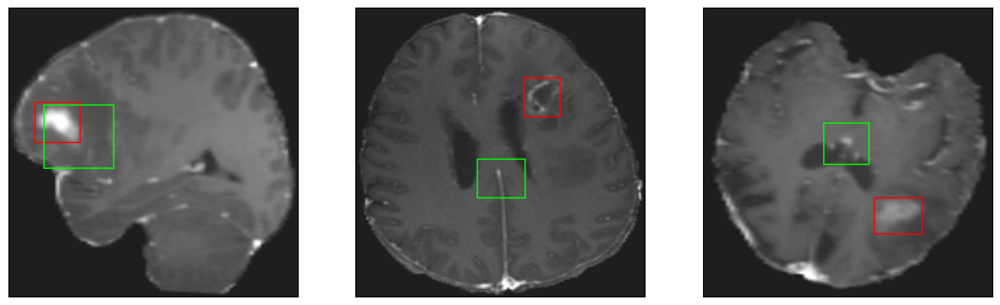

26/26 [==============================] - 3s 112ms/step - loss: 3.6305 - IoU: 0.6845 - val_loss: 11.8670 - val_IoU: 0.3654
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 3.7737 - IoU: 0.6781
Epoch 198: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


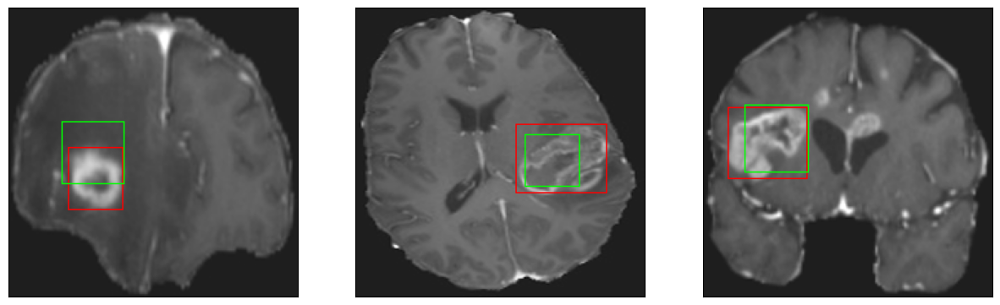

26/26 [==============================] - 3s 103ms/step - loss: 3.7737 - IoU: 0.6781 - val_loss: 12.0841 - val_IoU: 0.3714
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8408 - IoU: 0.6721
Epoch 199: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


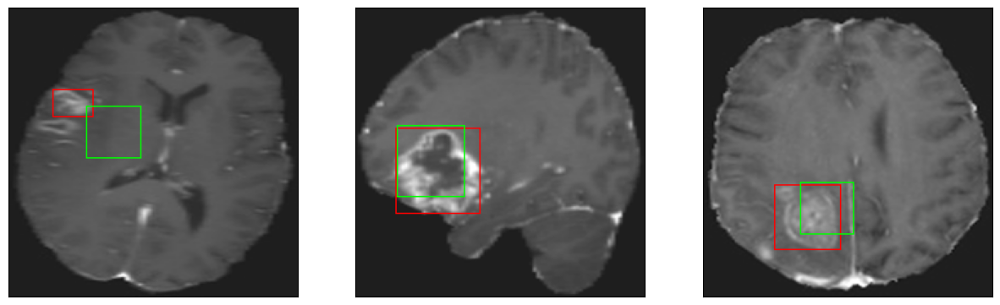

26/26 [==============================] - 3s 98ms/step - loss: 3.8408 - IoU: 0.6708 - val_loss: 12.6668 - val_IoU: 0.3396
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9717 - IoU: 0.6677
Epoch 200: val_loss did not improve from 11.50938
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


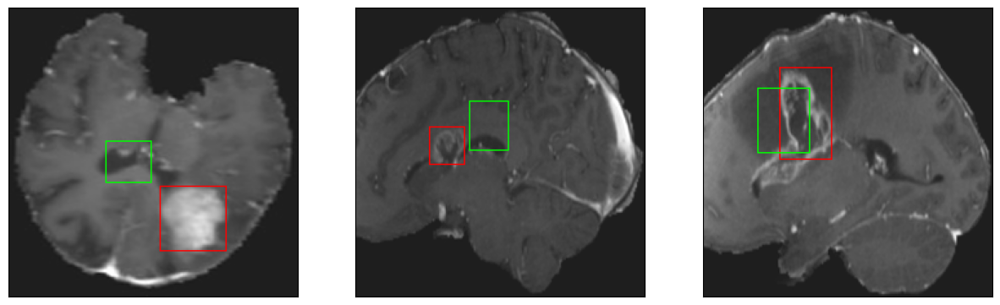

26/26 [==============================] - 2s 93ms/step - loss: 4.0144 - IoU: 0.6642 - val_loss: 11.8789 - val_IoU: 0.3797


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

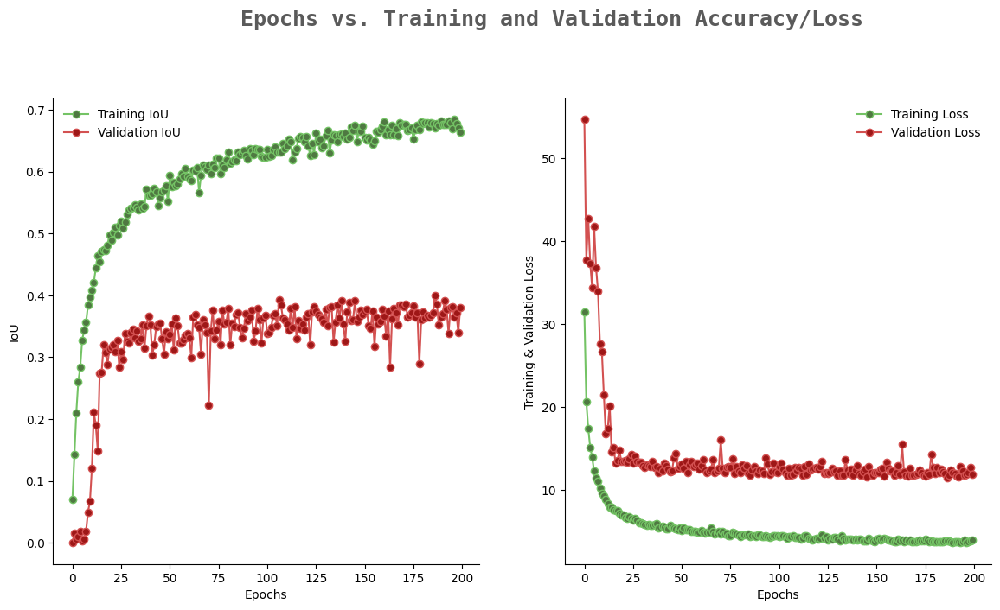

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 29ms/step - loss: 16.1635 - IoU: 0.2404


[16.16351318359375, 0.24042436480522156]